dataset

In [ ]:
# https://medium.com/red-buffer/training-an-object-detection-model-in-a-few-minutes-using-detectron2-5bd0aa5550d4

In [ ]:
#zipfile.ZipFile('/content/drive/MyDrive/DeepFashion2 Dataset/validation.zip').extractall('/tmp/DeepFashion2',pwd=b'2019Deepfashion2**')

In [ ]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html

In [ ]:
!unzip -P "2019Deepfashion2**" /content/DeepFashion2/validation.zip -d /content/DeepFashion2/

In [ ]:
#!mkdir /content/DeepFashion2/
!cp /content/drive/MyDrive/deepfashion2/validation.zip /content/DeepFashion2/

Import packages

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 16.6 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44089 sha256=feed57dc9bee1317d610b35c9eed4a50e9fd3409cdceee41c9d4caedf7945e8b
  Stored in directory: /root/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Cloning into 'detectron2'...
remote: Enumerating objects: 14641, done.
remote: Counting objects: 100% (57/57), done.
remote: Compressing objects: 

In [ ]:
import torch
torch.__version__
import zipfile
from google.colab import drive
drive.mount('/content/drive')
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import os
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

Mounted at /content/drive


In [ ]:
modaimage = os.listdir('/content/drive/MyDrive/modanet/datasets/coco/images') # 구글 Drive Input/Output Error 해결용-읽어주니 error 안남

In [ ]:
!ls /content/DeepFashion2/validation/image | wc -l
!ls /content/DeepFashion2/validation/annos | wc -l

32153
32153


Instance Register

In [ ]:
from detectron2.data.datasets import register_coco_instances
#register_coco_instances("deepfashion_train", {}, "/content/DeepFashion2/deepfashion2_train.json", "/content/DeepFashion2/train/image")

register_coco_instances("modanet_train", {}, "/content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json", "/content/drive/MyDrive/modanet/datasets/coco/images")
moda_metadata = MetadataCatalog.get("modanet_train")
dataset_dicts = DatasetCatalog.get("modanet_train")

[12/13 09:03:22 d2.data.datasets.coco]: Loading /content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json takes 9.18 seconds.
[12/13 09:03:22 d2.data.datasets.coco]: Loaded 52254 images in COCO format from /content/drive/MyDrive/modanet/datasets/coco/annotations/instances_all.json


Training

In [ ]:
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("modanet_train",)
# cfg.DATASETS.VALIDATION = ()
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.002
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 10000
cfg.SOLVER.STEPS = []
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 320
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13
cfg.TEST.EVAL_PERIOD = 500

os.makedirs('/content/drive/MyDrive/cfg.OUTPUT_DIR', exist_ok=True)

trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[12/10 07:46:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [01:11, 2.47MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/10 07:47:21 d2.engine.train_loop]: Starting training from iteration 0
[12/10 07:47:36 d2.utils.events]:  eta: 1:54:29  iter: 19  total_loss: 3.996  loss_cls: 2.563  loss_box_reg: 0.3556  loss_mask: 0.6925  loss_rpn_cls: 0.2916  loss_rpn_loc: 0.05059  time: 0.6743  data_time: 0.2387  lr: 3.9962e-05  max_mem: 5819M
[12/10 07:47:49 d2.utils.events]:  eta: 1:47:29  iter: 39  total_loss: 2.967  loss_cls: 1.576  loss_box_reg: 0.5112  loss_mask: 0.6894  loss_rpn_cls: 0.1556  loss_rpn_loc: 0.04044  time: 0.6577  data_time: 0.1667  lr: 7.9922e-05  max_mem: 5819M
[12/10 07:48:01 d2.utils.events]:  eta: 1:46:45  iter: 59  total_loss: 2.27  loss_cls: 0.8711  loss_box_reg: 0.6165  loss_mask: 0.6813  loss_rpn_cls: 0.1233  loss_rpn_loc: 0.04412  time: 0.6520  data_time: 0.1466  lr: 0.00011988  max_mem: 5819M
[12/10 07:48:14 d2.utils.events]:  eta: 1:46:15  iter: 79  total_loss: 2.455  loss_cls: 0.8722  loss_box_reg: 0.739  loss_mask: 0.6656  loss_rpn_cls: 0.07831  loss_rpn_loc: 0.03642  time: 0.6

In [ ]:
import os
os.mkdir('/content/drive/MyDrive/LSW')

모델 저장용

In [ ]:
import shutil
shutil.copy('/content/output/model_final.pth', '/content/drive/MyDrive/LSW')
torch.save(trainer.model.state_dict(), os.path.join('/content/drive/MyDrive/LSW', "mymodel.pth"))

TensorBoard

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


ERROR: Failed to launch TensorBoard (exited with 2).
Contents of stderr:
2022-12-10 16:02:42.128795: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
usage: tensorboard [-h] [--helpfull] [--logdir PATH] [--logdir_spec PATH_SPEC]
                   [--host ADDR] [--bind_all] [--port PORT]
                   [--reuse_port BOOL] [--load_fast {false,auto,true}]
                   [--extra_data_server_flags EXTRA_DATA_SERVER_FLAGS]
                   [--grpc_creds_type {local,ssl,ssl_dev}]
                   [--grpc_data_provider PORT] [--purge_orphaned_data BOOL]
                   [--db URI] [--db_import] [--inspect] [--version_tb]
                   [--tag TAG] [--event_file PATH] [--path_prefix PATH]
                   [--window_title TEXT] [--max_reload_threads COUNT]
    

Inference and Evaluation

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow
import os

In [ ]:
import torch
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/LSW/modanet-maskrcnn_1/model_final.pth"

In [ ]:
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/LSW/modanet-maskrcnn_1/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg.DATASETS.TEST = ("modanet_train", )
predictor = DefaultPredictor(cfg)

[12/13 05:31:48 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

In [ ]:
## faster rcnn용 안돌리셔도 됩니다

# from detectron2.utils.visualizer import ColorMode
# im = cv2.imread("/content/golfwear1.jpg")
# outputs = predictor(im)
# # We can use `Visualizer` to draw the predictions on the image.
# v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
# v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
# cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
### 아노락데이터 test


from skimage import io
import cv2
# insert your url
#a = os.listdir('/content/drive/MyDrive/001')

for j in tuples[1000:1005]:
  i_sam = io.imread(j[3])
  if len(i_sam.shape) > 2 and i_sam.shape[2] == 4:
    #slice off the alpha channel
    i_sam = i_sam[:, :, :3]
  i_sam = cv2.resize(i_sam, dsize=(300, 450), interpolation=cv2.INTER_AREA)


  i_rev = io.imread(j[2])
  if len(i_rev.shape) > 2 and i_rev.shape[2] == 4:
    #slice off the alpha channel
    i_rev = i_rev[:, :, :3]
  i_rev = cv2.resize(i_rev, dsize=(300, 450), interpolation=cv2.INTER_AREA)

  out_sam = predictor(i_sam)
  out_rev = predictor(i_rev)
  print(out_sam, out_rev)
  
  v_sam = Visualizer(i_sam[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
      )
  v_rev = Visualizer(i_rev[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
      )
  print(j[3])
  v_sam = v_sam.draw_instance_predictions(out_sam["instances"].to("cpu"))
  print(j[2])
  v_rev = v_rev.draw_instance_predictions(out_rev["instances"].to("cpu"))
  cv2_imshow(v_sam.get_image()[:, :, ::])
  cv2_imshow(v_rev.get_image()[:, :, ::])

  # # crop img
  # from re import I
  # from PIL import Image

  # masks_sam = np.asarray(out_sam["instances"].pred_masks.to("cpu"))
  # masks_rev = np.asarray(out_rev["instances"].pred_masks.to("cpu"))

  # for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
  #   item_mask_sam = masks_sam[j]

  #   segmentation = np.where(item_mask_sam == True)
  #   x_min = int(np.min(segmentation[1]))
  #   x_max = int(np.max(segmentation[1]))
  #   y_min = int(np.min(segmentation[0]))
  #   y_max = int(np.max(segmentation[0]))
  #   print(x_min, y_min,x_max, y_max)

  # for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
  #   item_mask_sam = masks_sam[j]

  #   segmentation = np.where(item_mask_sam == True)
  #   x_min = int(np.min(segmentation[1]))
  #   x_max = int(np.max(segmentation[1]))
  #   y_min = int(np.min(segmentation[0]))
  #   y_max = int(np.max(segmentation[0]))
  #   print(x_min, y_min,x_max, y_max)

  #   cropped = Image.fromarray(i_rev[y_min:y_max, x_min:x_max, :], mode='RGB')

  #   mask_sam = Image.fromarray((item_mask_sam * 255).astype('uint8'))


  #   cropped_mask_sam = mask_sam.crop((x_min, y_min, x_max, y_max))
  #   bg = np.full((450, 300, 3), 255, np.uint8) # 흰색배경
  #   # bg = np.zeros((450, 300, 3), np.uint8) # 검정색 배경
  #   background = Image.fromarray(bg, mode='RGB')
  #   paste_position = (100,150)

  #   new_fg_image = Image.new('RGB', background.size)
  #   new_fg_image.paste(cropped, paste_position)

  #   new_alpha_mask = Image.new("L", background.size, color = 0)
  #   new_alpha_mask.paste(cropped_mask, paste_position)

  #   composite = Image.composite(new_fg_image, background, new_alpha_mask)


  #   composite_array = np.array(composite)
  #   nonzero_composite_array = np.nonzero(composite_array)
  #   np_av = np.average(nonzero_composite_array)
  #   print(np_av)
  

  #   # masks_sam, masks_rev 
  #   # masks_sam의 item_num이 해당 클래스인 것만 저장. cropped img 
  #   # masks_rev의 item_num, url, reviewId, -> 별도 DB 생성. 일단 딕셔너리나 리스트로 뽑아 두기.


  #   cv2_imshow(np.array(composite))
  #   item_num = out['instances'].pred_classes[j].item()
  #   if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
  #     cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
  #   elif item_num == 7 or item_num == 10:
  #     cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
  #   else:
  #     cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
## evaluator

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("modanet_train", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "modanet_train")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

GET DB

In [ ]:
## import db

import pandas as pd
import sqlite3
from urllib.request import urlopen
from urllib.error import URLError, HTTPError

In [ ]:
## 중분류 중 데이터셋이 작은 아노락재킷 test

con = sqlite3.connect("/content/drive/MyDrive/3rd_project/musinsa_2nd_pr_2.db")
sql = "SELECT mid_category, reviewId ,reviewImageUrl, sampleImageUrl FROM 'review_002_002019_아노락재킷';"
cur = con.cursor()
cur.execute(sql)
tuples = cur.fetchall()
con.close()

In [ ]:
for j in tuples[950:1005]:
  print(j)

RANDOM하게 대분류 001/003/005 -> 3000개 TEST

In [ ]:
import sqlite3
con = sqlite3.connect("/content/drive/MyDrive/3rd_project/musinsa_2nd_pr_2.db")
sql = "SELECT * FROM styleReview_merge WHERE major_category LIKE '001' OR major_category LIKE '005' OR major_category LIKE '003'  ORDER BY RANDOM() LIMIT 3000 ";
cur = con.cursor()
cur.execute(sql)
test = cur.fetchall()
con.close()

In [ ]:
## url for문 -- 필요없을듯
db1 = pd.read_sql('SELECT * FROM review_002_002019_아노락재킷',con)
urllist = db1.iloc[:,6]
print(len(urllist))
print(urllist)

In [ ]:
## 아노락== tuple용 OD result check

from skimage import io
import cv2
# insert your url
#a = os.listdir('/content/drive/MyDrive/001')

for j in tuples[:]:
  i_sam = io.imread(j[-1])
 
  if len(i_sam.shape) > 2 and i_sam.shape[2] == 4:
    #slice off the alpha channel
   i_sam = i_sam[:, :, :3]
  i_sam = cv2.resize(i_sam, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  # scalingFactor = 1/255.0
  # i_sam = np.float32(i_sam)
  # i_sam = i_sam*scalingFactor

  i_rev = io.imread(j[3])
  if len(i_rev.shape) > 2 and i_rev.shape[2] == 4:
    #slice off the alpha channel
    i_rev = i_rev[:, :, :3]
  i_rev = cv2.resize(i_rev, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  
  
  out_sam = predictor(i_sam)
  out_rev = predictor(i_rev)
  print(out_sam, out_rev)
  
  v_sam = Visualizer(i_sam[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
      )
  v_rev = Visualizer(i_rev[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
      )
  print(j[3])
  v_sam = v_sam.draw_instance_predictions(out_sam["instances"].to("cpu"))
  print(j[2])
  v_rev = v_rev.draw_instance_predictions(out_rev["instances"].to("cpu"))
  cv2_imshow(v_sam.get_image()[:, :, ::])
  cv2_imshow(v_rev.get_image()[:, :, ::])

  # # crop img
  from re import I
  from PIL import Image

  masks_sam = np.asarray(out_sam["instances"].pred_masks.to("cpu"))
  masks_rev = np.asarray(out_rev["instances"].pred_masks.to("cpu"))

  for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
    item_mask_sam = masks_sam[j]

    segmentation = np.where(item_mask_sam == True)
    x_min = np.min(segmentation[1])
    x_max = np.max(segmentation[1])
    y_min = np.min(segmentation[0])
    y_max = np.max(segmentation[0])
    print(x_min, y_min,x_max, y_max)

  for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
    item_mask_sam = masks_sam[j]

    segmentation = np.where(item_mask_sam == True)
    x_min = np.min(segmentation[1])
    x_max = np.max(segmentation[1])
    y_min = np.min(segmentation[0])
    y_max = np.max(segmentation[0])
    print(x_min, y_min,x_max, y_max)

    cropped = Image.fromarray(i_rev[y_min:y_max, x_min:x_max, :], mode='RGB')

    mask_sam = Image.fromarray((item_mask_sam * 255).astype('float32'))


    # cropped_mask_sam = mask_sam.crop((x_min, y_min, x_max, y_max))
    # bg = np.full((450, 300, 3), 255, np.float32) # 흰색배경
    # # bg = np.zeros((450, 300, 3), np.float32) # 검정색 배경
    # background = Image.fromarray(bg, mode='RGB')
    # paste_position = (100,150)

    # new_fg_image = Image.new('RGB', background.size)
    # new_fg_image.paste(cropped, paste_position)

    # new_alpha_mask = Image.new("L", background.size, color = 0)
    # new_alpha_mask.paste(cropped_mask_sam, paste_position)

    # composite = Image.composite(new_fg_image, background, new_alpha_mask)


    # composite_array = np.array(composite)
    # nonzero_composite_array = np.nonzero(composite_array)
    # np_av = np.average(nonzero_composite_array)
    # print(np_av)
  

    # masks_sam, masks_rev 
    # masks_sam의 item_num이 해당 클래스인 것만 저장. cropped img 
    # masks_rev의 item_num, url, reviewId, -> 별도 DB 생성. 일단 딕셔너리나 리스트로 뽑아 두기.


    # cv2_imshow(np.array(composite))
    # item_num = out_sam['instances'].pred_classes[j].item()
    # if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
    #   cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
    # elif item_num == 7 or item_num == 10:
    #   cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
    # else:
    #   cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

In [ ]:
## 위에거랑 같은데 코드 바꾸는 거 테스트용 안돌리셔도 됩니다

from skimage import io
import cv2
# insert your url
#a = os.listdir('/content/drive/MyDrive/001')

for j in tuples[:]:
  # i_sam = io.imread(j[-1])
 
  # if len(i_sam.shape) > 2 and i_sam.shape[2] == 4:
  #   #slice off the alpha channel
  #  i_sam = i_sam[:, :, :3]
  # i_sam = cv2.resize(i_sam, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  # # scalingFactor = 1/255.0
  # # i_sam = np.float32(i_sam)
  # # i_sam = i_sam*scalingFactor

  i_rev = io.imread(j[3])
  if len(i_rev.shape) > 2 and i_rev.shape[2] == 4:
    #slice off the alpha channel
    i_rev = i_rev[:, :, :3]
  i_rev = cv2.resize(i_rev, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  
  
  # out_sam = predictor(i_sam)
  out_rev = predictor(i_rev)
 # print(out_rev)
  
  # v_sam = Visualizer(i_sam[:, :, ::-1],
  #                 metadata=moda_metadata, 
  #                 scale=0.8
  #                 # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
  #     )
  v_rev = Visualizer(i_rev[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
      )
  print(j[3])
  #v_sam = v_sam.draw_instance_predictions(out_sam["instances"].to("cpu"))
  print(j[2])
  v_rev = v_rev.draw_instance_predictions(out_rev["instances"].to("cpu"))
 # cv2_imshow(v_sam.get_image()[:, :, ::])
  cv2_imshow(v_rev.get_image()[:, :, ::])

  # # crop img
  from re import I
  from PIL import Image

  #masks_sam = np.asarray(out_sam["instances"].pred_masks.to("gpu"))
  masks_rev = np.asarray(out_rev["instances"].pred_masks.to("cpu"))

  for j in range(masks_rev.shape[0]): # 마스크 수만큼 돌아가나 보군군
    item_mask_rev = masks_rev[j]

    segmentation = np.where(item_mask_rev == True)
    x_min = np.min(segmentation[1])
    x_max = np.max(segmentation[1])
    y_min = np.min(segmentation[0])
    y_max = np.max(segmentation[0])
    print(x_min, y_min,x_max, y_max)

  # for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
  #   item_mask_sam = masks_sam[j]

  #   segmentation = np.where(item_mask_sam == True)
  #   x_min = np.min(segmentation[1])
  #   x_max = np.max(segmentation[1])
  #   y_min = np.min(segmentation[0])
  #   y_max = np.max(segmentation[0])
  #   print(x_min, y_min,x_max, y_max)

    cropped = Image.fromarray(i_rev[y_min:y_max, x_min:x_max, :], mode='RGB')

    mask_rev = Image.fromarray((item_mask_rev * 255).astype('float32'))


    # cropped_mask_sam = mask_sam.crop((x_min, y_min, x_max, y_max))
    # bg = np.full((450, 300, 3), 255, np.float32) # 흰색배경
    # # bg = np.zeros((450, 300, 3), np.float32) # 검정색 배경
    # background = Image.fromarray(bg, mode='RGB')
    # paste_position = (100,150)

    # new_fg_image = Image.new('RGB', background.size)
    # new_fg_image.paste(cropped, paste_position)

    # new_alpha_mask = Image.new("L", background.size, color = 0)
    # new_alpha_mask.paste(cropped_mask_sam, paste_position)

    # composite = Image.composite(new_fg_image, background, new_alpha_mask)


    # composite_array = np.array(composite)
    # nonzero_composite_array = np.nonzero(composite_array)
    # np_av = np.average(nonzero_composite_array)
    # print(np_av)
  

    # masks_sam, masks_rev 
    # masks_sam의 item_num이 해당 클래스인 것만 저장. cropped img 
    # masks_rev의 item_num, url, reviewId, -> 별도 DB 생성. 일단 딕셔너리나 리스트로 뽑아 두기.


    # cv2_imshow(np.array(composite))
    # item_num = out_sam['instances'].pred_classes[j].item()
    # if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
    #   cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
    # elif item_num == 7 or item_num == 10:
    #   cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
    # else:
    #   cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

In [ ]:
os.mkdir('/content/drive/MyDrive/cropped_test')

('2176899', '36366325', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2176899_0/gallery_638d91df5451a.jpg', '003', '003008', '2176899', 'https://image.msscdn.net/images/goods_img/20211014/2176899/2176899_1_500.jpg')


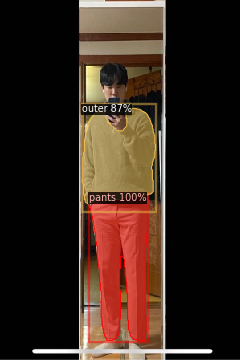

113 242 184 426
103 134 194 254
('2614111', '31255974', '2022.08.11', 'https://image.msscdn.net/data/estimate/2614111_0/gallery_62f47e689eb95.jpg', '001', '001011', '2614111', 'https://image.msscdn.net/images/goods_img/20220614/2614111/2614111_1_500.jpg')


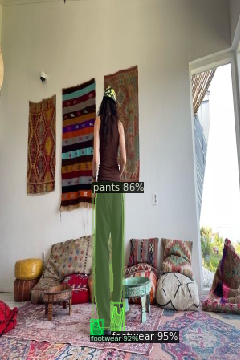

140 383 154 414
114 401 127 419
117 228 153 409
('2723767', '34687041', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2723767_0/gallery_636b1b970a992.jpg', '001', '001006', '2723767', 'https://image.msscdn.net/images/goods_img/20220818/2723767/2723767_8_500.jpg')


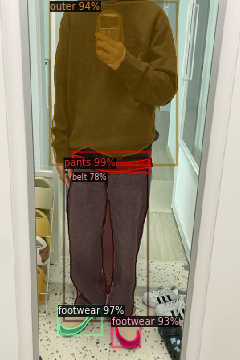

84 200 184 398
74 386 126 418
64 2 220 204
140 396 173 433
91 194 186 214
('1333322', '19929228', '2021.09.20', 'https://image.msscdn.net/data/estimate/1333322_0/gallery_614857447652a.jpg', '003', '003004', '1333322', 'https://image.msscdn.net/images/goods_img/20200304/1333322/1333322_2_500.jpg')


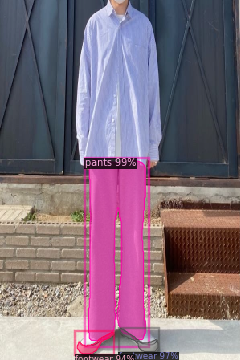

110 199 181 425
149 410 197 439
96 415 141 442
('2760338', '34490373', '2022.11.04', 'https://image.msscdn.net/data/estimate/2760338_0/gallery_6364e6ab650d2.jpg', '003', '003004', '2760338', 'https://image.msscdn.net/images/goods_img/20220831/2760338/2760338_1_500.jpg')


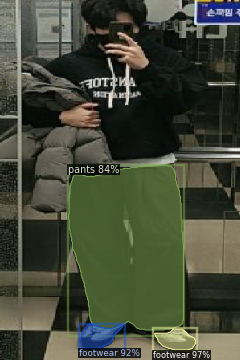

193 411 244 437
100 405 153 435
85 206 229 412
('2482740', '29908887', '2022.06.30', 'https://image.msscdn.net/data/estimate/2482740_0/gallery_62bd268ae1a44.jpg', '003', '003009', '2482740', 'https://image.msscdn.net/images/goods_img/20220412/2482740/2482740_1_500.jpg')


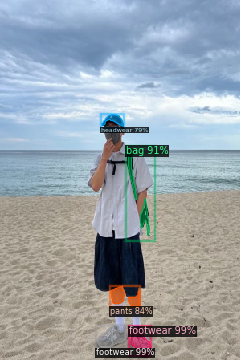

121 406 156 434
163 408 187 444
160 187 186 294
138 358 174 383
127 143 153 157
('1778391', '26736323', '2022.03.29', 'https://image.msscdn.net/data/estimate/1778391_0/gallery_6242c38b93b1f.jpg', '003', '003004', '1778391', 'https://image.msscdn.net/images/goods_img/20210204/1778391/1778391_1_500.jpg')


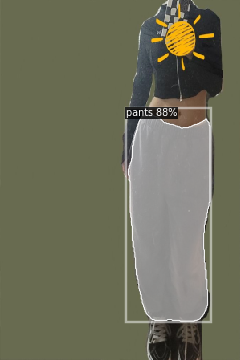

160 143 262 401
('2332833', '33732825', '2022.10.17', 'https://image.msscdn.net/data/estimate/2332833_0/gallery_634d615e71f70.jpg', '003', '003007', '2332833', 'https://image.msscdn.net/images/goods_img/20220127/2332833/2332833_1_500.jpg')


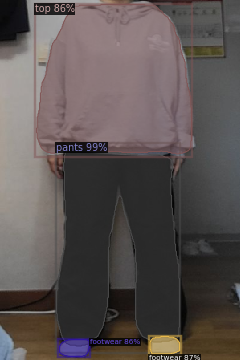

70 185 224 432
187 420 224 442
45 5 239 192
74 424 111 445
('1438728', '18512719', '2021.07.24', 'https://image.msscdn.net/data/estimate/1438728_0/gallery_60fb91a0966f8.jpg', '005', '005004', '1438728', 'https://image.msscdn.net/images/goods_img/20200511/1438728/1438728_2_500.jpg')


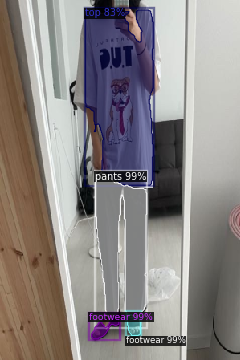

119 215 183 395
114 391 148 423
158 391 175 419
106 12 191 231
('1994358', '29473475', '2022.06.17', 'https://image.msscdn.net/data/estimate/1994358_0/gallery_62ac3998a8fb2.jpg', '001', '001001', '1994358', 'https://image.msscdn.net/images/goods_img/20210614/1994358/1994358_1_500.jpg')


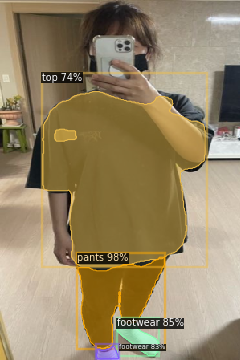

97 321 205 435
146 399 198 444
120 432 148 448
53 114 256 332
('2680807', '33362973', '2022.10.09', 'https://image.msscdn.net/data/estimate/2680807_0/gallery_63428706d8a0d.jpg', '001', '001006', '2680807', 'https://image.msscdn.net/images/goods_img/20220725/2680807/2680807_2_500.jpg')


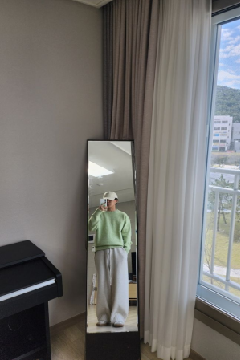

('1571486', '15135740', '2021.02.21', 'https://image.msscdn.net/data/estimate/1571486_0/gallery_6032310d9c459.jpg', '001', '001004', '1571486', 'https://image.msscdn.net/images/goods_img/20200831/1571486/1571486_8_500.jpg')


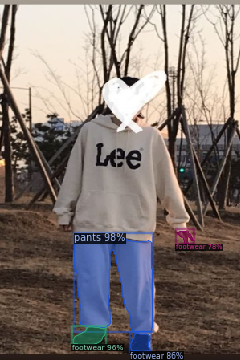

93 293 190 414
91 408 131 430
163 416 187 439
221 288 241 304
('2771238', '35206048', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2771238_0/gallery_6376c7ff52d4f.jpg', '003', '003006', '2771238', 'https://image.msscdn.net/images/goods_img/20220905/2771238/2771238_1_500.jpg')


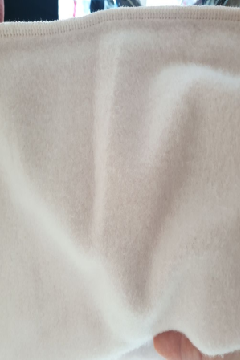

('2064577', '33938389', '2022.10.22', 'https://image.msscdn.net/data/estimate/2064577_0/gallery_6353419f9488a.jpg', '001', '001005', '2064577', 'https://image.msscdn.net/images/goods_img/20210813/2064577/2064577_1_500.jpg')


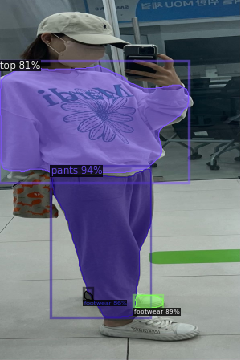

65 211 188 396
169 369 203 385
105 363 116 375
0 81 235 216
('1753986', '16626507', '2021.05.06', 'https://image.msscdn.net/data/estimate/1753986_0/gallery_609363b2a2161.jpg', '003', '003007', '1753986', 'https://image.msscdn.net/images/goods_img/20210119/1753986/1753986_4_500.jpg')


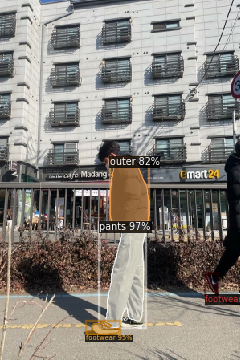

131 281 181 409
108 401 148 418
257 341 271 368
137 196 186 284
('1812133', '20616040', '2021.10.13', 'https://image.msscdn.net/data/estimate/1812133_0/gallery_616617d7b33a1.jpg', '003', '003008', '1812133', 'https://image.msscdn.net/images/goods_img/20210224/1812133/1812133_1_500.jpg')


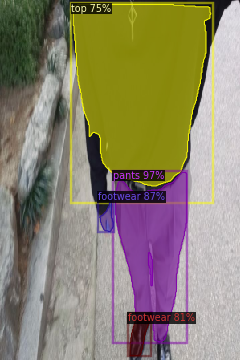

144 215 233 427
124 245 141 289
162 392 187 444
91 5 263 232
('2581397', '34888613', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2581397_0/gallery_6371897516715.jpg', '001', '001011', '2581397', 'https://image.msscdn.net/images/goods_img/20220525/2581397/2581397_1_500.jpg')


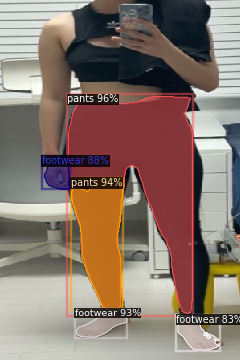

85 120 240 391
89 223 153 387
95 386 158 421
53 196 87 236
222 394 273 437
('1867554', '30147292', '2022.07.07', 'https://image.msscdn.net/data/estimate/1867554_0/gallery_62c637199054e.jpg', '003', '003002', '1867554', 'https://image.msscdn.net/images/goods_img/20210329/1867554/1867554_1_500.jpg')


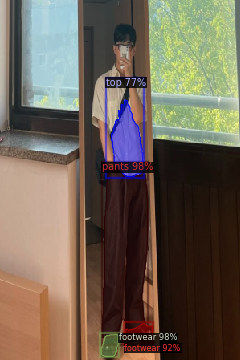

126 417 147 445
128 209 184 422
156 404 190 429
139 124 178 220
('2404955', '27097563', '2022.04.09', 'https://image.msscdn.net/data/estimate/2404955_0/gallery_6251498e45fe6.jpg', '001', '001001', '2404955', 'https://image.msscdn.net/images/goods_img/20220308/2404955/2404955_1_500.jpg')


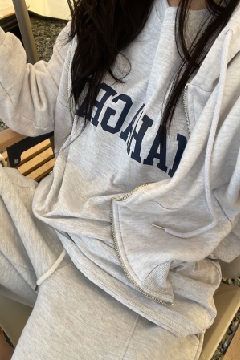

('1749098', '15176430', '2021.02.23', 'https://image.msscdn.net/data/estimate/1749098_0/gallery_6034ead184e7b.jpg', '003', '003002', '1749098', 'https://image.msscdn.net/images/goods_img/20210114/1749098/1749098_2_500.jpg')


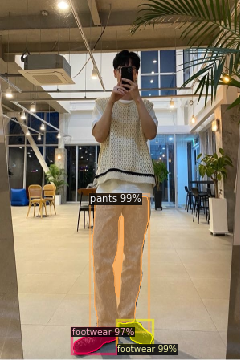

147 402 190 430
115 242 185 414
92 410 146 441
('1887256', '18150496', '2021.07.09', 'https://image.msscdn.net/data/estimate/1887256_0/gallery_60e7ef43e86b6.jpg', '003', '003007', '1887256', 'https://image.msscdn.net/images/goods_img/20210408/1887256/1887256_1_500.jpg')


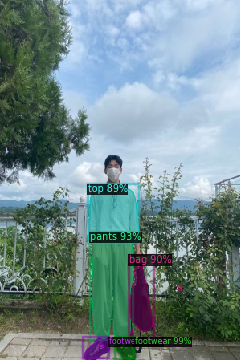

105 422 135 447
144 423 167 448
115 291 165 423
162 327 190 422
110 231 173 302
('2541132', '31162567', '2022.08.08', 'https://image.msscdn.net/data/estimate/2541132_0/gallery_62f05ec394049.jpg', '003', '003009', '2541132', 'https://image.msscdn.net/images/goods_img/20220504/2541132/2541132_1_500.jpg')


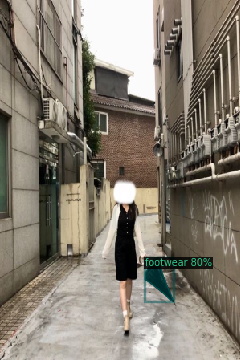

181 323 215 375
('1753542', '28922900', '2022.06.01', 'https://image.msscdn.net/data/estimate/1753542_0/gallery_62970e6918f8a.jpg', '003', '003002', '1753542', 'https://image.msscdn.net/images/goods_img/20210119/1753542/1753542_3_500.jpg')


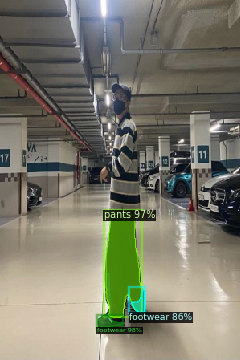

122 393 153 409
132 263 177 396
164 361 180 390
('466299', '6245838', '2019.09.18', 'https://image.msscdn.net/data/estimate/466299_0/gallery_5d810a478e595.jpg', '003', '003002', '466299', 'https://image.msscdn.net/images/goods_img/20161222/466299/466299_10_500.jpg')


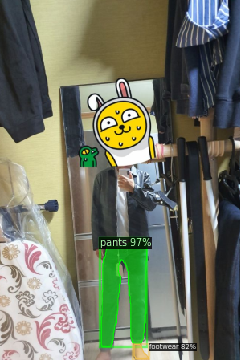

126 299 183 433
167 430 185 448
('2472412', '27989522', '2022.05.05', 'https://image.msscdn.net/data/estimate/2472412_0/gallery_627398df61769.jpg', '001', '001001', '2472412', 'https://image.msscdn.net/images/goods_img/20220407/2472412/2472412_1_500.jpg')


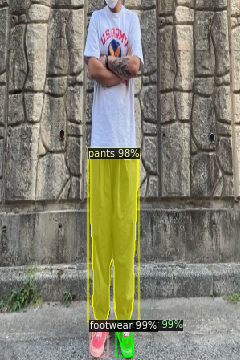

145 401 165 445
113 402 134 445
113 187 172 401
('1446485', '26494320', '2022.03.22', 'https://image.msscdn.net/data/estimate/1446485_0/gallery_6238b01eb97fc.jpg', '001', '001010', '1446485', 'https://image.msscdn.net/images/goods_img/20200514/1446485/1446485_3_500.jpg')


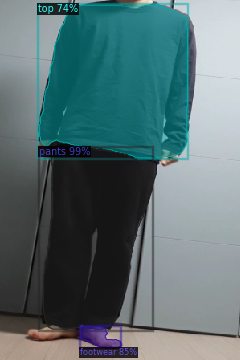

54 183 190 411
100 408 151 434
49 6 234 197
('1058699', '11625862', '2020.09.12', 'https://image.msscdn.net/data/estimate/1058699_0/gallery_5f5c2e81a15a2.jpg', '003', '003009', '1058699', 'https://image.msscdn.net/images/goods_img/20190529/1058699/1058699_7_500.jpg')


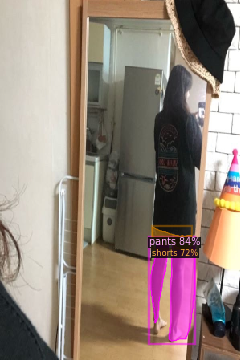

188 305 243 426
190 284 239 310
('2703608', '33053282', '2022.10.02', 'https://image.msscdn.net/data/estimate/2703608_0/gallery_633889a6dc15e.jpg', '003', '003002', '2703608', 'https://image.msscdn.net/images/goods_img/20220808/2703608/2703608_3_500.jpg')


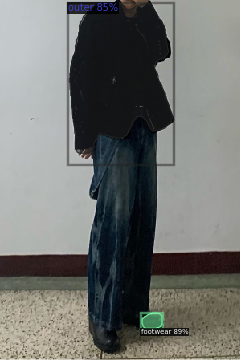

177 391 202 410
86 4 215 191
('2092162', '34996927', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2092162_0/gallery_63737915c8e92.jpg', '001', '001010', '2092162', 'https://image.msscdn.net/images/goods_img/20210826/2092162/2092162_2_500.jpg')


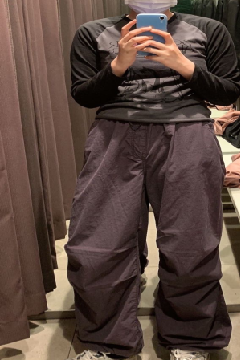

('2268150', '26416275', '2022.03.19', 'https://image.msscdn.net/data/estimate/2268150_0/gallery_623593b905324.jpg', '001', '001002', '2268150', 'https://image.msscdn.net/images/goods_img/20211214/2268150/2268150_2_500.jpg')


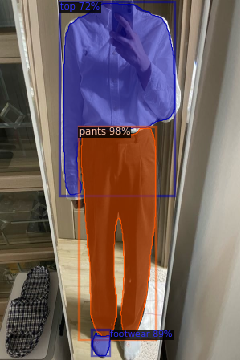

101 160 194 421
115 416 137 444
79 4 218 243
('2246751', '35739834', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2246751_0/gallery_637f60bd7e8d4.jpg', '005', '005005', '2246751', 'https://image.msscdn.net/images/goods_img/20211124/2246751/2246751_1_500.jpg')


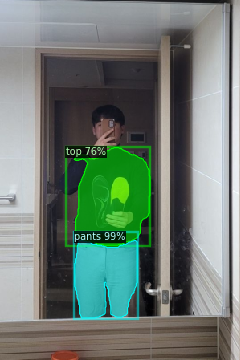

93 300 171 397
92 184 187 306
('1622019', '23530061', '2021.12.19', 'https://image.msscdn.net/data/estimate/1622019_0/gallery_61bf40c500ef8.jpg', '001', '001004', '1622019', 'https://image.msscdn.net/images/goods_img/20200924/1622019/1622019_6_500.jpg')


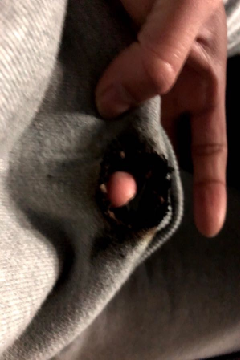

('2492545', '30938423', '2022.07.31', 'https://image.msscdn.net/data/estimate/2492545_0/gallery_62e57142e4a3d.jpg', '001', '001006', '2492545', 'https://image.msscdn.net/images/goods_img/20220415/2492545/2492545_1_500.jpg')


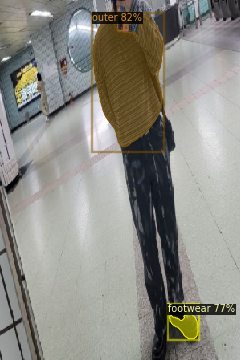

116 19 202 183
211 385 247 423
('2686229', '32702465', '2022.09.22', 'https://image.msscdn.net/data/estimate/2686229_0/gallery_632c40e5a6df1.jpg', '003', '003006', '2686229', 'https://image.msscdn.net/images/goods_img/20220728/2686229/2686229_7_500.jpg')


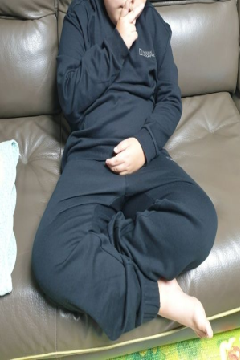

('2811528', '33693301', '2022.10.17', 'https://image.msscdn.net/data/estimate/2811528_0/gallery_634c1f874991a.jpg', '001', '001006', '2811528', 'https://image.msscdn.net/images/goods_img/20220922/2811528/2811528_1_500.jpg')


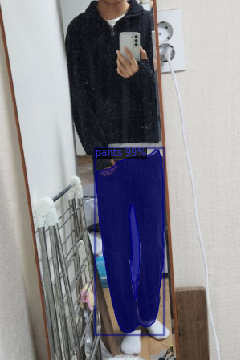

120 186 203 415
('2411106', '32652575', '2022.09.21', 'https://image.msscdn.net/data/estimate/2411106_0/gallery_632ab2248b282.jpg', '001', '001008', '2411106', 'https://image.msscdn.net/images/goods_img/20220311/2411106/2411106_7_500.jpg')


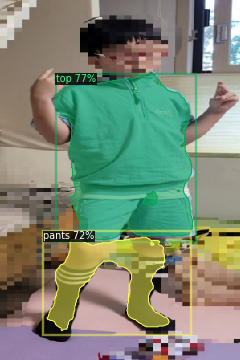

71 93 240 299
58 296 211 413
('1793971', '19944690', '2021.09.21', 'https://image.msscdn.net/data/estimate/1793971_0/gallery_6149c644b3521.jpg', '001', '001006', '1793971', 'https://image.msscdn.net/images/goods_img/20210215/1793971/1793971_2_500.jpg')


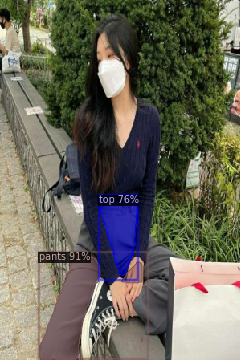

49 316 178 448
125 245 171 344
('1125810', '9086055', '2020.04.08', 'https://image.msscdn.net/data/estimate/1125810_0/gallery_5e8ca1b687f01.jpg', '001', '001005', '1125810', 'https://image.msscdn.net/images/goods_img/20190822/1125810/1125810_1_500.jpg')


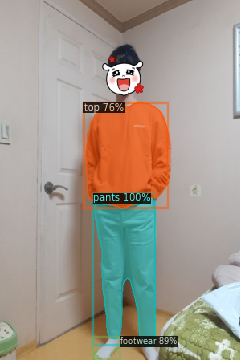

118 247 193 430
117 432 148 448
107 128 209 258
('1009492', '5182638', '2019.06.17', 'https://image.msscdn.net/data/estimate/1009492_0/gallery_5d07019fde711.jpg', '001', '001001', '1009492', 'https://image.msscdn.net/images/goods_img/20190410/1009492/1009492_3_500.jpg')


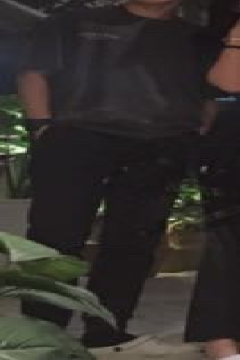

('1942916', '29364897', '2022.06.14', 'https://image.msscdn.net/data/estimate/1942916_0/gallery_62a8814f3f8b3.jpg', '003', '003007', '1942916', 'https://image.msscdn.net/images/goods_img/20210510/1942916/1942916_3_500.jpg')


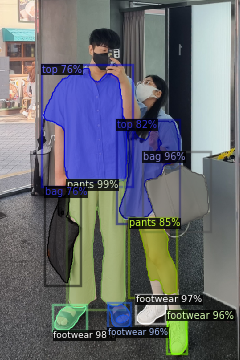

86 225 155 383
68 382 107 412
171 370 207 404
209 390 233 442
182 206 260 285
135 380 162 409
173 276 220 367
149 151 224 274
59 239 98 353
54 85 158 228
('404950', '9190493', '2020.04.15', 'https://image.msscdn.net/data/estimate/404950_0/gallery_5e962a03083e5.jpg', '003', '003004', '404950', 'https://image.msscdn.net/images/goods_img/20160902/404950/404950_2_500.jpg')


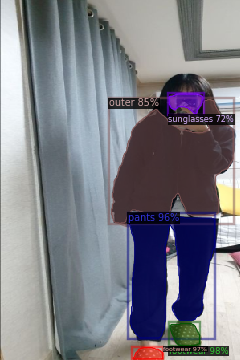

212 404 249 432
166 434 203 448
161 267 268 422
139 124 291 279
211 117 253 142
('2390729', '28392367', '2022.05.17', 'https://image.msscdn.net/data/estimate/2390729_0/gallery_6282833e98374.jpg', '001', '001010', '2390729', 'https://image.msscdn.net/images/goods_img/20220302/2390729/2390729_2_500.jpg')


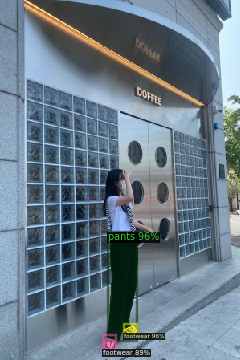

155 407 170 416
135 290 170 424
130 423 143 437
('1536609', '14349744', '2021.01.07', 'https://image.msscdn.net/data/estimate/1536609_0/gallery_5ff657a5aa91d.jpg', '001', '001010', '1536609', 'https://image.msscdn.net/images/goods_img/20200804/1536609/1536609_3_500.jpg')


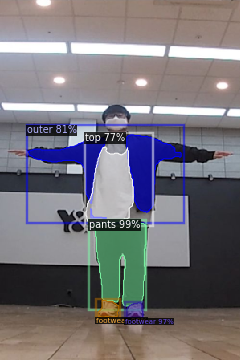

114 276 182 382
122 375 148 396
158 378 178 397
35 168 226 272
107 183 166 277
('2450066', '32436046', '2022.09.15', 'https://image.msscdn.net/data/estimate/2450066_0/gallery_63233869c646a.jpg', '003', '003009', '2450066', 'https://image.msscdn.net/images/goods_img/20220328/2450066/2450066_1_500.jpg')


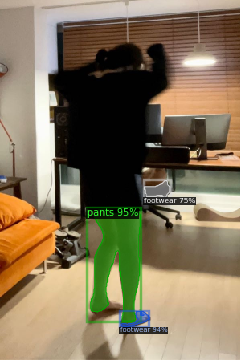

113 261 175 401
151 389 186 408
180 225 212 246
('2296983', '26921165', '2022.04.04', 'https://image.msscdn.net/data/estimate/2296983_0/gallery_624a4ddb61473.jpg', '001', '001002', '2296983', 'https://image.msscdn.net/images/goods_img/20220107/2296983/2296983_4_500.jpg')


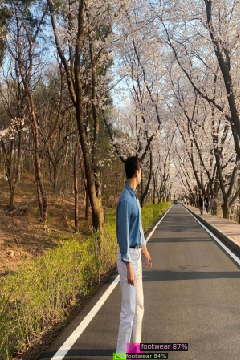

161 431 175 448
144 443 157 448
('1556005', '16147058', '2021.04.11', 'https://image.msscdn.net/data/estimate/1556005_0/gallery_60728983e42ee.jpg', '005', '005011', '1556005', 'https://image.msscdn.net/images/goods_img/20200819/1556005/1556005_1_500.jpg')


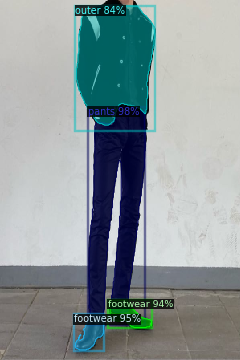

111 134 181 399
93 393 129 437
137 375 189 409
95 7 193 156
('1336714', '13777066', '2020.12.10', 'https://image.msscdn.net/data/estimate/1336714_0/gallery_5fd206eb13100.jpg', '001', '001010', '1336714', 'https://image.msscdn.net/images/goods_img/20200305/1336714/1336714_3_500.jpg')


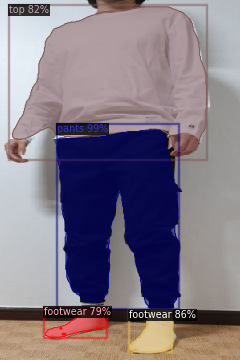

71 162 222 384
162 388 214 439
15 8 258 190
56 384 133 421
('2124439', '28098423', '2022.05.08', 'https://image.msscdn.net/data/estimate/2124439_0/gallery_6277d85a941c8.jpg', '003', '003008', '2124439', 'https://image.msscdn.net/images/goods_img/20210910/2124439/2124439_1_500.jpg')


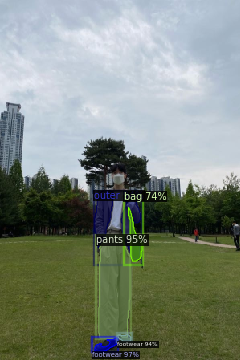

118 422 146 439
123 294 162 422
118 238 175 323
147 418 163 426
160 259 177 326
('2568744', '33775613', '2022.10.18', 'https://image.msscdn.net/data/estimate/2568744_0/gallery_634e987a945ab.jpg', '003', '003008', '2568744', 'https://image.msscdn.net/images/goods_img/20220518/2568744/2568744_1_500.jpg')


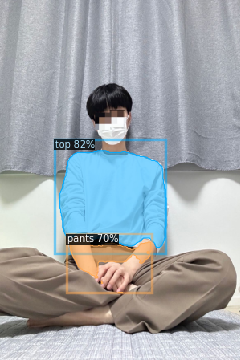

74 188 207 309
87 295 188 364
('2476545', '35563299', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2476545_0/gallery_637cd1f1272f1.jpg', '003', '003006', '2476545', 'https://image.msscdn.net/images/goods_img/20220408/2476545/2476545_1_500.jpg')


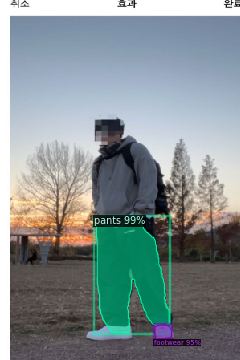

120 271 211 415
193 405 214 423
('877880', '5569502', '2019.07.23', 'https://image.msscdn.net/data/estimate/877880_0/gallery_5d3606ff90934.jpg', '001', '001010', '877880', 'https://image.msscdn.net/images/goods_img/20181011/877880/877880_1_500.jpg')


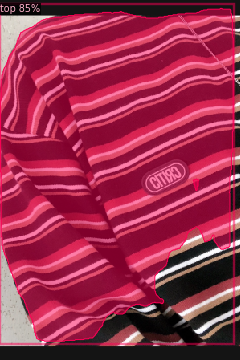

0 10 291 426
('1713163', '36331293', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/1713163_0/gallery_638c9c14be91d.jpg', '001', '001005', '1713163', 'https://image.msscdn.net/images/goods_img/20201203/1713163/1713163_1_500.jpg')


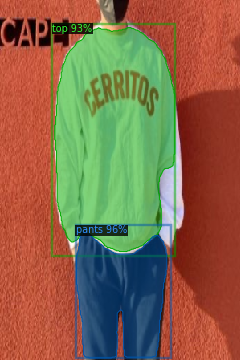

95 289 208 447
68 34 218 314
('2718818', '34209193', '2022.10.28', 'https://image.msscdn.net/data/estimate/2718818_0/gallery_635b9d7d6710c.jpg', '001', '001006', '2718818', 'https://image.msscdn.net/images/goods_img/20220816/2718818/2718818_1_500.jpg')


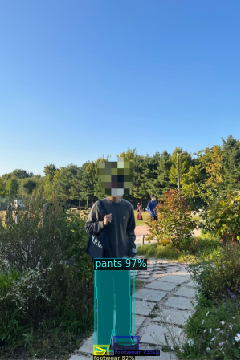

119 328 165 437
143 429 171 437
118 434 131 444
144 430 170 437
('2359607', '27528243', '2022.04.22', 'https://image.msscdn.net/data/estimate/2359607_0/gallery_62617d732dab4.jpg', '001', '001005', '2359607', 'https://image.msscdn.net/images/goods_img/20220215/2359607/2359607_1_500.jpg')


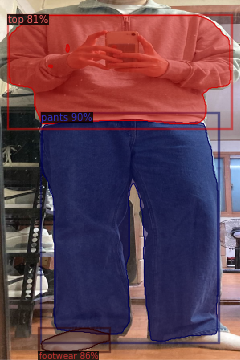

52 150 272 426
51 410 136 439
11 19 288 154
('2501076', '28873840', '2022.05.31', 'https://image.msscdn.net/data/estimate/2501076_0/gallery_6294ffc31cd22.jpg', '003', '003006', '2501076', 'https://image.msscdn.net/images/goods_img/20220419/2501076/2501076_1_500.jpg')


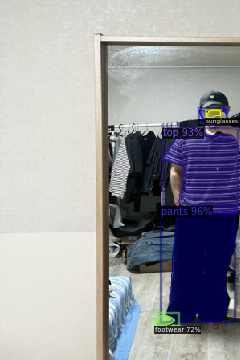

209 262 293 401
205 164 297 265
249 136 282 148
258 137 275 147
194 393 218 408
('1188313', '23460635', '2021.12.17', 'https://image.msscdn.net/data/estimate/1188313_0/gallery_61bc811989871.jpg', '003', '003004', '1188313', 'https://image.msscdn.net/images/goods_img/20191015/1188313/1188313_3_500.jpg')


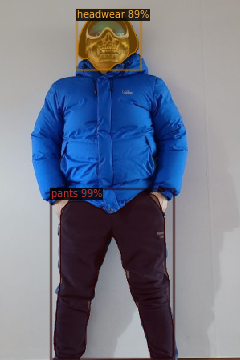

67 241 216 447
97 15 172 86
('1878233', '31603841', '2022.08.24', 'https://image.msscdn.net/data/estimate/1878233_0/gallery_6305859f47a32.jpg', '003', '003009', '1878233', 'https://image.msscdn.net/images/goods_img/20210402/1878233/1878233_1_500.jpg')


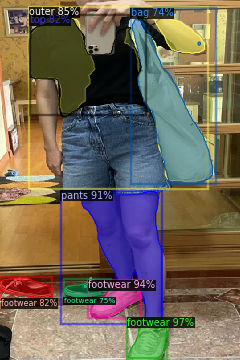

160 400 208 447
113 352 175 396
102 239 202 403
37 19 258 226
2 347 64 372
37 22 178 142
80 349 137 370
165 24 265 229
('2374950', '33159769', '2022.10.04', 'https://image.msscdn.net/data/estimate/2374950_0/gallery_633c4733695e0.jpg', '005', '005004', '2374950', 'https://image.msscdn.net/images/goods_img/20220221/2374950/2374950_1_500.jpg')


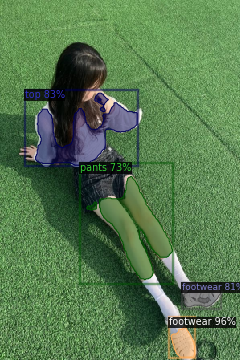

213 408 243 446
44 116 171 206
229 356 275 383
108 220 215 349
('1112845', '26119004', '2022.03.11', 'https://image.msscdn.net/data/estimate/1112845_0/gallery_622b0f4c054d3.jpg', '003', '003004', '1112845', 'https://image.msscdn.net/images/goods_img/20190807/1112845/1112845_1_500.jpg')


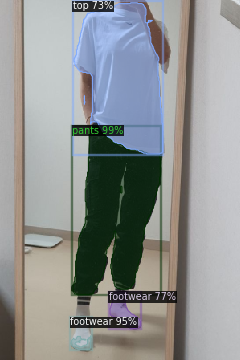

91 157 200 368
88 397 113 436
137 365 175 410
92 3 203 192
('2307327', '26444344', '2022.03.20', 'https://image.msscdn.net/data/estimate/2307327_0/gallery_6236cd560d04a.jpg', '001', '001010', '2307327', 'https://image.msscdn.net/images/goods_img/20220113/2307327/2307327_1_500.jpg')


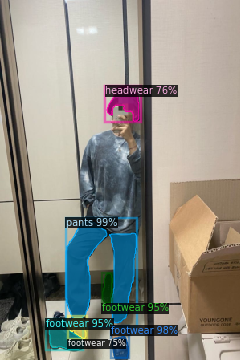

82 277 170 403
140 420 160 447
60 400 103 436
128 341 140 378
133 108 173 151
86 397 107 423
('684820', '15071908', '2021.02.18', 'https://image.msscdn.net/data/estimate/684820_0/gallery_602e592a4d223.jpg', '003', '003002', '684820', 'https://image.msscdn.net/images/goods_img/20171206/684820/684820_14_500.jpg')


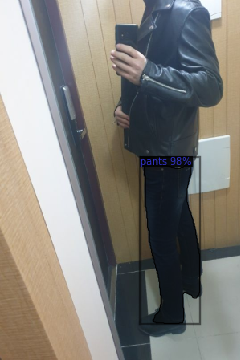

179 197 249 404
('2071326', '20683791', '2021.10.14', 'https://image.msscdn.net/data/estimate/2071326_0/gallery_616802f3badcb.jpg', '001', '001010', '2071326', 'https://image.msscdn.net/images/goods_img/20210819/2071326/2071326_1_500.jpg')


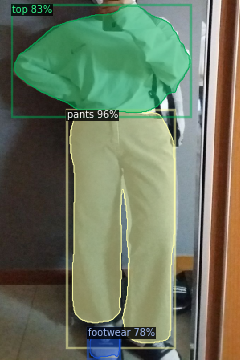

87 138 218 428
18 7 237 140
112 410 149 447
('971731', '15035906', '2021.02.17', 'https://image.msscdn.net/data/estimate/971731_0/gallery_602cd9e97551a.jpg', '001', '001001', '971731', 'https://image.msscdn.net/images/goods_img/20190305/971731/971731_1_500.jpg')


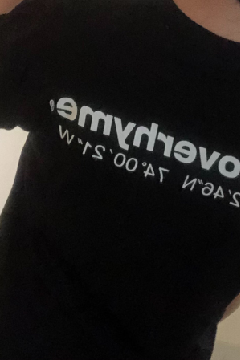

('1851969', '17291761', '2021.06.07', 'https://image.msscdn.net/data/estimate/1851969_0/gallery_60bd5d436034a.jpg', '003', '003008', '1851969', 'https://image.msscdn.net/images/goods_img/20210318/1851969/1851969_1_500.jpg')


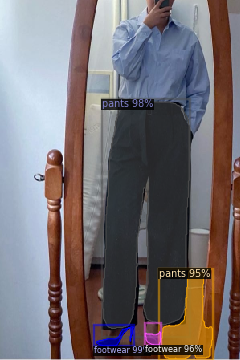

120 408 166 432
128 124 236 410
181 414 200 431
201 338 265 448
('1180386', '21430211', '2021.11.01', 'https://image.msscdn.net/data/estimate/1180386_0/gallery_617fdeb6d45d6.jpg', '003', '003006', '1180386', 'https://image.msscdn.net/images/goods_img/20191008/1180386/1180386_2_500.jpg')


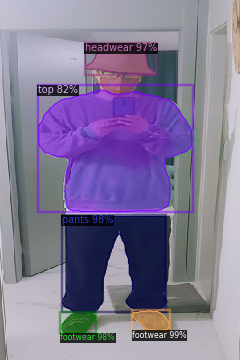

165 388 211 413
78 269 206 389
77 391 119 416
106 55 192 92
48 112 239 264
('1568043', '27908123', '2022.05.03', 'https://image.msscdn.net/data/estimate/1568043_0/gallery_627099b3b43d0.jpg', '005', '005015', '1568043', 'https://image.msscdn.net/images/goods_img/20200828/1568043/1568043_5_500.jpg')


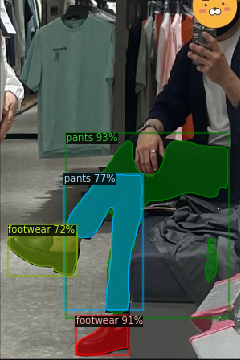

85 175 284 392
95 397 159 443
84 218 177 387
11 282 96 343
('947057', '26931194', '2022.04.04', 'https://image.msscdn.net/data/estimate/947057_0/gallery_624aad3e72f46.jpg', '003', '003009', '947057', 'https://image.msscdn.net/images/goods_img/20190201/947057/947057_3_500.jpg')


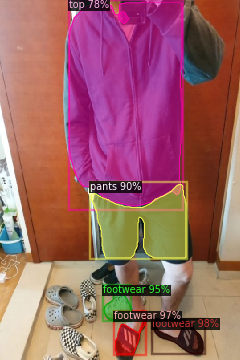

191 399 253 441
144 392 181 442
129 357 163 400
114 230 232 322
86 2 227 257
('2124224', '23259791', '2021.12.12', 'https://image.msscdn.net/data/estimate/2124224_0/gallery_61b5a37e23fce.jpg', '003', '003008', '2124224', 'https://image.msscdn.net/images/goods_img/20210910/2124224/2124224_2_500.jpg')


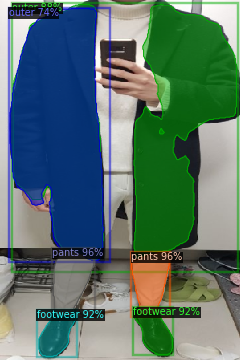

66 311 117 394
164 315 211 392
48 389 95 445
167 386 215 443
16 5 295 324
12 10 129 325
('2708883', '34654621', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2708883_0/gallery_636a266a874d8.jpg', '003', '003007', '2708883', 'https://image.msscdn.net/images/goods_img/20220810/2708883/2708883_3_500.jpg')


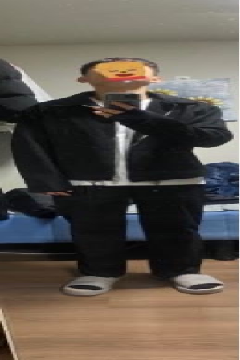

('1944546', '17210499', '2021.06.03', 'https://image.msscdn.net/data/estimate/1944546_0/gallery_60b8c32a40932.jpg', '003', '003002', '1944546', 'https://image.msscdn.net/images/goods_img/20210511/1944546/1944546_1_500.jpg')


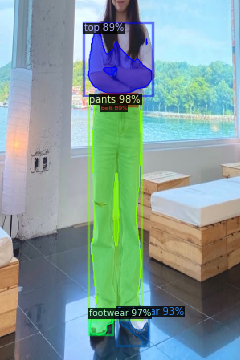

114 119 176 398
112 386 140 418
148 384 185 430
110 33 189 116
127 119 170 130
('2024948', '18914796', '2021.08.10', 'https://image.msscdn.net/data/estimate/2024948_0/gallery_61123d239b141.jpg', '003', '003008', '2024948', 'https://image.msscdn.net/images/goods_img/20210709/2024948/2024948_1_500.jpg')


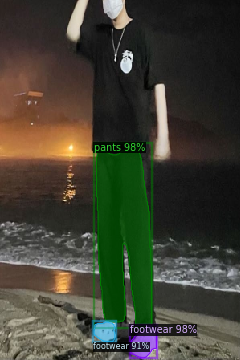

163 407 195 447
120 183 189 410
117 402 143 427
('2316067', '28827966', '2022.05.29', 'https://image.msscdn.net/data/estimate/2316067_0/gallery_629350cf9effc.jpg', '003', '003002', '2316067', 'https://image.msscdn.net/images/goods_img/20220119/2316067/2316067_1_500.jpg')


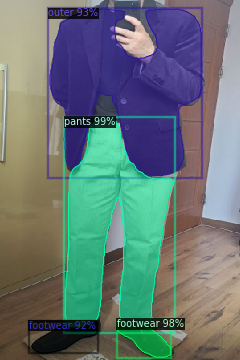

81 148 216 408
146 399 213 446
62 11 251 219
39 402 121 441
('1173380', '20513980', '2021.10.10', 'https://image.msscdn.net/data/estimate/1173380_0/gallery_61619ed9e8f4d.jpg', '001', '001005', '1173380', 'https://image.msscdn.net/images/goods_img/20191001/1173380/1173380_4_500.jpg')


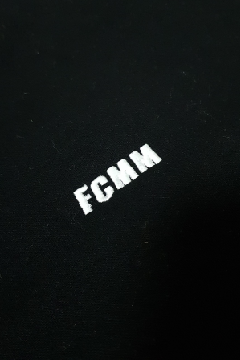

('2664733', '33379515', '2022.10.10', 'https://image.msscdn.net/data/estimate/2664733_0/gallery_6342ed2ae7aa5.jpg', '001', '001005', '2664733', 'https://image.msscdn.net/images/goods_img/20220714/2664733/2664733_1_500.jpg')


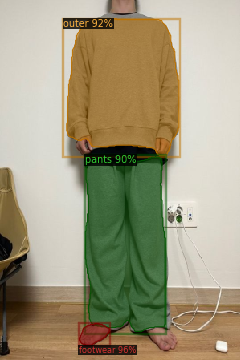

99 404 136 431
83 23 223 194
106 195 206 414
('2143706', '34905604', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2143706_0/gallery_6371d30d20598.jpg', '003', '003006', '2143706', 'https://image.msscdn.net/images/goods_img/20210923/2143706/2143706_1_500.jpg')


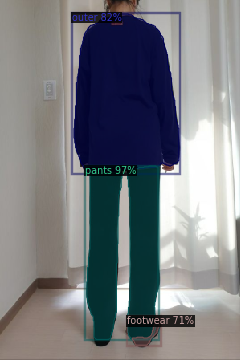

108 207 197 424
92 17 223 215
165 396 199 431
('880826', '9233273', '2020.04.18', 'https://image.msscdn.net/data/estimate/880826_0/gallery_5e99f2b8e7842.jpg', '003', '003008', '880826', 'https://image.msscdn.net/images/goods_img/20181015/880826/880826_3_500.jpg')


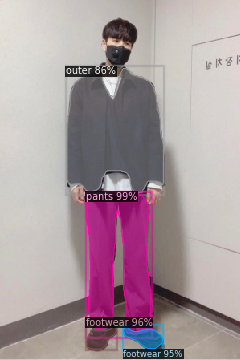

107 240 188 417
107 402 145 436
154 408 203 436
83 85 204 241
('2380557', '30999143', '2022.08.02', 'https://image.msscdn.net/data/estimate/2380557_0/gallery_62e8b71027169.jpg', '001', '001001', '2380557', 'https://image.msscdn.net/images/goods_img/20220223/2380557/2380557_1_500.jpg')


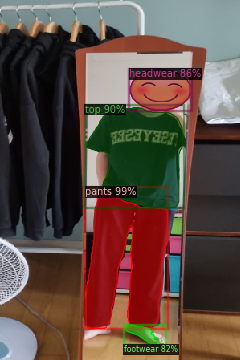

107 236 209 410
108 134 228 259
162 86 237 137
157 406 204 430
('1805599', '15872468', '2021.03.29', 'https://image.msscdn.net/data/estimate/1805599_0/gallery_6061e3aa61128.jpg', '003', '003002', '1805599', 'https://image.msscdn.net/images/goods_img/20210219/1805599/1805599_1_500.jpg')


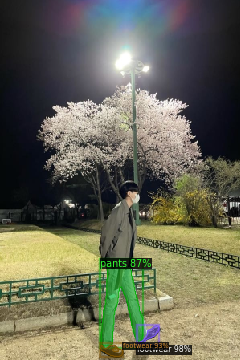

172 407 198 431
125 431 153 445
126 330 178 432
('1285087', '26513495', '2022.03.22', 'https://image.msscdn.net/data/estimate/1285087_0/gallery_62399ac7030d5.jpg', '003', '003008', '1285087', 'https://image.msscdn.net/images/goods_img/20200130/1285087/1285087_1_500.jpg')


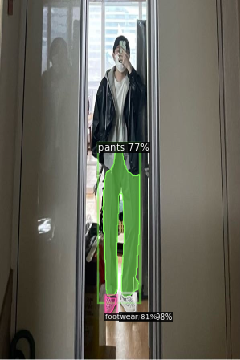

150 368 169 390
131 370 144 392
128 181 174 371
('1408179', '20498255', '2021.10.10', 'https://image.msscdn.net/data/estimate/1408179_0/gallery_6162e83494f4d.jpg', '001', '001003', '1408179', 'https://image.msscdn.net/images/goods_img/20200417/1408179/1408179_1_500.jpg')


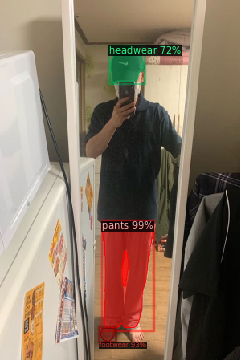

128 280 191 409
125 410 144 426
138 57 179 103
('2009035', '32185351', '2022.09.08', 'https://image.msscdn.net/data/estimate/2009035_0/gallery_6319e027bd8f1.jpg', '001', '001011', '2009035', 'https://image.msscdn.net/images/goods_img/20210624/2009035/2009035_4_500.jpg')


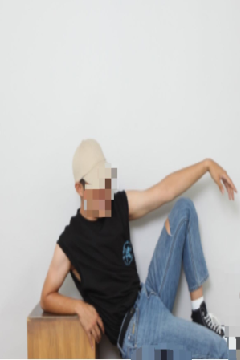

('1438728', '10076546', '2020.06.08', 'https://image.msscdn.net/data/estimate/1438728_0/gallery_5eddef7d2493c.jpg', '005', '005004', '1438728', 'https://image.msscdn.net/images/goods_img/20200511/1438728/1438728_2_500.jpg')


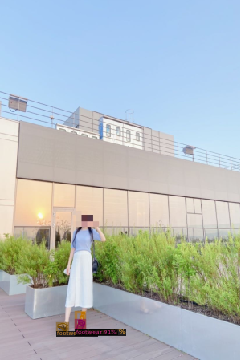

95 400 105 411
72 404 83 413
95 390 105 411
('2183727', '35441838', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2183727_0/gallery_637b055c87921.jpg', '003', '003007', '2183727', 'https://image.msscdn.net/images/goods_img/20211018/2183727/2183727_1_500.jpg')


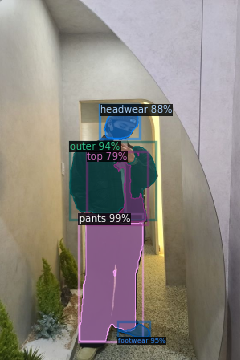

99 268 178 426
148 404 186 421
87 177 194 274
130 131 172 173
126 191 182 277
('1060006', '25561728', '2022.02.23', 'https://image.msscdn.net/data/estimate/1060006_0/gallery_6215b01bb10da.jpg', '001', '001001', '1060006', 'https://image.msscdn.net/images/goods_img/20190530/1060006/1060006_1_500.jpg')


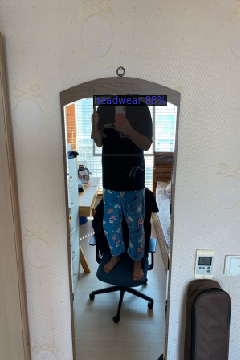

119 120 189 187
('2320530', '34624733', '2022.11.07', 'https://image.msscdn.net/data/estimate/2320530_0/gallery_636911c3691aa.jpg', '003', '003002', '2320530', 'https://image.msscdn.net/images/goods_img/20220121/2320530/2320530_1_500.jpg')


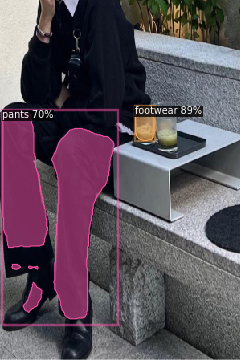

169 133 192 175
3 138 142 398
('1590214', '16120915', '2021.04.10', 'https://image.msscdn.net/data/estimate/1590214_0/gallery_60707d3596df7.jpg', '005', '005015', '1590214', 'https://image.msscdn.net/images/goods_img/20200908/1590214/1590214_1_500.jpg')


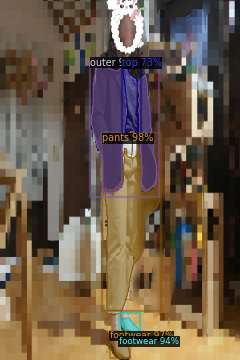

131 185 199 388
138 417 162 447
150 392 173 420
114 73 195 241
153 73 173 170
('2015007', '18911325', '2021.08.10', 'https://image.msscdn.net/data/estimate/2015007_0/gallery_61121dc3a171d.jpg', '005', '005004', '2015007', 'https://image.msscdn.net/images/goods_img/20210630/2015007/2015007_1_500.jpg')


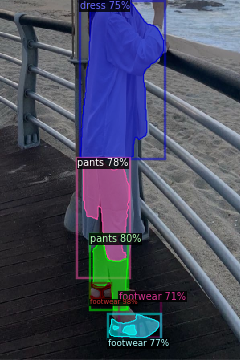

113 355 138 373
115 296 159 387
104 199 161 326
136 393 198 422
100 2 204 198
150 375 199 420
('1878233', '19991421', '2021.09.23', 'https://image.msscdn.net/data/estimate/1878233_0/gallery_614c681d2f539.jpg', '003', '003009', '1878233', 'https://image.msscdn.net/images/goods_img/20210402/1878233/1878233_1_500.jpg')


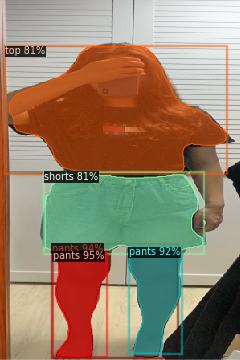

69 314 132 445
70 310 221 446
161 309 226 441
56 215 253 316
11 58 282 215
('2413475', '27353974', '2022.04.17', 'https://image.msscdn.net/data/estimate/2413475_0/gallery_625af67c9e9f2.jpg', '003', '003002', '2413475', 'https://image.msscdn.net/images/goods_img/20220311/2413475/2413475_3_500.jpg')


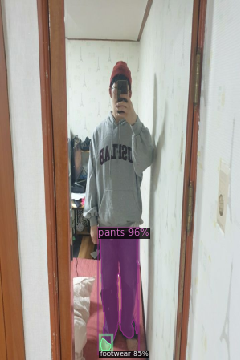

125 286 172 429
125 422 138 438
('2065940', '19328410', '2021.08.28', 'https://image.msscdn.net/data/estimate/2065940_0/gallery_612a1dfb05145.jpg', '001', '001004', '2065940', 'https://image.msscdn.net/images/goods_img/20210817/2065940/2065940_1_500.png')


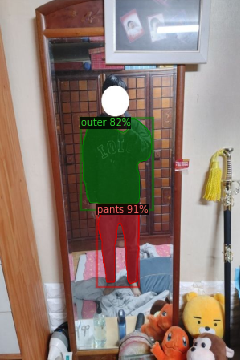

122 256 173 354
103 148 189 258
('2762794', '32538655', '2022.09.18', 'https://image.msscdn.net/data/estimate/2762794_0/gallery_6326c9fe1cf9f.jpg', '003', '003002', '2762794', 'https://image.msscdn.net/images/goods_img/20220901/2762794/2762794_2_500.jpg')


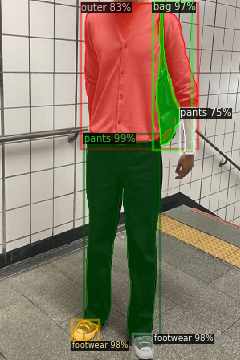

107 167 199 426
167 420 191 447
91 400 122 425
194 15 224 180
106 4 246 178
227 137 242 191
('2155926', '21195748', '2021.10.26', 'https://image.msscdn.net/data/estimate/2155926_0/gallery_6177e08b9d484.jpg', '001', '001010', '2155926', 'https://image.msscdn.net/images/goods_img/20210930/2155926/2155926_2_500.jpg')


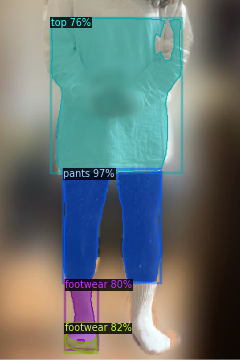

79 215 200 352
81 408 120 440
82 351 121 436
64 22 226 215
('1348061', '28923557', '2022.06.01', 'https://image.msscdn.net/data/estimate/1348061_0/gallery_629713c0213e2.jpg', '003', '003008', '1348061', 'https://image.msscdn.net/images/goods_img/20200312/1348061/1348061_2_500.jpg')


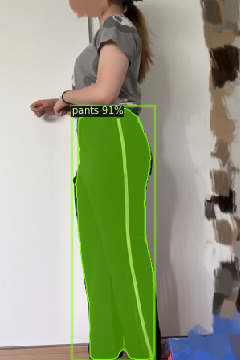

94 134 192 449
('2041103', '29235581', '2022.06.10', 'https://image.msscdn.net/data/estimate/2041103_0/gallery_62a35606114dd.jpg', '001', '001002', '2041103', 'https://image.msscdn.net/images/goods_img/20210727/2041103/2041103_5_500.jpg')


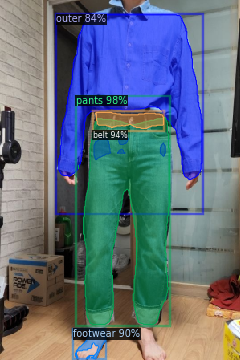

97 146 211 405
119 140 204 160
94 412 131 448
73 18 252 224
('2363964', '28977242', '2022.06.03', 'https://image.msscdn.net/data/estimate/2363964_0/gallery_6298ffa61eb11.jpg', '003', '003007', '2363964', 'https://image.msscdn.net/images/goods_img/20220216/2363964/2363964_1_500.jpg')


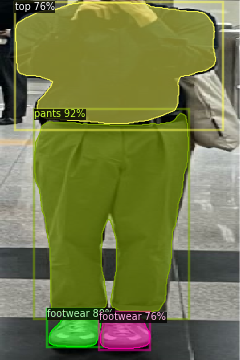

43 141 235 390
61 387 126 433
125 391 187 435
19 3 269 154
('2702399', '34564262', '2022.11.06', 'https://image.msscdn.net/data/estimate/2702399_0/gallery_63676641eef6e.jpg', '001', '001006', '2702399', 'https://image.msscdn.net/images/goods_img/20220807/2702399/2702399_1_500.jpg')


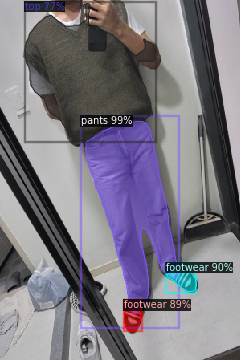

107 151 222 392
208 330 245 364
155 377 177 413
31 4 193 175
('843279', '8131685', '2020.02.03', 'https://image.msscdn.net/data/estimate/843279_0/gallery_5e36e965cb024.jpg', '001', '001006', '843279', 'https://image.msscdn.net/images/goods_img/20180830/843279/843279_2_500.jpg')


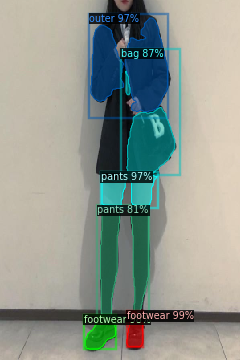

158 389 178 433
106 394 144 436
113 22 209 139
127 217 196 259
157 88 218 216
125 257 185 395
('1089897', '27667092', '2022.04.26', 'https://image.msscdn.net/data/estimate/1089897_0/gallery_62677c2d04fa6.jpg', '001', '001010', '1089897', 'https://image.msscdn.net/images/goods_img/20190704/1089897/1089897_5_500.jpg')


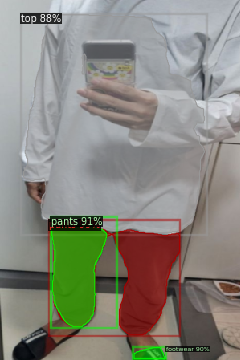

62 277 224 418
64 276 133 408
167 434 206 448
28 18 255 290
('2411586', '28728857', '2022.05.26', 'https://image.msscdn.net/data/estimate/2411586_0/gallery_628f4dc5c5143.jpg', '001', '001003', '2411586', 'https://image.msscdn.net/images/goods_img/20220311/2411586/2411586_1_500.jpg')


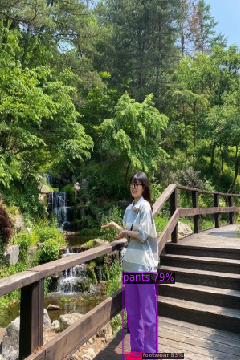

159 442 177 448
156 342 195 447
('2762297', '33969370', '2022.10.22', 'https://image.msscdn.net/data/estimate/2762297_0/gallery_6354014d101f9.jpg', '001', '001008', '2762297', 'https://image.msscdn.net/images/goods_img/20220901/2762297/2762297_6_500.jpg')


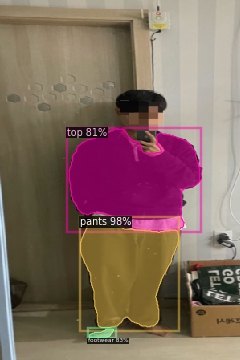

100 272 223 409
111 411 142 422
86 160 249 288
('1224094', '21568663', '2021.12.30', 'https://image.msscdn.net/data/estimate/1224094_0/gallery_6184924bac297.jpg', '003', '003008', '1224094', 'https://image.msscdn.net/images/goods_img/20191113/1224094/1224094_4_500.jpg')


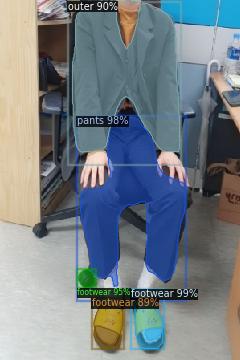

165 364 203 435
100 146 231 358
98 336 118 359
90 3 224 190
117 380 153 435
('1548480', '24150305', '2022.01.09', 'https://image.msscdn.net/data/estimate/1548480_0/gallery_61da566a10b26.jpg', '001', '001006', '1548480', 'https://image.msscdn.net/images/goods_img/20200813/1548480/1548480_3_500.jpg')


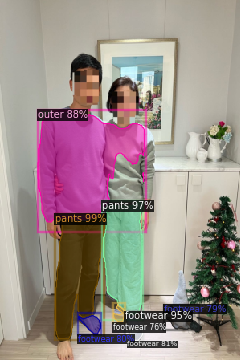

69 268 130 423
129 253 177 393
159 404 177 425
47 138 180 277
160 407 178 425
98 394 125 417
206 382 248 412
141 380 155 402
('1474586', '30256821', '2022.07.10', 'https://image.msscdn.net/data/estimate/1474586_0/gallery_62cabdcad2377.jpg', '003', '003004', '1474586', 'https://image.msscdn.net/images/goods_img/20200605/1474586/1474586_1_500.jpg')


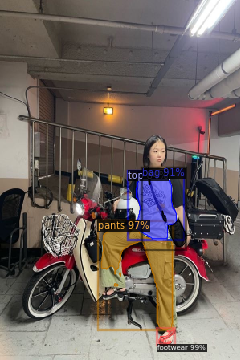

198 411 217 430
126 283 215 411
182 214 232 308
169 214 220 298
('2081336', '20561377', '2021.10.11', 'https://image.msscdn.net/data/estimate/2081336_0/gallery_61641f6577923.jpg', '003', '003004', '2081336', 'https://image.msscdn.net/images/goods_img/20210823/2081336/2081336_1_500.jpg')


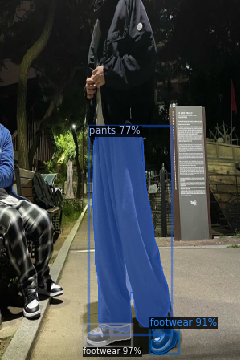

107 405 163 433
188 398 221 441
115 166 211 415
('2322559', '26682357', '2022.03.27', 'https://image.msscdn.net/data/estimate/2322559_0/gallery_6240387c305a3.jpg', '003', '003002', '2322559', 'https://image.msscdn.net/images/goods_img/20220124/2322559/2322559_1_500.jpg')


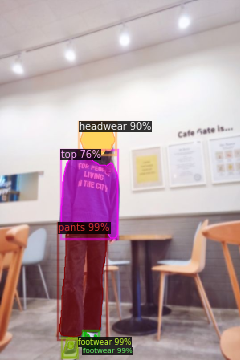

78 422 97 446
74 279 132 421
105 415 122 434
100 153 143 192
76 188 146 297
('2392463', '29845837', '2022.06.28', 'https://image.msscdn.net/data/estimate/2392463_0/gallery_62baf5b6c3d19.jpg', '003', '003009', '2392463', 'https://image.msscdn.net/images/goods_img/20220302/2392463/2392463_1_500.jpg')


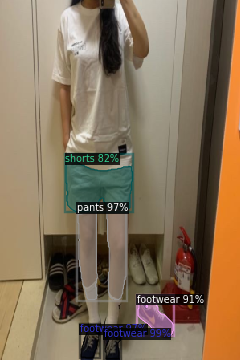

131 414 150 448
101 407 123 447
97 259 157 374
172 369 216 418
82 195 165 264
('532248', '12319635', '2020.10.17', 'https://image.msscdn.net/data/estimate/532248_0/gallery_5f89ea162f919.jpg', '001', '001010', '532248', 'https://image.msscdn.net/images/goods_img/20170331/532248/532248_3_500.jpg')


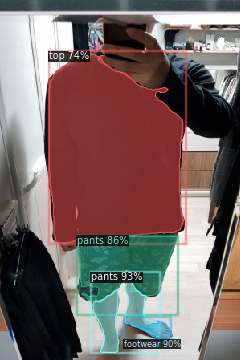

115 349 198 440
157 401 212 423
97 295 221 378
61 66 229 304
('1960628', '19822070', '2021.09.15', 'https://image.msscdn.net/data/estimate/1960628_0/gallery_6141feb33bd90.jpg', '003', '003008', '1960628', 'https://image.msscdn.net/images/goods_img/20210521/1960628/1960628_2_500.jpg')


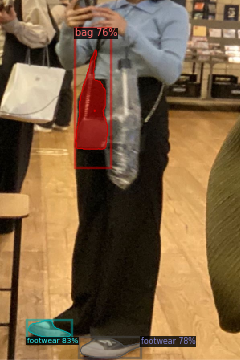

35 400 88 421
100 423 175 446
94 62 134 186
('1311947', '24876055', '2022.02.07', 'https://image.msscdn.net/data/estimate/1311947_0/gallery_61fcf8a32eb69.jpg', '001', '001003', '1311947', 'https://image.msscdn.net/images/goods_img/20200219/1311947/1311947_1_500.jpg')


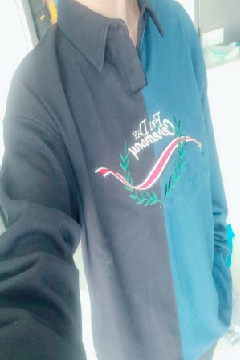

('2116358', '21316055', '2021.10.29', 'https://image.msscdn.net/data/estimate/2116358_0/gallery_617baacdece70.jpg', '005', '005011', '2116358', 'https://image.msscdn.net/images/goods_img/20210908/2116358/2116358_1_500.jpg')


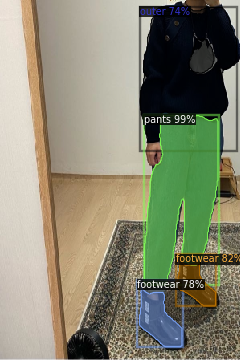

180 144 272 356
221 319 269 382
174 352 227 433
175 8 295 177
('2098372', '32950215', '2022.09.29', 'https://image.msscdn.net/data/estimate/2098372_0/gallery_63352d3348671.jpg', '003', '003008', '2098372', 'https://image.msscdn.net/images/goods_img/20210830/2098372/2098372_1_500.jpg')


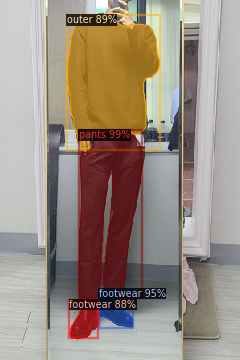

99 164 176 372
124 361 165 407
84 19 199 186
87 375 121 421
('1786750', '20085263', '2021.09.26', 'https://image.msscdn.net/data/estimate/1786750_0/gallery_61506a548edb1.jpg', '003', '003002', '1786750', 'https://image.msscdn.net/images/goods_img/20210209/1786750/1786750_1_500.jpg')


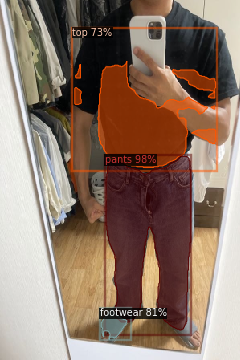

132 195 238 412
126 386 158 424
93 76 269 209
('1427120', '11973562', '2020.10.01', 'https://image.msscdn.net/data/estimate/1427120_0/gallery_5f74c88863242.jpg', '003', '003002', '1427120', 'https://image.msscdn.net/images/goods_img/20200429/1427120/1427120_1_500.jpg')


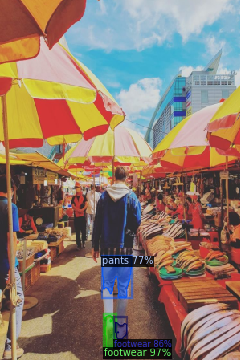

130 394 143 434
144 402 158 423
128 321 164 371
('1876392', '18240554', '2021.07.13', 'https://image.msscdn.net/data/estimate/1876392_0/gallery_60ed1c912ace4.jpg', '001', '001001', '1876392', 'https://image.msscdn.net/images/goods_img/20210401/1876392/1876392_2_500.jpg')


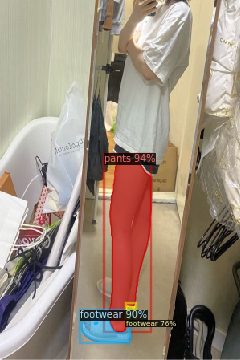

136 199 188 414
102 388 162 426
158 382 168 398
('2686394', '36031229', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2686394_0/gallery_6385bb223b451.jpg', '001', '001008', '2686394', 'https://image.msscdn.net/images/goods_img/20220728/2686394/2686394_1_500.jpg')


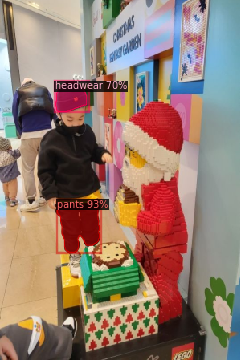

71 250 124 315
69 102 108 139
('2574823', '29221596', '2022.06.10', 'https://image.msscdn.net/data/estimate/2574823_0/gallery_62a2f5135eaaf.jpg', '003', '003009', '2574823', 'https://image.msscdn.net/images/goods_img/20220523/2574823/2574823_2_500.jpg')


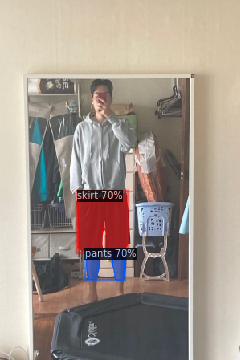

108 312 155 350
97 241 159 315
('1262089', '12759111', '2020.11.04', 'https://image.msscdn.net/data/estimate/1262089_0/gallery_5fa26cf8eaeed.jpg', '005', '005011', '1262089', 'https://image.msscdn.net/images/goods_img/20200103/1262089/1262089_3_500.jpg')


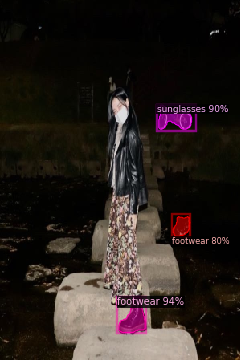

148 371 181 415
198 131 239 161
216 270 237 295
('2089209', '23140896', '2021.12.09', 'https://image.msscdn.net/data/estimate/2089209_0/gallery_61b19c067eb9f.jpg', '003', '003002', '2089209', 'https://image.msscdn.net/images/goods_img/20210826/2089209/2089209_4_500.jpg')


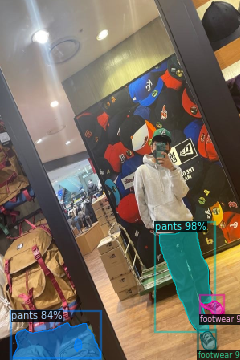

199 281 263 414
250 414 269 437
251 376 278 393
16 403 125 447
('743456', '21707217', '2021.11.09', 'https://image.msscdn.net/data/estimate/743456_0/gallery_6189db6480f20.jpg', '003', '003007', '743456', 'https://image.msscdn.net/images/goods_img/20180327/743456/743456_2_500.jpg')


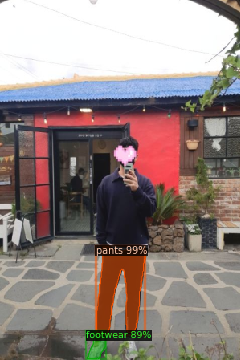

120 308 181 418
109 414 131 448
('2306361', '27127890', '2022.04.10', 'https://image.msscdn.net/data/estimate/2306361_0/gallery_6252aaae8d789.jpg', '003', '003008', '2306361', 'https://image.msscdn.net/images/goods_img/20220113/2306361/2306361_1_500.jpg')


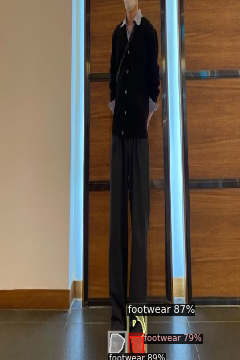

137 417 155 441
163 383 181 444
163 420 179 445
('2790997', '35158258', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2790997_0/gallery_637602c04ce8e.jpg', '001', '001008', '2790997', 'https://image.msscdn.net/images/goods_img/20220914/2790997/2790997_1_500.jpg')


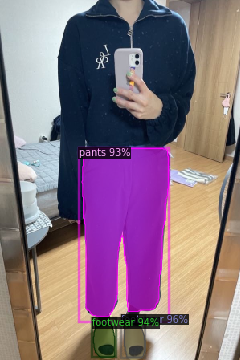

153 394 181 446
116 401 143 446
102 185 210 395
('1558045', '15955919', '2021.04.02', 'https://image.msscdn.net/data/estimate/1558045_0/gallery_6066d724e3d51.jpg', '003', '003010', '1558045', 'https://image.msscdn.net/images/goods_img/20200820/1558045/1558045_5_500.jpg')


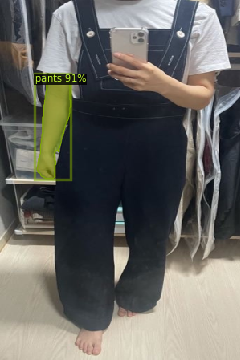

46 93 88 223
('2700190', '35008146', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2700190_0/gallery_637393bd63d18.jpg', '003', '003002', '2700190', 'https://image.msscdn.net/images/goods_img/20220805/2700190/2700190_1_500.jpg')


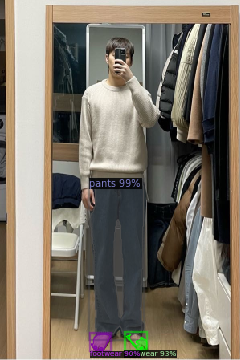

113 223 179 418
157 417 183 438
114 417 137 438
('2388152', '34596472', '2022.11.07', 'https://image.msscdn.net/data/estimate/2388152_0/gallery_636867527794e.jpg', '003', '003007', '2388152', 'https://image.msscdn.net/images/goods_img/20220228/2388152/2388152_1_500.jpg')


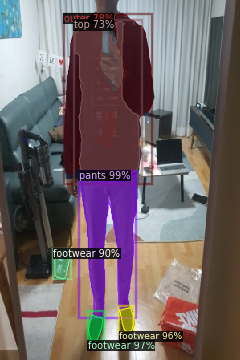

100 215 169 396
110 393 128 425
149 384 166 414
68 312 87 348
81 17 189 223
93 26 174 228
('2501146', '32845425', '2022.09.26', 'https://image.msscdn.net/data/estimate/2501146_0/gallery_63319f0ea5bdd.jpg', '003', '003006', '2501146', 'https://image.msscdn.net/images/goods_img/20220419/2501146/2501146_2_500.jpg')


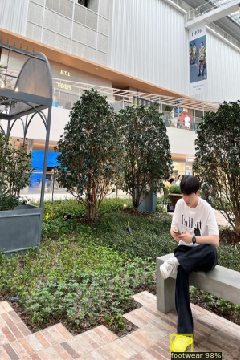

215 419 239 440
('1628946', '19955852', '2021.09.22', 'https://image.msscdn.net/data/estimate/1628946_0/gallery_614a9945b6bab.jpg', '001', '001006', '1628946', 'https://image.msscdn.net/images/goods_img/20200928/1628946/1628946_2_500.jpg')


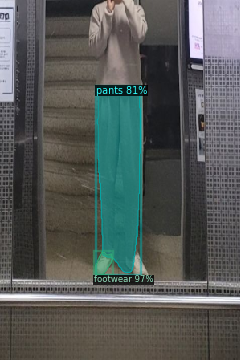

119 315 140 343
121 108 175 340
('1149329', '8073371', '2020.01.29', 'https://image.msscdn.net/data/estimate/1149329_0/gallery_5e318450a8abb.jpg', '003', '003008', '1149329', 'https://image.msscdn.net/images/goods_img/20190910/1149329/1149329_4_500.jpg')


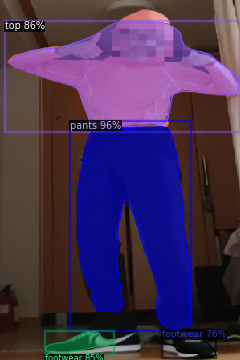

98 158 238 410
13 28 298 159
56 414 141 442
203 413 269 446
('1589973', '35230399', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/1589973_0/gallery_637721c94eabd.jpg', '001', '001005', '1589973', 'https://image.msscdn.net/images/goods_img/20200908/1589973/1589973_1_500.jpg')


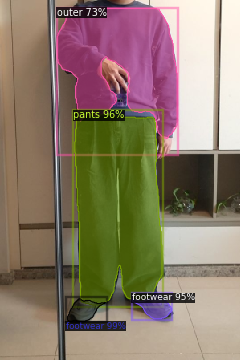

84 373 131 401
93 139 202 381
165 368 214 398
71 10 221 173
('1268881', '24876632', '2022.02.07', 'https://image.msscdn.net/data/estimate/1268881_0/gallery_62008f2384358.jpg', '001', '001006', '1268881', 'https://image.msscdn.net/images/goods_img/20200113/1268881/1268881_1_500.jpg')


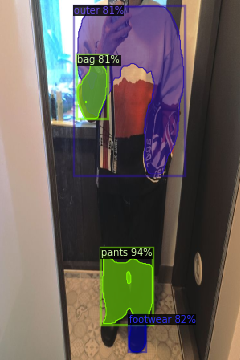

128 317 190 404
161 394 181 439
97 75 133 148
96 7 229 217
('499333', '2903252', '2018.10.22', 'https://image.msscdn.net/data/estimate/499333_0/gallery_5bcd18d2220c8.jpg', '005', '005015', '499333', 'https://image.msscdn.net/images/goods_img/20170314/499333/499333_2_500.jpg')


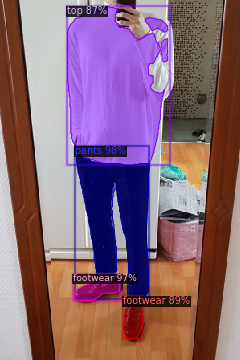

95 190 185 373
93 343 149 376
154 371 178 423
84 8 209 206
('1551896', '34329738', '2022.11.01', 'https://image.msscdn.net/data/estimate/1551896_0/gallery_635ffc80e7c25.jpg', '001', '001010', '1551896', 'https://image.msscdn.net/images/goods_img/20200818/1551896/1551896_3_500.jpg')


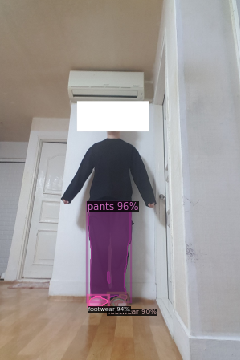

110 252 162 374
111 370 134 383
137 368 158 386
('2164659', '24938288', '2022.02.06', 'https://image.msscdn.net/data/estimate/2164659_0/gallery_61fea1315ab1b.jpg', '003', '003007', '2164659', 'https://image.msscdn.net/images/goods_img/20211006/2164659/2164659_2_500.jpg')


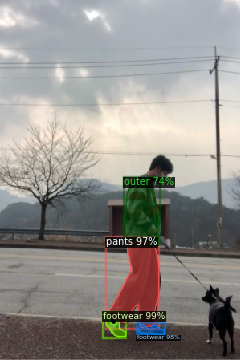

131 391 157 421
172 405 205 418
135 301 198 409
155 222 198 305
('2326763', '33966015', '2022.10.22', 'https://image.msscdn.net/data/estimate/2326763_0/gallery_6353ef54cfb1b.jpg', '003', '003007', '2326763', 'https://image.msscdn.net/images/goods_img/20220125/2326763/2326763_2_500.jpg')


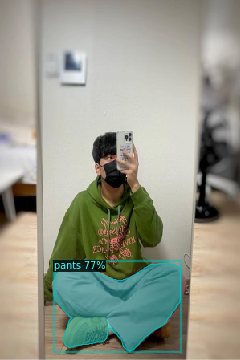

67 328 225 438
('2346672', '32773776', '2022.09.24', 'https://image.msscdn.net/data/estimate/2346672_0/gallery_632eec794597f.jpg', '003', '003002', '2346672', 'https://image.msscdn.net/images/goods_img/20220208/2346672/2346672_3_500.jpg')


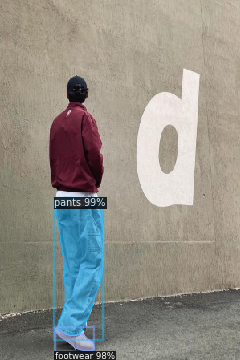

70 252 127 418
69 410 117 438
('2332832', '26814891', '2022.03.31', 'https://image.msscdn.net/data/estimate/2332832_0/gallery_6245999adfb70.jpg', '003', '003007', '2332832', 'https://image.msscdn.net/images/goods_img/20220127/2332832/2332832_1_500.jpg')


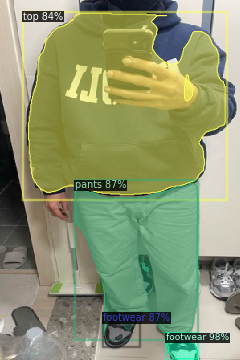

208 418 246 448
130 392 173 433
94 228 247 421
35 16 281 243
('1324000', '24696496', '2022.01.28', 'https://image.msscdn.net/data/estimate/1324000_0/gallery_61f345fb735b2.jpg', '001', '001005', '1324000', 'https://image.msscdn.net/images/goods_img/20200226/1324000/1324000_3_500.jpg')


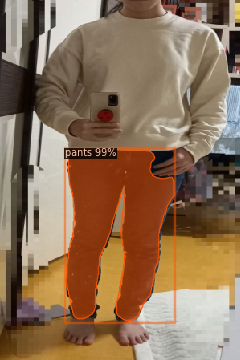

82 186 217 400
('1370756', '15613059', '2021.03.17', 'https://image.msscdn.net/data/estimate/1370756_0/gallery_6050ce8290f31.jpg', '001', '001005', '1370756', 'https://image.msscdn.net/images/goods_img/20200327/1370756/1370756_5_500.jpg')


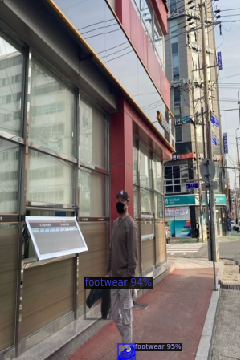

148 432 168 448
108 348 136 397
('2512970', '29711841', '2022.06.24', 'https://image.msscdn.net/data/estimate/2512970_0/gallery_62b56e9d2c9c8.jpg', '001', '001011', '2512970', 'https://image.msscdn.net/images/goods_img/20220425/2512970/2512970_2_500.jpg')


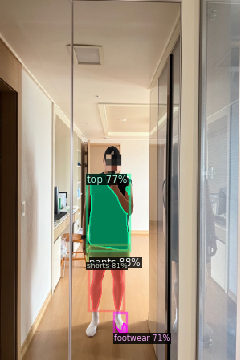

113 327 153 387
110 307 160 328
111 218 161 312
143 403 158 416
('1986543', '29511010', '2022.06.18', 'https://image.msscdn.net/data/estimate/1986543_0/gallery_62adb92b82a05.jpg', '003', '003006', '1986543', 'https://image.msscdn.net/images/goods_img/20210607/1986543/1986543_1_500.jpg')


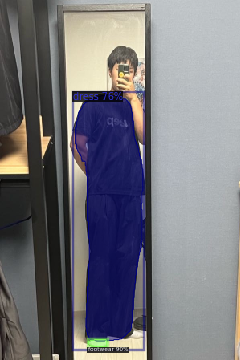

110 424 133 433
94 118 178 426
('2154595', '21041214', '2021.10.22', 'https://image.msscdn.net/data/estimate/2154595_0/gallery_6172aaa3ec0e5.jpg', '003', '003007', '2154595', 'https://image.msscdn.net/images/goods_img/20210930/2154595/2154595_1_500.jpg')


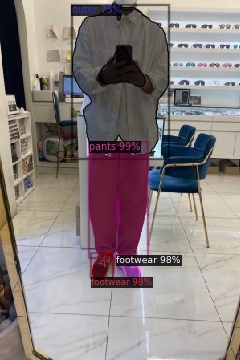

112 183 184 321
115 318 140 347
146 320 174 353
90 9 210 193
('2768387', '36456486', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2768387_0/gallery_638f501bdae2b.jpg', '005', '005006', '2768387', 'https://image.msscdn.net/images/goods_img/20220905/2768387/2768387_1_500.jpg')


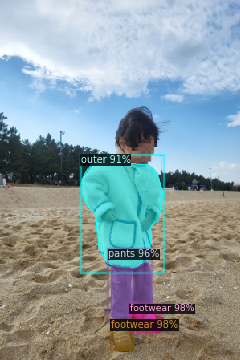

165 381 199 414
139 402 165 437
138 327 189 401
101 194 203 334
('2816816', '35966352', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2816816_0/gallery_63842c13693a0.jpg', '005', '005011', '2816816', 'https://image.msscdn.net/images/goods_img/20220923/2816816/2816816_2_500.jpg')


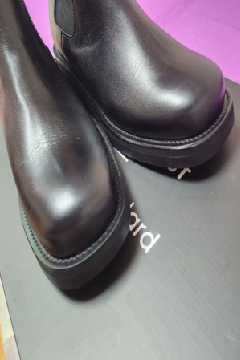

('896650', '3788831', '2019.01.29', 'https://image.msscdn.net/data/estimate/896650_0/gallery_5c4fec3c3f2d3.jpg', '003', '003007', '896650', 'https://image.msscdn.net/images/goods_img/20181101/896650/896650_9_500.jpg')


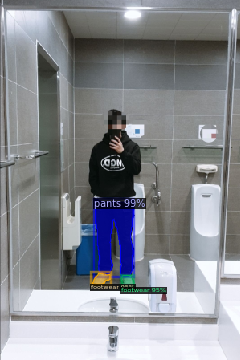

118 249 166 345
151 344 167 359
115 341 137 355
('1283635', '16529327', '2021.05.01', 'https://image.msscdn.net/data/estimate/1283635_0/gallery_608c3fe4be0cd.jpg', '003', '003006', '1283635', 'https://image.msscdn.net/images/goods_img/20200129/1283635/1283635_3_500.jpg')


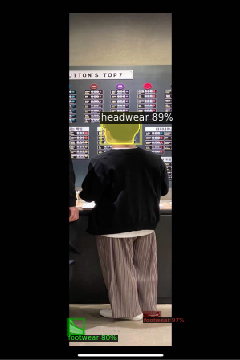

180 390 199 396
127 141 174 179
86 398 104 418
('2348242', '32608033', '2022.09.20', 'https://image.msscdn.net/data/estimate/2348242_0/gallery_63294b9e64953.jpg', '001', '001004', '2348242', 'https://image.msscdn.net/images/goods_img/20220209/2348242/2348242_1_500.jpg')


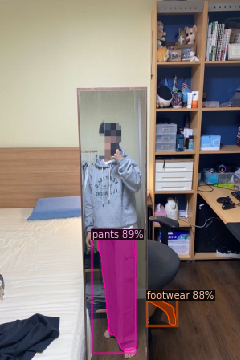

122 287 169 438
184 364 219 406
('2670398', '35881715', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2670398_0/gallery_638215c7aadb6.jpg', '001', '001008', '2670398', 'https://image.msscdn.net/images/goods_img/20220719/2670398/2670398_1_500.jpg')


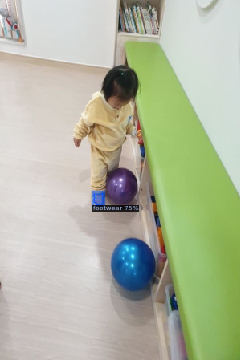

117 241 128 256
('337726', '10331806', '2020.10.18', 'https://image.msscdn.net/data/estimate/337726_0/gallery_5f8c423ab5e22.jpg', '003', '003009', '337726', 'https://image.msscdn.net/images/goods_img/20160415/337726/337726_2_500.jpg')


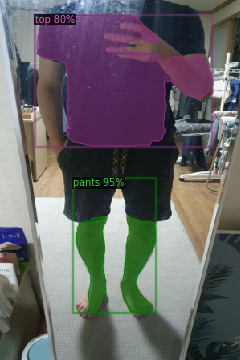

95 270 194 389
46 19 263 182
('2352002', '28685823', '2022.05.25', 'https://image.msscdn.net/data/estimate/2352002_0/gallery_628dddc4708e7.jpg', '001', '001001', '2352002', 'https://image.msscdn.net/images/goods_img/20220210/2352002/2352002_2_500.jpg')


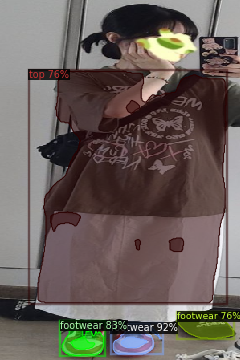

141 404 201 442
77 404 129 444
222 390 291 423
47 89 282 378
('2670973', '34738527', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2670973_0/gallery_636c8751b4189.jpg', '001', '001008', '2670973', 'https://image.msscdn.net/images/goods_img/20220719/2670973/2670973_1_500.jpg')


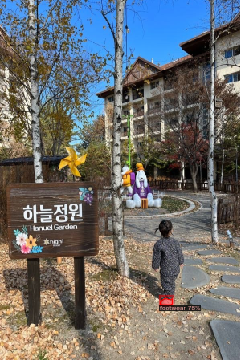

200 372 215 381
('2413584', '34513213', '2022.11.05', 'https://image.msscdn.net/data/estimate/2413584_0/gallery_6365cdbdad796.jpg', '003', '003006', '2413584', 'https://image.msscdn.net/images/goods_img/20220311/2413584/2413584_1_500.jpg')


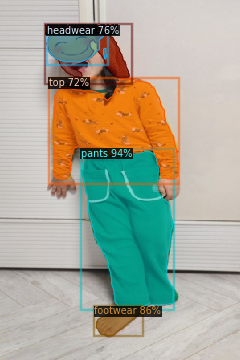

58 31 161 96
102 189 217 386
120 383 178 419
59 32 133 77
66 99 222 223
('2733455', '36280353', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2733455_0/gallery_638b521cd0efb.jpg', '001', '001006', '2733455', 'https://image.msscdn.net/images/goods_img/20220822/2733455/2733455_2_500.jpg')


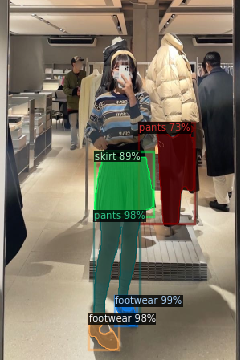

145 372 171 406
111 393 147 437
117 264 174 399
118 191 191 268
196 156 242 279
('1675525', '25574997', '2022.02.23', 'https://image.msscdn.net/data/estimate/1675525_0/gallery_6215fa8425ff3.jpg', '003', '003008', '1675525', 'https://image.msscdn.net/images/goods_img/20201103/1675525/1675525_3_500.jpg')


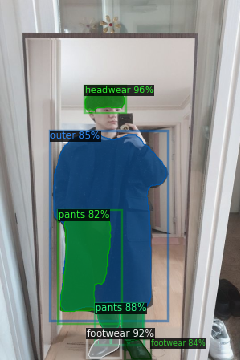

106 109 155 140
110 413 149 447
121 380 178 429
67 165 207 389
156 424 188 448
75 270 138 389
('1178390', '14929943', '2021.02.10', 'https://image.msscdn.net/data/estimate/1178390_0/gallery_6023c08ad32e1.jpg', '001', '001002', '1178390', 'https://image.msscdn.net/images/goods_img/20191007/1178390/1178390_2_500.jpg')


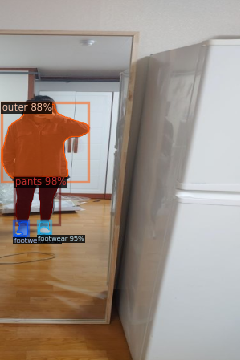

19 222 74 278
48 277 63 294
2 130 110 223
18 277 34 296
('1139099', '30199134', '2022.07.08', 'https://image.msscdn.net/data/estimate/1139099_0/gallery_62c81d497ceba.jpg', '001', '001006', '1139099', 'https://image.msscdn.net/images/goods_img/20190902/1139099/1139099_6_500.jpg')


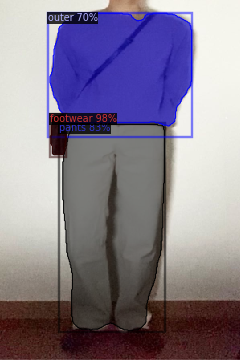

63 143 82 193
78 155 205 413
62 16 239 157
('1638610', '19149918', '2021.08.20', 'https://image.msscdn.net/data/estimate/1638610_0/gallery_611fb45de273f.jpg', '003', '003002', '1638610', 'https://image.msscdn.net/images/goods_img/20201007/1638610/1638610_1_500.jpg')


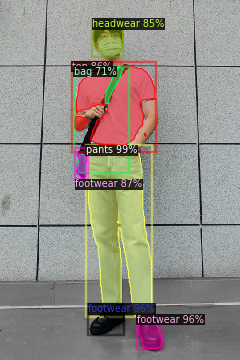

108 182 189 395
112 380 154 417
173 394 202 435
95 188 109 222
93 81 193 181
116 24 153 69
97 84 154 215
('1491644', '29030903', '2022.06.04', 'https://image.msscdn.net/data/estimate/1491644_0/gallery_629b23d7b67b0.jpg', '001', '001001', '1491644', 'https://image.msscdn.net/images/goods_img/20200619/1491644/1491644_2_500.jpg')


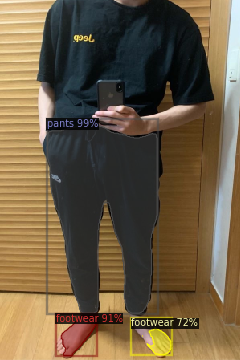

59 151 196 391
76 393 120 444
172 409 213 443
('2322559', '35517449', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2322559_0/gallery_637c634744b0d.jpg', '003', '003002', '2322559', 'https://image.msscdn.net/images/goods_img/20220124/2322559/2322559_1_500.jpg')


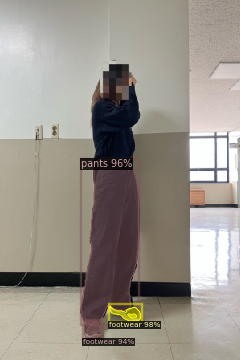

137 382 175 401
101 199 173 405
105 401 125 423
('1312044', '17252107', '2021.06.05', 'https://image.msscdn.net/data/estimate/1312044_0/gallery_60bae40a34edb.jpg', '003', '003008', '1312044', 'https://image.msscdn.net/images/goods_img/20200219/1312044/1312044_2_500.jpg')


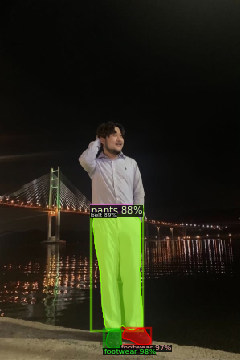

132 412 151 435
153 410 188 431
114 257 164 264
116 263 177 412
('565940', '6078113', '2019.09.05', 'https://image.msscdn.net/data/estimate/565940_0/gallery_5d6fe00e5a786.jpg', '001', '001002', '565940', 'https://image.msscdn.net/images/goods_img/20170529/565940/565940_1_500.jpg')


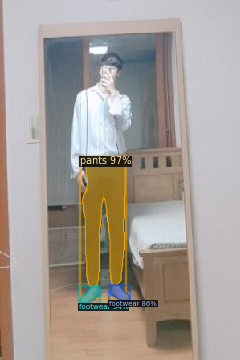

103 196 156 358
100 358 123 379
137 356 161 375
('2171624', '24612601', '2022.01.25', 'https://image.msscdn.net/data/estimate/2171624_0/gallery_61efdded9d21d.jpg', '003', '003006', '2171624', 'https://image.msscdn.net/images/goods_img/20211011/2171624/2171624_1_500.jpg')


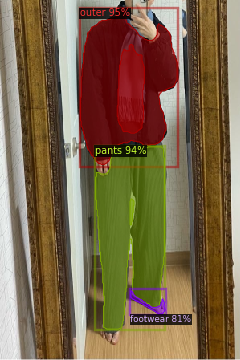

100 12 221 205
119 183 205 411
163 363 206 392
('1920528', '26889435', '2022.04.03', 'https://image.msscdn.net/data/estimate/1920528_0/gallery_6248af000691b.jpg', '003', '003004', '1920528', 'https://image.msscdn.net/images/goods_img/20210426/1920528/1920528_1_500.jpg')


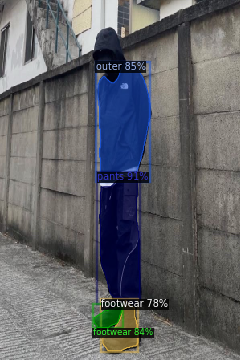

124 221 174 378
122 78 187 226
117 383 152 409
128 375 172 438
('1568050', '11891585', '2020.09.25', 'https://image.msscdn.net/data/estimate/1568050_0/gallery_5f6df1a7b5d6f.jpg', '005', '005011', '1568050', 'https://image.msscdn.net/images/goods_img/20200828/1568050/1568050_6_500.jpg')


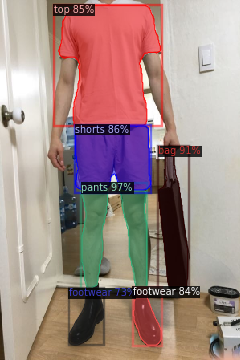

102 234 183 360
198 185 234 361
94 157 188 237
73 6 200 157
166 359 201 431
86 360 129 430
('2540758', '29012054', '2022.06.04', 'https://image.msscdn.net/data/estimate/2540758_0/gallery_629a6c76c371d.jpg', '001', '001001', '2540758', 'https://image.msscdn.net/images/goods_img/20220504/2540758/2540758_1_500.jpg')


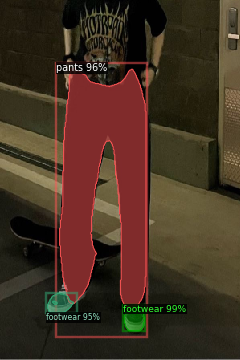

155 382 180 413
74 85 182 383
59 366 92 390
('2418549', '29607720', '2022.06.21', 'https://image.msscdn.net/data/estimate/2418549_0/gallery_62b1b6276650a.jpg', '003', '003002', '2418549', 'https://image.msscdn.net/images/goods_img/20220315/2418549/2418549_1_500.jpg')


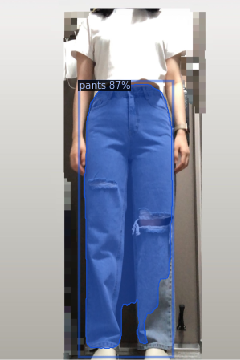

105 105 215 435
('1391961', '9770080', '2020.05.20', 'https://image.msscdn.net/data/estimate/1391961_0/gallery_5ec4ddeabbd8a.jpg', '003', '003009', '1391961', 'https://image.msscdn.net/images/goods_img/20200409/1391961/1391961_1_500.jpg')


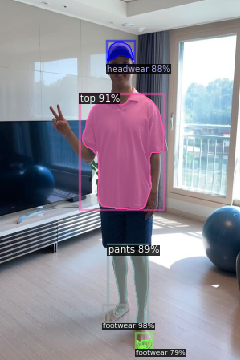

130 385 159 403
103 117 204 261
139 307 184 406
134 52 166 76
171 424 188 436


HTTPError: ignored

In [ ]:
## Major_category 001,003,005 query에서 Random하게 뽑고 OD Result 확인

from skimage import io
import cv2


for j in test[:300]:

  i_rev = io.imread(j[3])
  if len(i_rev.shape) > 2 and i_rev.shape[2] == 4:
    #slice off the alpha channel
    i_rev = i_rev[:, :, :3]
  i_rev = cv2.resize(i_rev, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  
  
  out_rev = predictor(i_rev)

  v_rev = Visualizer(i_rev[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  
      )
  
  print(j[:])
  v_rev = v_rev.draw_instance_predictions(out_rev["instances"].to("cpu"))

  a = cv2_imshow(v_rev.get_image()[:, :, ::])

  # # crop img
  from re import I
  from PIL import Image


  masks_rev = np.asarray(out_rev["instances"].pred_masks.to("cpu"))
 # print(masks_rev)
  for j in range(masks_rev.shape[0]): # 마스크 수만큼 돌아가나 보군군
 #   bbox_result_list= list()
    item_mask_rev = masks_rev[j]

    segmentation = np.where(item_mask_rev == True)
    x_min = np.min(segmentation[1])
    x_max = np.max(segmentation[1])
    y_min = np.min(segmentation[0])
    y_max = np.max(segmentation[0])
    print(x_min, y_min,x_max, y_max)

  # for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
  #   item_mask_sam = masks_sam[j]

  #   segmentation = np.where(item_mask_sam == True)
  #   x_min = np.min(segmentation[1])
  #   x_max = np.max(segmentation[1])
  #   y_min = np.min(segmentation[0])
  #   y_max = np.max(segmentation[0])
  #   print(x_min, y_min,x_max, y_max)

    cropped = Image.fromarray(i_rev[y_min:y_max, x_min:x_max, :], mode='RGB')
  #  print(cropped)
    
 

   # mask_rev = Image.fromarray((item_mask_rev * 255).astype('float32'))


    # cropped_mask_sam = mask_sam.crop((x_min, y_min, x_max, y_max))
    # bg = np.full((450, 300, 3), 255, np.float32) # 흰색배경
    # # bg = np.zeros((450, 300, 3), np.float32) # 검정색 배경
    # background = Image.fromarray(bg, mode='RGB')
    # paste_position = (100,150)

    # new_fg_image = Image.new('RGB', background.size)
    # new_fg_image.paste(cropped, paste_position)

    # new_alpha_mask = Image.new("L", background.size, color = 0)
    # new_alpha_mask.paste(cropped_mask_sam, paste_position)

    # composite = Image.composite(new_fg_image, background, new_alpha_mask)


    # composite_array = np.array(composite)
    # nonzero_composite_array = np.nonzero(composite_array)
    # np_av = np.average(nonzero_composite_array)
    # print(np_av)
  

    # masks_sam, masks_rev 
    # masks_sam의 item_num이 해당 클래스인 것만 저장. cropped img 
    # masks_rev의 item_num, url, reviewId, -> 별도 DB 생성. 일단 딕셔너리나 리스트로 뽑아 두기.


    # cv2_imshow(np.array(composite))
    # item_num = out_sam['instances'].pred_classes[j].item()
    # if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
    #   cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
    # elif item_num == 7 or item_num == 10:
    #   cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
    # else:
    #   cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


('2176899', '36366325', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2176899_0/gallery_638d91df5451a.jpg', '003', '003008', '2176899', 'https://image.msscdn.net/images/goods_img/20211014/2176899/2176899_1_500.jpg')


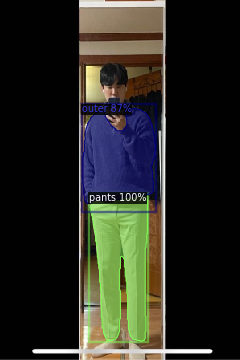

113 242 184 426
103 134 194 254
('2614111', '31255974', '2022.08.11', 'https://image.msscdn.net/data/estimate/2614111_0/gallery_62f47e689eb95.jpg', '001', '001011', '2614111', 'https://image.msscdn.net/images/goods_img/20220614/2614111/2614111_1_500.jpg')


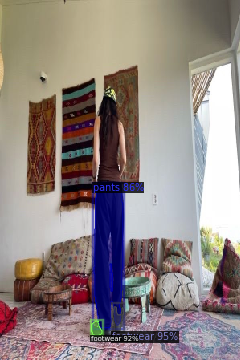

140 383 154 414
114 401 127 419
117 228 153 409
('2723767', '34687041', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2723767_0/gallery_636b1b970a992.jpg', '001', '001006', '2723767', 'https://image.msscdn.net/images/goods_img/20220818/2723767/2723767_8_500.jpg')


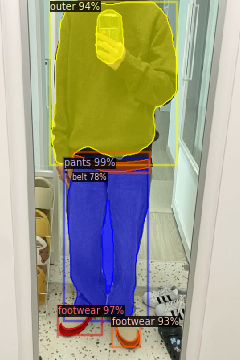

84 200 184 398
74 386 126 418
64 2 220 204
140 396 173 433
91 194 186 214
('1333322', '19929228', '2021.09.20', 'https://image.msscdn.net/data/estimate/1333322_0/gallery_614857447652a.jpg', '003', '003004', '1333322', 'https://image.msscdn.net/images/goods_img/20200304/1333322/1333322_2_500.jpg')


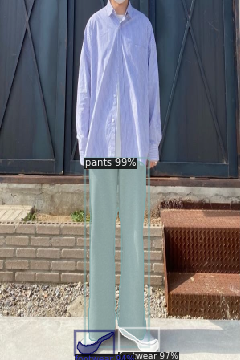

110 199 181 425
149 410 197 439
96 415 141 442
('2760338', '34490373', '2022.11.04', 'https://image.msscdn.net/data/estimate/2760338_0/gallery_6364e6ab650d2.jpg', '003', '003004', '2760338', 'https://image.msscdn.net/images/goods_img/20220831/2760338/2760338_1_500.jpg')


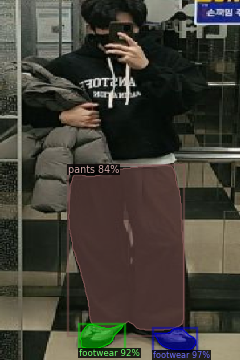

193 411 244 437
100 405 153 435
85 206 229 412
('2482740', '29908887', '2022.06.30', 'https://image.msscdn.net/data/estimate/2482740_0/gallery_62bd268ae1a44.jpg', '003', '003009', '2482740', 'https://image.msscdn.net/images/goods_img/20220412/2482740/2482740_1_500.jpg')


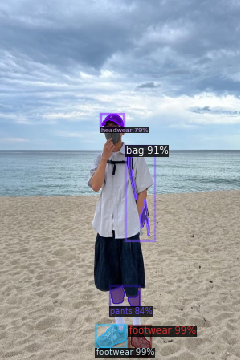

121 406 156 434
163 408 187 444
160 187 186 294
138 358 174 383
127 143 153 157
('1778391', '26736323', '2022.03.29', 'https://image.msscdn.net/data/estimate/1778391_0/gallery_6242c38b93b1f.jpg', '003', '003004', '1778391', 'https://image.msscdn.net/images/goods_img/20210204/1778391/1778391_1_500.jpg')


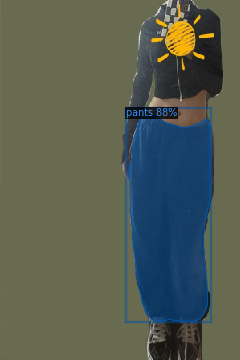

160 143 262 401
('2332833', '33732825', '2022.10.17', 'https://image.msscdn.net/data/estimate/2332833_0/gallery_634d615e71f70.jpg', '003', '003007', '2332833', 'https://image.msscdn.net/images/goods_img/20220127/2332833/2332833_1_500.jpg')


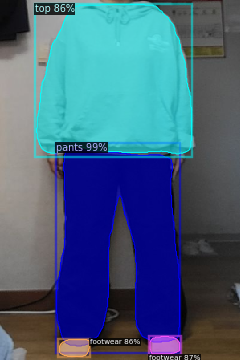

70 185 224 432
187 420 224 442
45 5 239 192
74 424 111 445
('1438728', '18512719', '2021.07.24', 'https://image.msscdn.net/data/estimate/1438728_0/gallery_60fb91a0966f8.jpg', '005', '005004', '1438728', 'https://image.msscdn.net/images/goods_img/20200511/1438728/1438728_2_500.jpg')


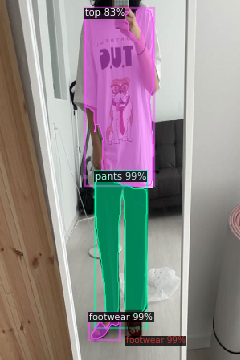

119 215 183 395
114 391 148 423
158 391 175 419
106 12 191 231
('1994358', '29473475', '2022.06.17', 'https://image.msscdn.net/data/estimate/1994358_0/gallery_62ac3998a8fb2.jpg', '001', '001001', '1994358', 'https://image.msscdn.net/images/goods_img/20210614/1994358/1994358_1_500.jpg')


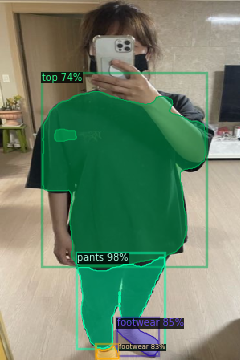

97 321 205 435
146 399 198 444
120 432 148 448
53 114 256 332
('2680807', '33362973', '2022.10.09', 'https://image.msscdn.net/data/estimate/2680807_0/gallery_63428706d8a0d.jpg', '001', '001006', '2680807', 'https://image.msscdn.net/images/goods_img/20220725/2680807/2680807_2_500.jpg')


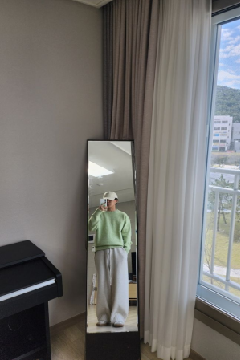

('1571486', '15135740', '2021.02.21', 'https://image.msscdn.net/data/estimate/1571486_0/gallery_6032310d9c459.jpg', '001', '001004', '1571486', 'https://image.msscdn.net/images/goods_img/20200831/1571486/1571486_8_500.jpg')


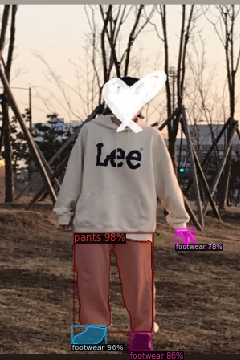

93 293 190 414
91 408 131 430
163 416 187 439
221 288 241 304
('2771238', '35206048', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2771238_0/gallery_6376c7ff52d4f.jpg', '003', '003006', '2771238', 'https://image.msscdn.net/images/goods_img/20220905/2771238/2771238_1_500.jpg')


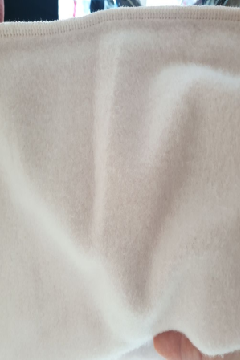

('2064577', '33938389', '2022.10.22', 'https://image.msscdn.net/data/estimate/2064577_0/gallery_6353419f9488a.jpg', '001', '001005', '2064577', 'https://image.msscdn.net/images/goods_img/20210813/2064577/2064577_1_500.jpg')


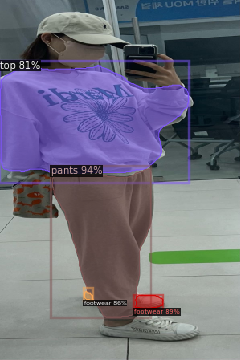

65 211 188 396
169 369 203 385
105 363 116 375
0 81 235 216
('1753986', '16626507', '2021.05.06', 'https://image.msscdn.net/data/estimate/1753986_0/gallery_609363b2a2161.jpg', '003', '003007', '1753986', 'https://image.msscdn.net/images/goods_img/20210119/1753986/1753986_4_500.jpg')


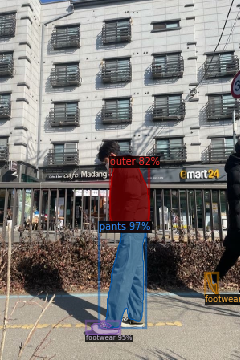

131 281 181 409
108 401 148 418
257 341 271 368
137 196 186 284
('1812133', '20616040', '2021.10.13', 'https://image.msscdn.net/data/estimate/1812133_0/gallery_616617d7b33a1.jpg', '003', '003008', '1812133', 'https://image.msscdn.net/images/goods_img/20210224/1812133/1812133_1_500.jpg')


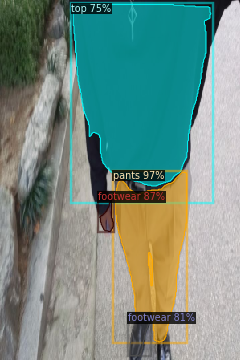

144 215 233 427
124 245 141 289
162 392 187 444
91 5 263 232
('2581397', '34888613', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2581397_0/gallery_6371897516715.jpg', '001', '001011', '2581397', 'https://image.msscdn.net/images/goods_img/20220525/2581397/2581397_1_500.jpg')


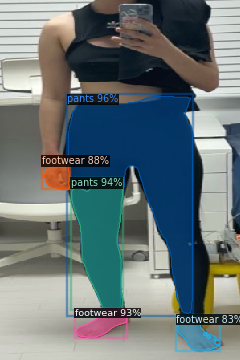

85 120 240 391
89 223 153 387
95 386 158 421
53 196 87 236
222 394 273 437
('1867554', '30147292', '2022.07.07', 'https://image.msscdn.net/data/estimate/1867554_0/gallery_62c637199054e.jpg', '003', '003002', '1867554', 'https://image.msscdn.net/images/goods_img/20210329/1867554/1867554_1_500.jpg')


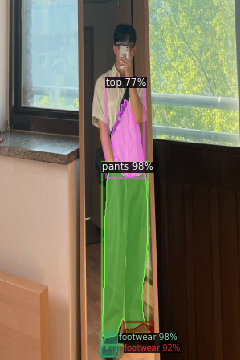

126 417 147 445
128 209 184 422
156 404 190 429
139 124 178 220
('2404955', '27097563', '2022.04.09', 'https://image.msscdn.net/data/estimate/2404955_0/gallery_6251498e45fe6.jpg', '001', '001001', '2404955', 'https://image.msscdn.net/images/goods_img/20220308/2404955/2404955_1_500.jpg')


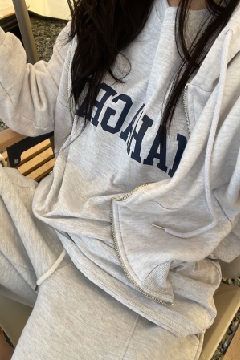

('1749098', '15176430', '2021.02.23', 'https://image.msscdn.net/data/estimate/1749098_0/gallery_6034ead184e7b.jpg', '003', '003002', '1749098', 'https://image.msscdn.net/images/goods_img/20210114/1749098/1749098_2_500.jpg')


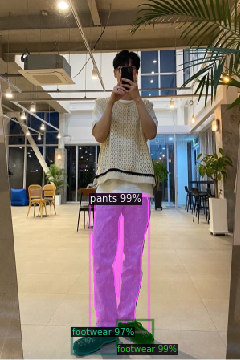

147 402 190 430
115 242 185 414
92 410 146 441
('1887256', '18150496', '2021.07.09', 'https://image.msscdn.net/data/estimate/1887256_0/gallery_60e7ef43e86b6.jpg', '003', '003007', '1887256', 'https://image.msscdn.net/images/goods_img/20210408/1887256/1887256_1_500.jpg')


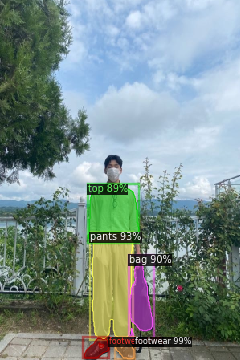

105 422 135 447
144 423 167 448
115 291 165 423
162 327 190 422
110 231 173 302
('2541132', '31162567', '2022.08.08', 'https://image.msscdn.net/data/estimate/2541132_0/gallery_62f05ec394049.jpg', '003', '003009', '2541132', 'https://image.msscdn.net/images/goods_img/20220504/2541132/2541132_1_500.jpg')


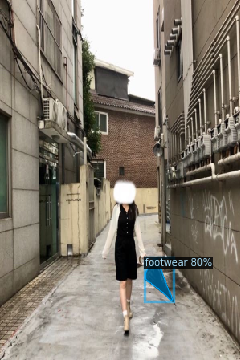

181 323 215 375
('1753542', '28922900', '2022.06.01', 'https://image.msscdn.net/data/estimate/1753542_0/gallery_62970e6918f8a.jpg', '003', '003002', '1753542', 'https://image.msscdn.net/images/goods_img/20210119/1753542/1753542_3_500.jpg')


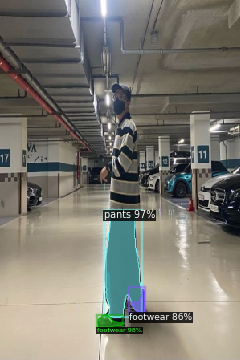

122 393 153 409
132 263 177 396
164 361 180 390
('466299', '6245838', '2019.09.18', 'https://image.msscdn.net/data/estimate/466299_0/gallery_5d810a478e595.jpg', '003', '003002', '466299', 'https://image.msscdn.net/images/goods_img/20161222/466299/466299_10_500.jpg')


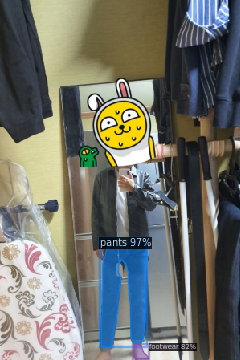

126 299 183 433
167 430 185 448
('2472412', '27989522', '2022.05.05', 'https://image.msscdn.net/data/estimate/2472412_0/gallery_627398df61769.jpg', '001', '001001', '2472412', 'https://image.msscdn.net/images/goods_img/20220407/2472412/2472412_1_500.jpg')


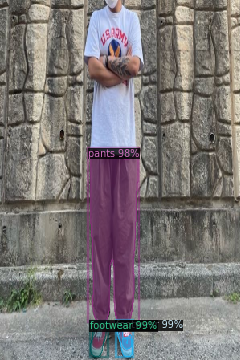

145 401 165 445
113 402 134 445
113 187 172 401
('1446485', '26494320', '2022.03.22', 'https://image.msscdn.net/data/estimate/1446485_0/gallery_6238b01eb97fc.jpg', '001', '001010', '1446485', 'https://image.msscdn.net/images/goods_img/20200514/1446485/1446485_3_500.jpg')


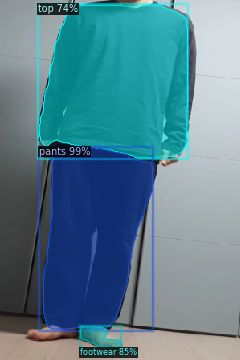

54 183 190 411
100 408 151 434
49 6 234 197
('1058699', '11625862', '2020.09.12', 'https://image.msscdn.net/data/estimate/1058699_0/gallery_5f5c2e81a15a2.jpg', '003', '003009', '1058699', 'https://image.msscdn.net/images/goods_img/20190529/1058699/1058699_7_500.jpg')


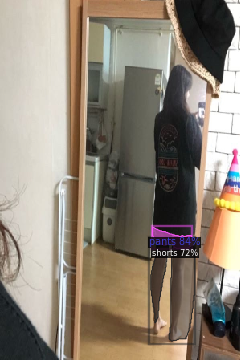

188 305 243 426
190 284 239 310
('2703608', '33053282', '2022.10.02', 'https://image.msscdn.net/data/estimate/2703608_0/gallery_633889a6dc15e.jpg', '003', '003002', '2703608', 'https://image.msscdn.net/images/goods_img/20220808/2703608/2703608_3_500.jpg')


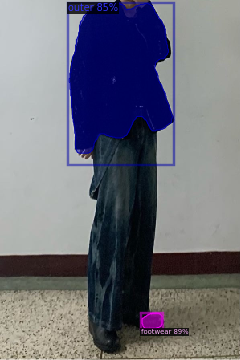

177 391 202 410
86 4 215 191
('2092162', '34996927', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2092162_0/gallery_63737915c8e92.jpg', '001', '001010', '2092162', 'https://image.msscdn.net/images/goods_img/20210826/2092162/2092162_2_500.jpg')


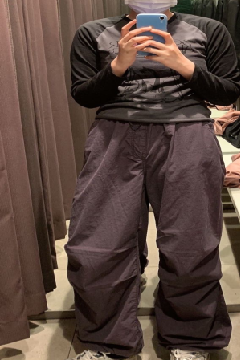

('2268150', '26416275', '2022.03.19', 'https://image.msscdn.net/data/estimate/2268150_0/gallery_623593b905324.jpg', '001', '001002', '2268150', 'https://image.msscdn.net/images/goods_img/20211214/2268150/2268150_2_500.jpg')


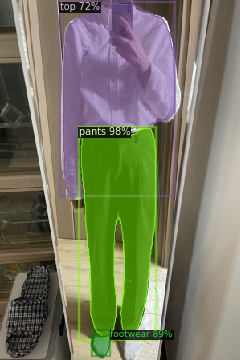

101 160 194 421
115 416 137 444
79 4 218 243
('2246751', '35739834', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2246751_0/gallery_637f60bd7e8d4.jpg', '005', '005005', '2246751', 'https://image.msscdn.net/images/goods_img/20211124/2246751/2246751_1_500.jpg')


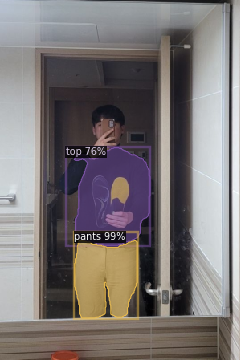

93 300 171 397
92 184 187 306
('1622019', '23530061', '2021.12.19', 'https://image.msscdn.net/data/estimate/1622019_0/gallery_61bf40c500ef8.jpg', '001', '001004', '1622019', 'https://image.msscdn.net/images/goods_img/20200924/1622019/1622019_6_500.jpg')


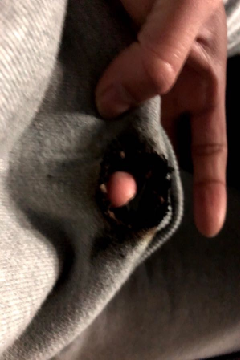

('2492545', '30938423', '2022.07.31', 'https://image.msscdn.net/data/estimate/2492545_0/gallery_62e57142e4a3d.jpg', '001', '001006', '2492545', 'https://image.msscdn.net/images/goods_img/20220415/2492545/2492545_1_500.jpg')


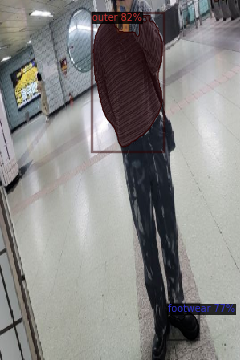

116 19 202 183
211 385 247 423
('2686229', '32702465', '2022.09.22', 'https://image.msscdn.net/data/estimate/2686229_0/gallery_632c40e5a6df1.jpg', '003', '003006', '2686229', 'https://image.msscdn.net/images/goods_img/20220728/2686229/2686229_7_500.jpg')


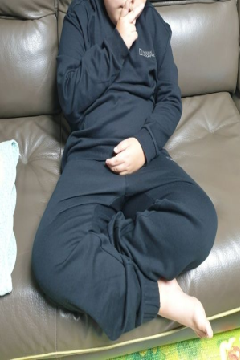

('2811528', '33693301', '2022.10.17', 'https://image.msscdn.net/data/estimate/2811528_0/gallery_634c1f874991a.jpg', '001', '001006', '2811528', 'https://image.msscdn.net/images/goods_img/20220922/2811528/2811528_1_500.jpg')


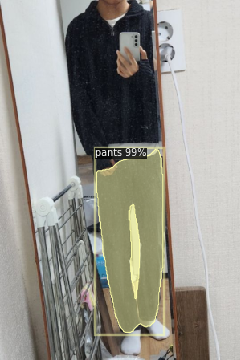

120 186 203 415
('2411106', '32652575', '2022.09.21', 'https://image.msscdn.net/data/estimate/2411106_0/gallery_632ab2248b282.jpg', '001', '001008', '2411106', 'https://image.msscdn.net/images/goods_img/20220311/2411106/2411106_7_500.jpg')


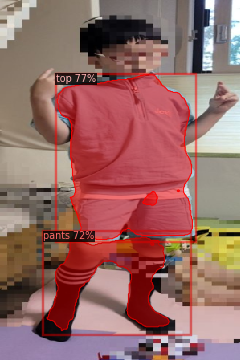

71 93 240 299
58 296 211 413
('1793971', '19944690', '2021.09.21', 'https://image.msscdn.net/data/estimate/1793971_0/gallery_6149c644b3521.jpg', '001', '001006', '1793971', 'https://image.msscdn.net/images/goods_img/20210215/1793971/1793971_2_500.jpg')


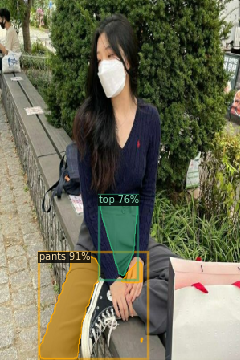

49 316 178 448
125 245 171 344
('1125810', '9086055', '2020.04.08', 'https://image.msscdn.net/data/estimate/1125810_0/gallery_5e8ca1b687f01.jpg', '001', '001005', '1125810', 'https://image.msscdn.net/images/goods_img/20190822/1125810/1125810_1_500.jpg')


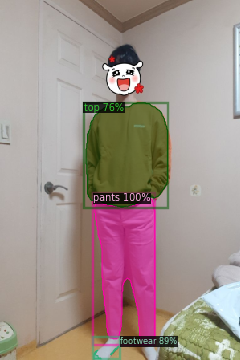

118 247 193 430
117 432 148 448
107 128 209 258
('1009492', '5182638', '2019.06.17', 'https://image.msscdn.net/data/estimate/1009492_0/gallery_5d07019fde711.jpg', '001', '001001', '1009492', 'https://image.msscdn.net/images/goods_img/20190410/1009492/1009492_3_500.jpg')


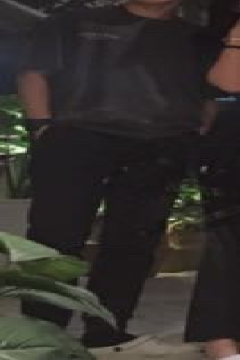

('1942916', '29364897', '2022.06.14', 'https://image.msscdn.net/data/estimate/1942916_0/gallery_62a8814f3f8b3.jpg', '003', '003007', '1942916', 'https://image.msscdn.net/images/goods_img/20210510/1942916/1942916_3_500.jpg')


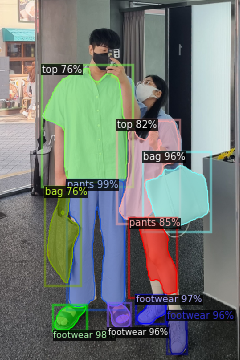

86 225 155 383
68 382 107 412
171 370 207 404
209 390 233 442
182 206 260 285
135 380 162 409
173 276 220 367
149 151 224 274
59 239 98 353
54 85 158 228
('404950', '9190493', '2020.04.15', 'https://image.msscdn.net/data/estimate/404950_0/gallery_5e962a03083e5.jpg', '003', '003004', '404950', 'https://image.msscdn.net/images/goods_img/20160902/404950/404950_2_500.jpg')


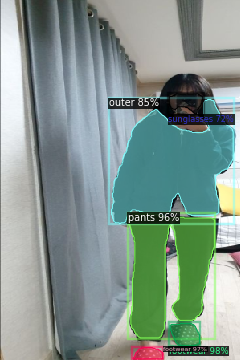

212 404 249 432
166 434 203 448
161 267 268 422
139 124 291 279
211 117 253 142
('2390729', '28392367', '2022.05.17', 'https://image.msscdn.net/data/estimate/2390729_0/gallery_6282833e98374.jpg', '001', '001010', '2390729', 'https://image.msscdn.net/images/goods_img/20220302/2390729/2390729_2_500.jpg')


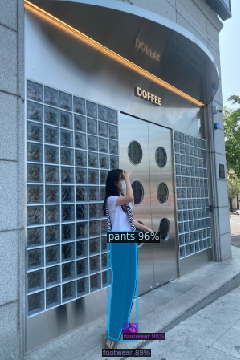

155 407 170 416
135 290 170 424
130 423 143 437
('1536609', '14349744', '2021.01.07', 'https://image.msscdn.net/data/estimate/1536609_0/gallery_5ff657a5aa91d.jpg', '001', '001010', '1536609', 'https://image.msscdn.net/images/goods_img/20200804/1536609/1536609_3_500.jpg')


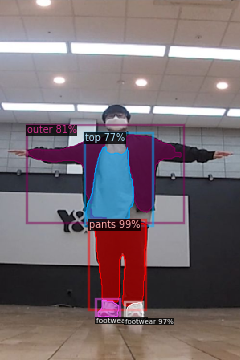

114 276 182 382
122 375 148 396
158 378 178 397
35 168 226 272
107 183 166 277
('2450066', '32436046', '2022.09.15', 'https://image.msscdn.net/data/estimate/2450066_0/gallery_63233869c646a.jpg', '003', '003009', '2450066', 'https://image.msscdn.net/images/goods_img/20220328/2450066/2450066_1_500.jpg')


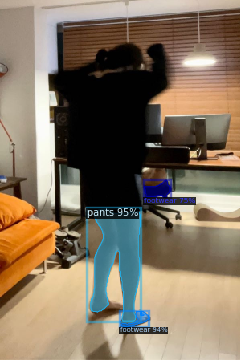

113 261 175 401
151 389 186 408
180 225 212 246
('2296983', '26921165', '2022.04.04', 'https://image.msscdn.net/data/estimate/2296983_0/gallery_624a4ddb61473.jpg', '001', '001002', '2296983', 'https://image.msscdn.net/images/goods_img/20220107/2296983/2296983_4_500.jpg')


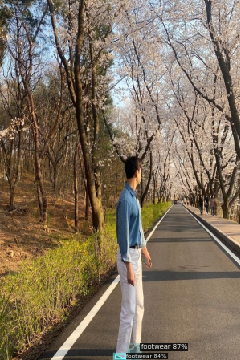

161 431 175 448
144 443 157 448
('1556005', '16147058', '2021.04.11', 'https://image.msscdn.net/data/estimate/1556005_0/gallery_60728983e42ee.jpg', '005', '005011', '1556005', 'https://image.msscdn.net/images/goods_img/20200819/1556005/1556005_1_500.jpg')


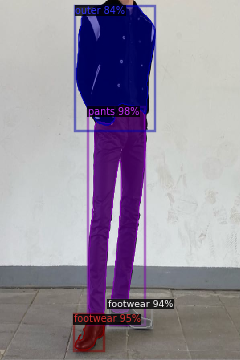

111 134 181 399
93 393 129 437
137 375 189 409
95 7 193 156
('1336714', '13777066', '2020.12.10', 'https://image.msscdn.net/data/estimate/1336714_0/gallery_5fd206eb13100.jpg', '001', '001010', '1336714', 'https://image.msscdn.net/images/goods_img/20200305/1336714/1336714_3_500.jpg')


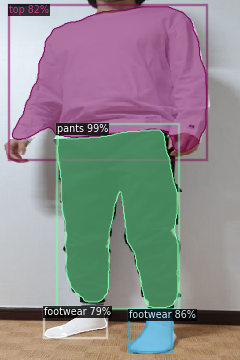

71 162 222 384
162 388 214 439
15 8 258 190
56 384 133 421
('2124439', '28098423', '2022.05.08', 'https://image.msscdn.net/data/estimate/2124439_0/gallery_6277d85a941c8.jpg', '003', '003008', '2124439', 'https://image.msscdn.net/images/goods_img/20210910/2124439/2124439_1_500.jpg')


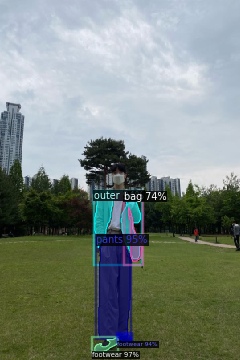

118 422 146 439
123 294 162 422
118 238 175 323
147 418 163 426
160 259 177 326
('2568744', '33775613', '2022.10.18', 'https://image.msscdn.net/data/estimate/2568744_0/gallery_634e987a945ab.jpg', '003', '003008', '2568744', 'https://image.msscdn.net/images/goods_img/20220518/2568744/2568744_1_500.jpg')


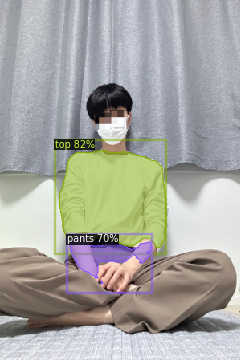

74 188 207 309
87 295 188 364
('2476545', '35563299', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2476545_0/gallery_637cd1f1272f1.jpg', '003', '003006', '2476545', 'https://image.msscdn.net/images/goods_img/20220408/2476545/2476545_1_500.jpg')


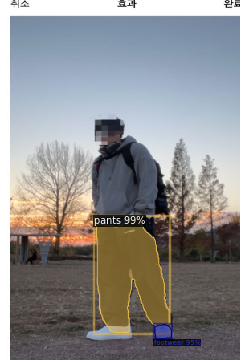

120 271 211 415
193 405 214 423
('877880', '5569502', '2019.07.23', 'https://image.msscdn.net/data/estimate/877880_0/gallery_5d3606ff90934.jpg', '001', '001010', '877880', 'https://image.msscdn.net/images/goods_img/20181011/877880/877880_1_500.jpg')


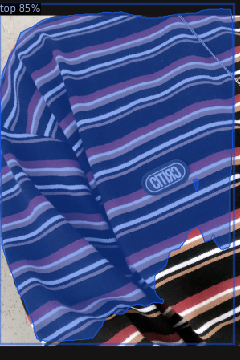

0 10 291 426
('1713163', '36331293', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/1713163_0/gallery_638c9c14be91d.jpg', '001', '001005', '1713163', 'https://image.msscdn.net/images/goods_img/20201203/1713163/1713163_1_500.jpg')


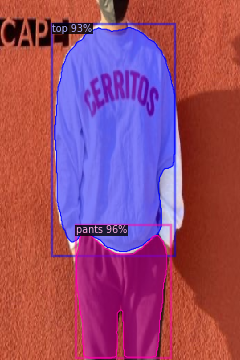

95 289 208 447
68 34 218 314
('2718818', '34209193', '2022.10.28', 'https://image.msscdn.net/data/estimate/2718818_0/gallery_635b9d7d6710c.jpg', '001', '001006', '2718818', 'https://image.msscdn.net/images/goods_img/20220816/2718818/2718818_1_500.jpg')


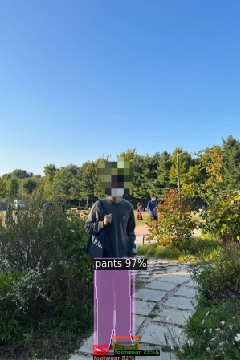

119 328 165 437
143 429 171 437
118 434 131 444
144 430 170 437
('2359607', '27528243', '2022.04.22', 'https://image.msscdn.net/data/estimate/2359607_0/gallery_62617d732dab4.jpg', '001', '001005', '2359607', 'https://image.msscdn.net/images/goods_img/20220215/2359607/2359607_1_500.jpg')


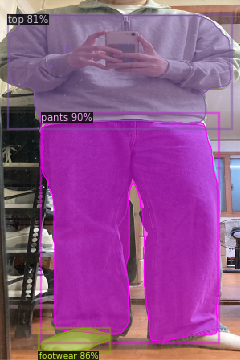

52 150 272 426
51 410 136 439
11 19 288 154
('2501076', '28873840', '2022.05.31', 'https://image.msscdn.net/data/estimate/2501076_0/gallery_6294ffc31cd22.jpg', '003', '003006', '2501076', 'https://image.msscdn.net/images/goods_img/20220419/2501076/2501076_1_500.jpg')


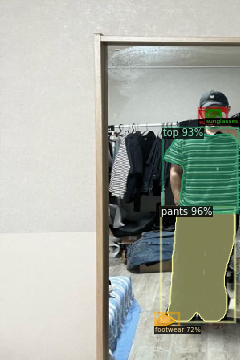

209 262 293 401
205 164 297 265
249 136 282 148
258 137 275 147
194 393 218 408
('1188313', '23460635', '2021.12.17', 'https://image.msscdn.net/data/estimate/1188313_0/gallery_61bc811989871.jpg', '003', '003004', '1188313', 'https://image.msscdn.net/images/goods_img/20191015/1188313/1188313_3_500.jpg')


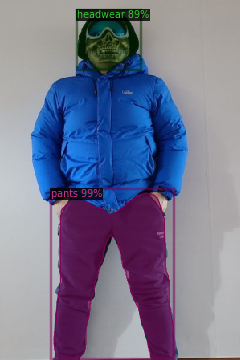

67 241 216 447
97 15 172 86
('1878233', '31603841', '2022.08.24', 'https://image.msscdn.net/data/estimate/1878233_0/gallery_6305859f47a32.jpg', '003', '003009', '1878233', 'https://image.msscdn.net/images/goods_img/20210402/1878233/1878233_1_500.jpg')


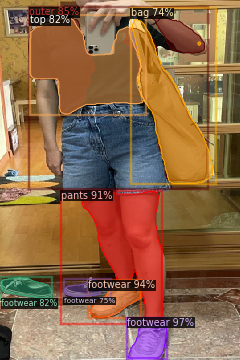

160 400 208 447
113 352 175 396
102 239 202 403
37 19 258 226
2 347 64 372
37 22 178 142
80 349 137 370
165 24 265 229
('2374950', '33159769', '2022.10.04', 'https://image.msscdn.net/data/estimate/2374950_0/gallery_633c4733695e0.jpg', '005', '005004', '2374950', 'https://image.msscdn.net/images/goods_img/20220221/2374950/2374950_1_500.jpg')


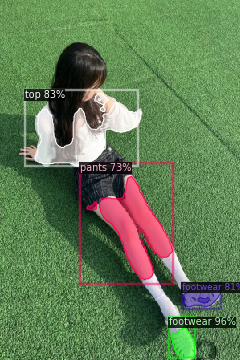

213 408 243 446
44 116 171 206
229 356 275 383
108 220 215 349
('1112845', '26119004', '2022.03.11', 'https://image.msscdn.net/data/estimate/1112845_0/gallery_622b0f4c054d3.jpg', '003', '003004', '1112845', 'https://image.msscdn.net/images/goods_img/20190807/1112845/1112845_1_500.jpg')


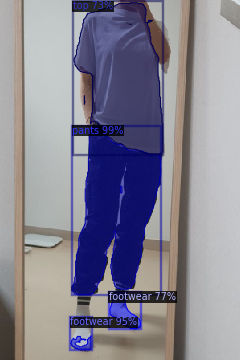

91 157 200 368
88 397 113 436
137 365 175 410
92 3 203 192
('2307327', '26444344', '2022.03.20', 'https://image.msscdn.net/data/estimate/2307327_0/gallery_6236cd560d04a.jpg', '001', '001010', '2307327', 'https://image.msscdn.net/images/goods_img/20220113/2307327/2307327_1_500.jpg')


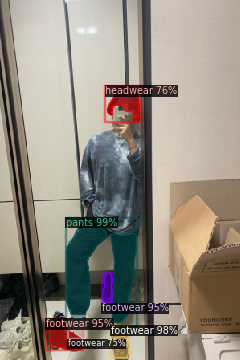

82 277 170 403
140 420 160 447
60 400 103 436
128 341 140 378
133 108 173 151
86 397 107 423
('684820', '15071908', '2021.02.18', 'https://image.msscdn.net/data/estimate/684820_0/gallery_602e592a4d223.jpg', '003', '003002', '684820', 'https://image.msscdn.net/images/goods_img/20171206/684820/684820_14_500.jpg')


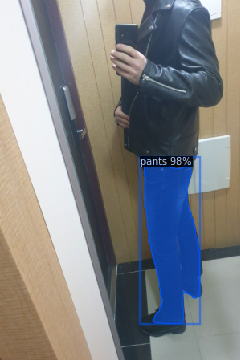

179 197 249 404
('2071326', '20683791', '2021.10.14', 'https://image.msscdn.net/data/estimate/2071326_0/gallery_616802f3badcb.jpg', '001', '001010', '2071326', 'https://image.msscdn.net/images/goods_img/20210819/2071326/2071326_1_500.jpg')


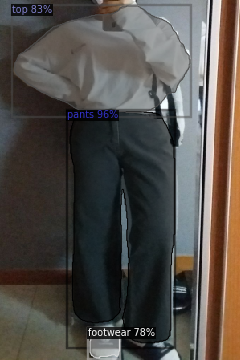

87 138 218 428
18 7 237 140
112 410 149 447
('971731', '15035906', '2021.02.17', 'https://image.msscdn.net/data/estimate/971731_0/gallery_602cd9e97551a.jpg', '001', '001001', '971731', 'https://image.msscdn.net/images/goods_img/20190305/971731/971731_1_500.jpg')


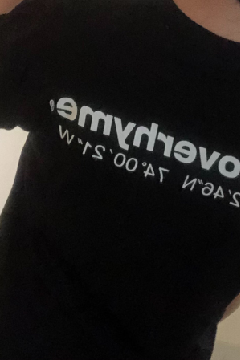

('1851969', '17291761', '2021.06.07', 'https://image.msscdn.net/data/estimate/1851969_0/gallery_60bd5d436034a.jpg', '003', '003008', '1851969', 'https://image.msscdn.net/images/goods_img/20210318/1851969/1851969_1_500.jpg')


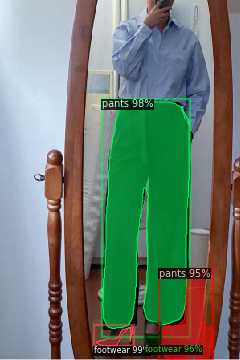

120 408 166 432
128 124 236 410
181 414 200 431
201 338 265 448
('1180386', '21430211', '2021.11.01', 'https://image.msscdn.net/data/estimate/1180386_0/gallery_617fdeb6d45d6.jpg', '003', '003006', '1180386', 'https://image.msscdn.net/images/goods_img/20191008/1180386/1180386_2_500.jpg')


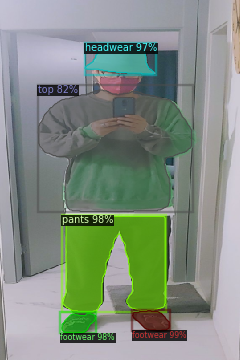

165 388 211 413
78 269 206 389
77 391 119 416
106 55 192 92
48 112 239 264
('1568043', '27908123', '2022.05.03', 'https://image.msscdn.net/data/estimate/1568043_0/gallery_627099b3b43d0.jpg', '005', '005015', '1568043', 'https://image.msscdn.net/images/goods_img/20200828/1568043/1568043_5_500.jpg')


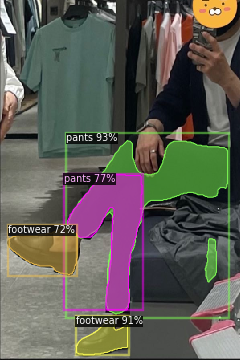

85 175 284 392
95 397 159 443
84 218 177 387
11 282 96 343
('947057', '26931194', '2022.04.04', 'https://image.msscdn.net/data/estimate/947057_0/gallery_624aad3e72f46.jpg', '003', '003009', '947057', 'https://image.msscdn.net/images/goods_img/20190201/947057/947057_3_500.jpg')


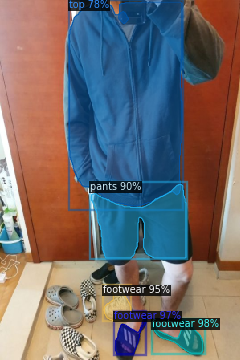

191 399 253 441
144 392 181 442
129 357 163 400
114 230 232 322
86 2 227 257
('2124224', '23259791', '2021.12.12', 'https://image.msscdn.net/data/estimate/2124224_0/gallery_61b5a37e23fce.jpg', '003', '003008', '2124224', 'https://image.msscdn.net/images/goods_img/20210910/2124224/2124224_2_500.jpg')


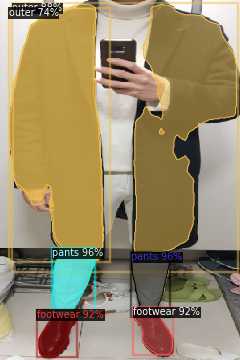

66 311 117 394
164 315 211 392
48 389 95 445
167 386 215 443
16 5 295 324
12 10 129 325
('2708883', '34654621', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2708883_0/gallery_636a266a874d8.jpg', '003', '003007', '2708883', 'https://image.msscdn.net/images/goods_img/20220810/2708883/2708883_3_500.jpg')


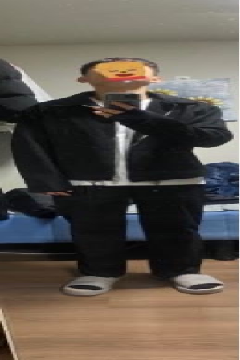

('1944546', '17210499', '2021.06.03', 'https://image.msscdn.net/data/estimate/1944546_0/gallery_60b8c32a40932.jpg', '003', '003002', '1944546', 'https://image.msscdn.net/images/goods_img/20210511/1944546/1944546_1_500.jpg')


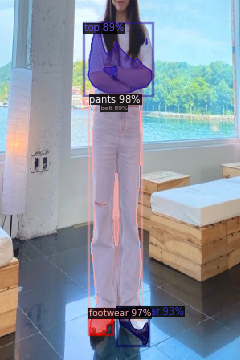

114 119 176 398
112 386 140 418
148 384 185 430
110 33 189 116
127 119 170 130
('2024948', '18914796', '2021.08.10', 'https://image.msscdn.net/data/estimate/2024948_0/gallery_61123d239b141.jpg', '003', '003008', '2024948', 'https://image.msscdn.net/images/goods_img/20210709/2024948/2024948_1_500.jpg')


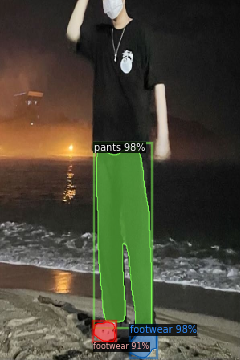

163 407 195 447
120 183 189 410
117 402 143 427
('2316067', '28827966', '2022.05.29', 'https://image.msscdn.net/data/estimate/2316067_0/gallery_629350cf9effc.jpg', '003', '003002', '2316067', 'https://image.msscdn.net/images/goods_img/20220119/2316067/2316067_1_500.jpg')


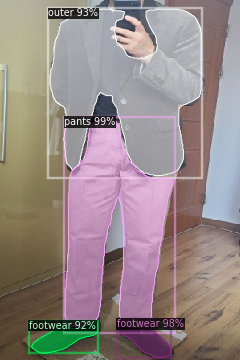

81 148 216 408
146 399 213 446
62 11 251 219
39 402 121 441
('1173380', '20513980', '2021.10.10', 'https://image.msscdn.net/data/estimate/1173380_0/gallery_61619ed9e8f4d.jpg', '001', '001005', '1173380', 'https://image.msscdn.net/images/goods_img/20191001/1173380/1173380_4_500.jpg')


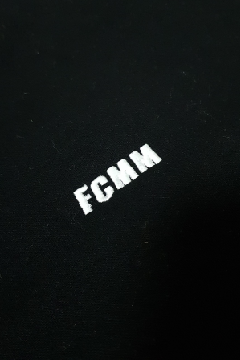

('2664733', '33379515', '2022.10.10', 'https://image.msscdn.net/data/estimate/2664733_0/gallery_6342ed2ae7aa5.jpg', '001', '001005', '2664733', 'https://image.msscdn.net/images/goods_img/20220714/2664733/2664733_1_500.jpg')


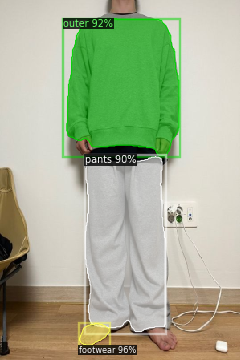

99 404 136 431
83 23 223 194
106 195 206 414
('2143706', '34905604', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2143706_0/gallery_6371d30d20598.jpg', '003', '003006', '2143706', 'https://image.msscdn.net/images/goods_img/20210923/2143706/2143706_1_500.jpg')


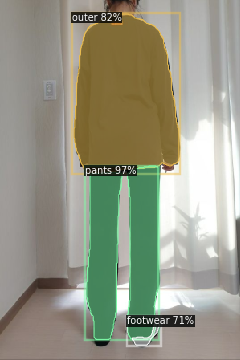

108 207 197 424
92 17 223 215
165 396 199 431
('880826', '9233273', '2020.04.18', 'https://image.msscdn.net/data/estimate/880826_0/gallery_5e99f2b8e7842.jpg', '003', '003008', '880826', 'https://image.msscdn.net/images/goods_img/20181015/880826/880826_3_500.jpg')


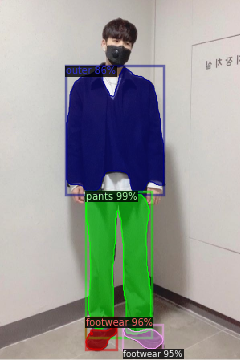

107 240 188 417
107 402 145 436
154 408 203 436
83 85 204 241
('2380557', '30999143', '2022.08.02', 'https://image.msscdn.net/data/estimate/2380557_0/gallery_62e8b71027169.jpg', '001', '001001', '2380557', 'https://image.msscdn.net/images/goods_img/20220223/2380557/2380557_1_500.jpg')


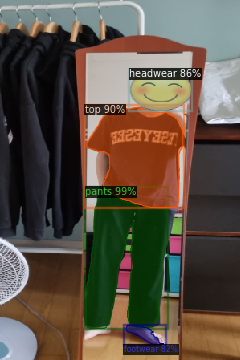

107 236 209 410
108 134 228 259
162 86 237 137
157 406 204 430
('1805599', '15872468', '2021.03.29', 'https://image.msscdn.net/data/estimate/1805599_0/gallery_6061e3aa61128.jpg', '003', '003002', '1805599', 'https://image.msscdn.net/images/goods_img/20210219/1805599/1805599_1_500.jpg')


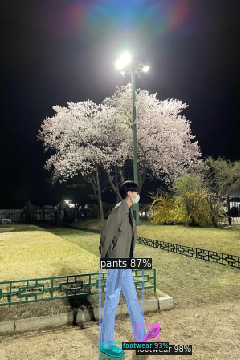

172 407 198 431
125 431 153 445
126 330 178 432
('1285087', '26513495', '2022.03.22', 'https://image.msscdn.net/data/estimate/1285087_0/gallery_62399ac7030d5.jpg', '003', '003008', '1285087', 'https://image.msscdn.net/images/goods_img/20200130/1285087/1285087_1_500.jpg')


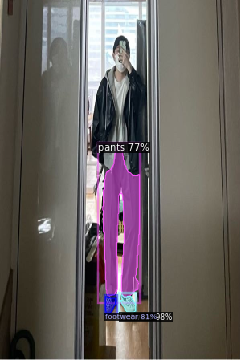

150 368 169 390
131 370 144 392
128 181 174 371
('1408179', '20498255', '2021.10.10', 'https://image.msscdn.net/data/estimate/1408179_0/gallery_6162e83494f4d.jpg', '001', '001003', '1408179', 'https://image.msscdn.net/images/goods_img/20200417/1408179/1408179_1_500.jpg')


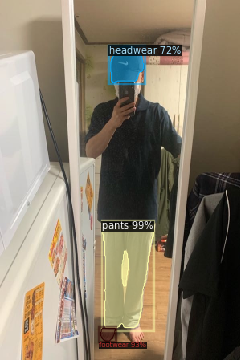

128 280 191 409
125 410 144 426
138 57 179 103
('2009035', '32185351', '2022.09.08', 'https://image.msscdn.net/data/estimate/2009035_0/gallery_6319e027bd8f1.jpg', '001', '001011', '2009035', 'https://image.msscdn.net/images/goods_img/20210624/2009035/2009035_4_500.jpg')


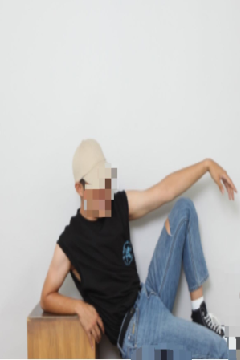

('1438728', '10076546', '2020.06.08', 'https://image.msscdn.net/data/estimate/1438728_0/gallery_5eddef7d2493c.jpg', '005', '005004', '1438728', 'https://image.msscdn.net/images/goods_img/20200511/1438728/1438728_2_500.jpg')


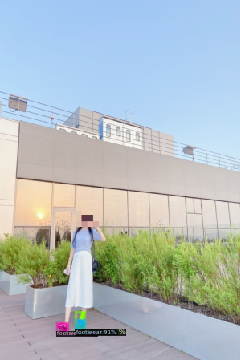

95 400 105 411
72 404 83 413
95 390 105 411
('2183727', '35441838', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2183727_0/gallery_637b055c87921.jpg', '003', '003007', '2183727', 'https://image.msscdn.net/images/goods_img/20211018/2183727/2183727_1_500.jpg')


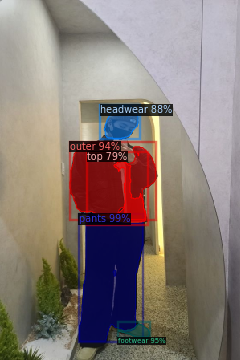

99 268 178 426
148 404 186 421
87 177 194 274
130 131 172 173
126 191 182 277
('1060006', '25561728', '2022.02.23', 'https://image.msscdn.net/data/estimate/1060006_0/gallery_6215b01bb10da.jpg', '001', '001001', '1060006', 'https://image.msscdn.net/images/goods_img/20190530/1060006/1060006_1_500.jpg')


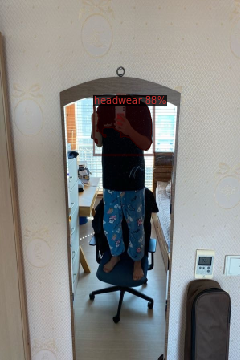

119 120 189 187
('2320530', '34624733', '2022.11.07', 'https://image.msscdn.net/data/estimate/2320530_0/gallery_636911c3691aa.jpg', '003', '003002', '2320530', 'https://image.msscdn.net/images/goods_img/20220121/2320530/2320530_1_500.jpg')


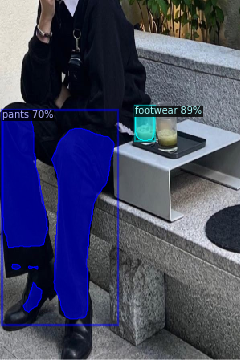

169 133 192 175
3 138 142 398
('1590214', '16120915', '2021.04.10', 'https://image.msscdn.net/data/estimate/1590214_0/gallery_60707d3596df7.jpg', '005', '005015', '1590214', 'https://image.msscdn.net/images/goods_img/20200908/1590214/1590214_1_500.jpg')


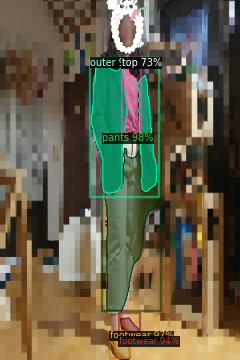

131 185 199 388
138 417 162 447
150 392 173 420
114 73 195 241
153 73 173 170
('2015007', '18911325', '2021.08.10', 'https://image.msscdn.net/data/estimate/2015007_0/gallery_61121dc3a171d.jpg', '005', '005004', '2015007', 'https://image.msscdn.net/images/goods_img/20210630/2015007/2015007_1_500.jpg')


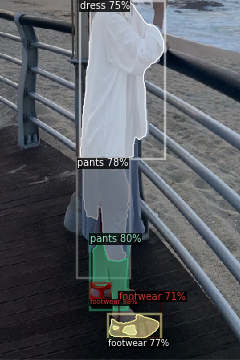

113 355 138 373
115 296 159 387
104 199 161 326
136 393 198 422
100 2 204 198
150 375 199 420
('1878233', '19991421', '2021.09.23', 'https://image.msscdn.net/data/estimate/1878233_0/gallery_614c681d2f539.jpg', '003', '003009', '1878233', 'https://image.msscdn.net/images/goods_img/20210402/1878233/1878233_1_500.jpg')


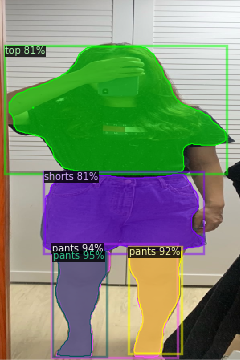

69 314 132 445
70 310 221 446
161 309 226 441
56 215 253 316
11 58 282 215
('2413475', '27353974', '2022.04.17', 'https://image.msscdn.net/data/estimate/2413475_0/gallery_625af67c9e9f2.jpg', '003', '003002', '2413475', 'https://image.msscdn.net/images/goods_img/20220311/2413475/2413475_3_500.jpg')


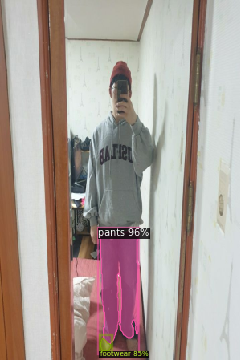

125 286 172 429
125 422 138 438
('2065940', '19328410', '2021.08.28', 'https://image.msscdn.net/data/estimate/2065940_0/gallery_612a1dfb05145.jpg', '001', '001004', '2065940', 'https://image.msscdn.net/images/goods_img/20210817/2065940/2065940_1_500.png')


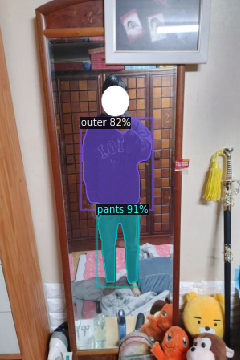

122 256 173 354
103 148 189 258
('2762794', '32538655', '2022.09.18', 'https://image.msscdn.net/data/estimate/2762794_0/gallery_6326c9fe1cf9f.jpg', '003', '003002', '2762794', 'https://image.msscdn.net/images/goods_img/20220901/2762794/2762794_2_500.jpg')


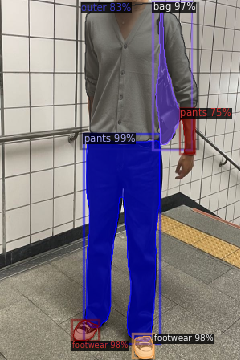

107 167 199 426
167 420 191 447
91 400 122 425
194 15 224 180
106 4 246 178
227 137 242 191
('2155926', '21195748', '2021.10.26', 'https://image.msscdn.net/data/estimate/2155926_0/gallery_6177e08b9d484.jpg', '001', '001010', '2155926', 'https://image.msscdn.net/images/goods_img/20210930/2155926/2155926_2_500.jpg')


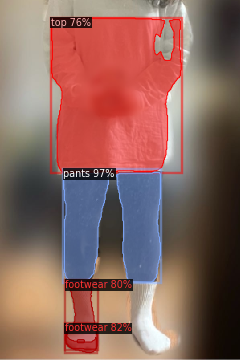

79 215 200 352
81 408 120 440
82 351 121 436
64 22 226 215
('1348061', '28923557', '2022.06.01', 'https://image.msscdn.net/data/estimate/1348061_0/gallery_629713c0213e2.jpg', '003', '003008', '1348061', 'https://image.msscdn.net/images/goods_img/20200312/1348061/1348061_2_500.jpg')


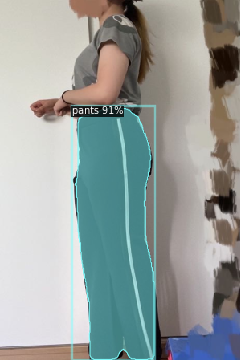

94 134 192 449
('2041103', '29235581', '2022.06.10', 'https://image.msscdn.net/data/estimate/2041103_0/gallery_62a35606114dd.jpg', '001', '001002', '2041103', 'https://image.msscdn.net/images/goods_img/20210727/2041103/2041103_5_500.jpg')


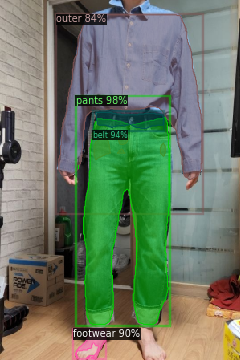

97 146 211 405
119 140 204 160
94 412 131 448
73 18 252 224
('2363964', '28977242', '2022.06.03', 'https://image.msscdn.net/data/estimate/2363964_0/gallery_6298ffa61eb11.jpg', '003', '003007', '2363964', 'https://image.msscdn.net/images/goods_img/20220216/2363964/2363964_1_500.jpg')


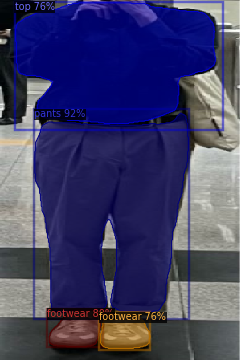

43 141 235 390
61 387 126 433
125 391 187 435
19 3 269 154
('2702399', '34564262', '2022.11.06', 'https://image.msscdn.net/data/estimate/2702399_0/gallery_63676641eef6e.jpg', '001', '001006', '2702399', 'https://image.msscdn.net/images/goods_img/20220807/2702399/2702399_1_500.jpg')


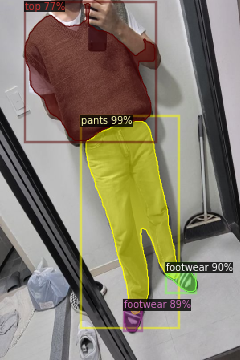

107 151 222 392
208 330 245 364
155 377 177 413
31 4 193 175
('843279', '8131685', '2020.02.03', 'https://image.msscdn.net/data/estimate/843279_0/gallery_5e36e965cb024.jpg', '001', '001006', '843279', 'https://image.msscdn.net/images/goods_img/20180830/843279/843279_2_500.jpg')


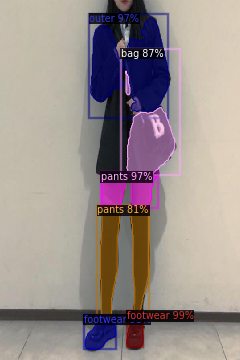

158 389 178 433
106 394 144 436
113 22 209 139
127 217 196 259
157 88 218 216
125 257 185 395
('1089897', '27667092', '2022.04.26', 'https://image.msscdn.net/data/estimate/1089897_0/gallery_62677c2d04fa6.jpg', '001', '001010', '1089897', 'https://image.msscdn.net/images/goods_img/20190704/1089897/1089897_5_500.jpg')


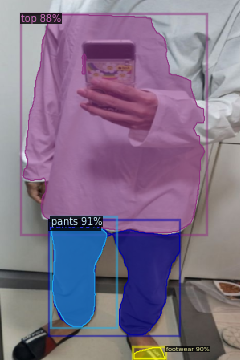

62 277 224 418
64 276 133 408
167 434 206 448
28 18 255 290
('2411586', '28728857', '2022.05.26', 'https://image.msscdn.net/data/estimate/2411586_0/gallery_628f4dc5c5143.jpg', '001', '001003', '2411586', 'https://image.msscdn.net/images/goods_img/20220311/2411586/2411586_1_500.jpg')


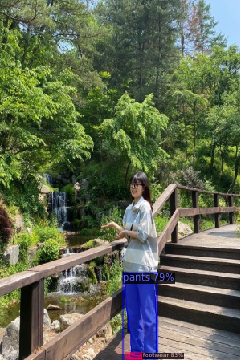

159 442 177 448
156 342 195 447
('2762297', '33969370', '2022.10.22', 'https://image.msscdn.net/data/estimate/2762297_0/gallery_6354014d101f9.jpg', '001', '001008', '2762297', 'https://image.msscdn.net/images/goods_img/20220901/2762297/2762297_6_500.jpg')


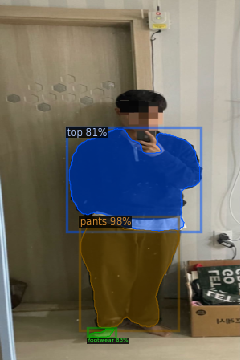

100 272 223 409
111 411 142 422
86 160 249 288
('1224094', '21568663', '2021.12.30', 'https://image.msscdn.net/data/estimate/1224094_0/gallery_6184924bac297.jpg', '003', '003008', '1224094', 'https://image.msscdn.net/images/goods_img/20191113/1224094/1224094_4_500.jpg')


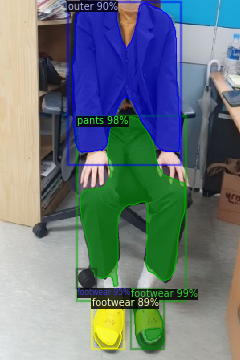

165 364 203 435
100 146 231 358
98 336 118 359
90 3 224 190
117 380 153 435
('1548480', '24150305', '2022.01.09', 'https://image.msscdn.net/data/estimate/1548480_0/gallery_61da566a10b26.jpg', '001', '001006', '1548480', 'https://image.msscdn.net/images/goods_img/20200813/1548480/1548480_3_500.jpg')


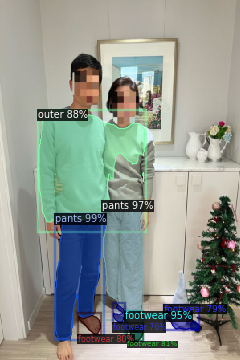

69 268 130 423
129 253 177 393
159 404 177 425
47 138 180 277
160 407 178 425
98 394 125 417
206 382 248 412
141 380 155 402
('1474586', '30256821', '2022.07.10', 'https://image.msscdn.net/data/estimate/1474586_0/gallery_62cabdcad2377.jpg', '003', '003004', '1474586', 'https://image.msscdn.net/images/goods_img/20200605/1474586/1474586_1_500.jpg')


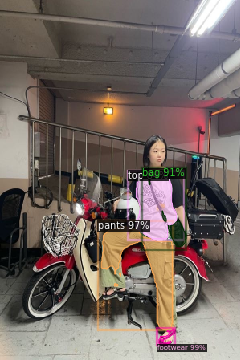

198 411 217 430
126 283 215 411
182 214 232 308
169 214 220 298
('2081336', '20561377', '2021.10.11', 'https://image.msscdn.net/data/estimate/2081336_0/gallery_61641f6577923.jpg', '003', '003004', '2081336', 'https://image.msscdn.net/images/goods_img/20210823/2081336/2081336_1_500.jpg')


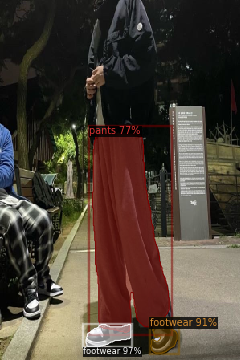

107 405 163 433
188 398 221 441
115 166 211 415
('2322559', '26682357', '2022.03.27', 'https://image.msscdn.net/data/estimate/2322559_0/gallery_6240387c305a3.jpg', '003', '003002', '2322559', 'https://image.msscdn.net/images/goods_img/20220124/2322559/2322559_1_500.jpg')


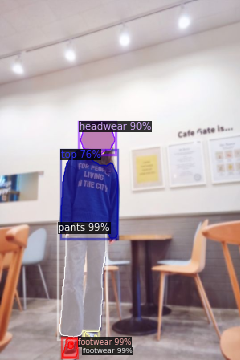

78 422 97 446
74 279 132 421
105 415 122 434
100 153 143 192
76 188 146 297
('2392463', '29845837', '2022.06.28', 'https://image.msscdn.net/data/estimate/2392463_0/gallery_62baf5b6c3d19.jpg', '003', '003009', '2392463', 'https://image.msscdn.net/images/goods_img/20220302/2392463/2392463_1_500.jpg')


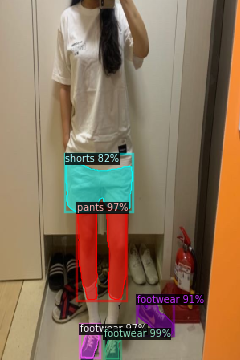

131 414 150 448
101 407 123 447
97 259 157 374
172 369 216 418
82 195 165 264
('532248', '12319635', '2020.10.17', 'https://image.msscdn.net/data/estimate/532248_0/gallery_5f89ea162f919.jpg', '001', '001010', '532248', 'https://image.msscdn.net/images/goods_img/20170331/532248/532248_3_500.jpg')


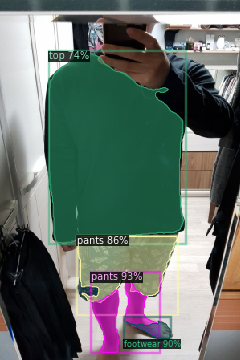

115 349 198 440
157 401 212 423
97 295 221 378
61 66 229 304
('1960628', '19822070', '2021.09.15', 'https://image.msscdn.net/data/estimate/1960628_0/gallery_6141feb33bd90.jpg', '003', '003008', '1960628', 'https://image.msscdn.net/images/goods_img/20210521/1960628/1960628_2_500.jpg')


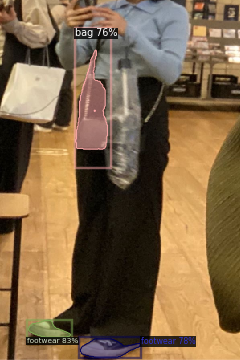

35 400 88 421
100 423 175 446
94 62 134 186
('1311947', '24876055', '2022.02.07', 'https://image.msscdn.net/data/estimate/1311947_0/gallery_61fcf8a32eb69.jpg', '001', '001003', '1311947', 'https://image.msscdn.net/images/goods_img/20200219/1311947/1311947_1_500.jpg')


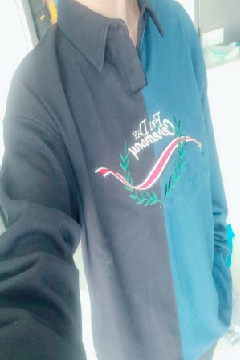

('2116358', '21316055', '2021.10.29', 'https://image.msscdn.net/data/estimate/2116358_0/gallery_617baacdece70.jpg', '005', '005011', '2116358', 'https://image.msscdn.net/images/goods_img/20210908/2116358/2116358_1_500.jpg')


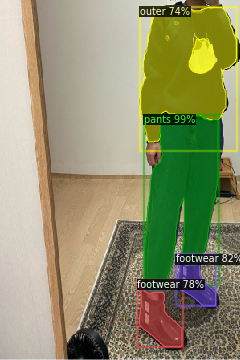

180 144 272 356
221 319 269 382
174 352 227 433
175 8 295 177
('2098372', '32950215', '2022.09.29', 'https://image.msscdn.net/data/estimate/2098372_0/gallery_63352d3348671.jpg', '003', '003008', '2098372', 'https://image.msscdn.net/images/goods_img/20210830/2098372/2098372_1_500.jpg')


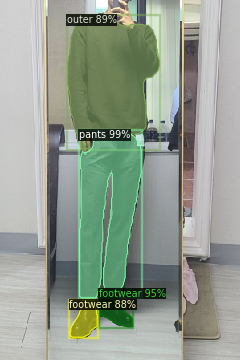

99 164 176 372
124 361 165 407
84 19 199 186
87 375 121 421
('1786750', '20085263', '2021.09.26', 'https://image.msscdn.net/data/estimate/1786750_0/gallery_61506a548edb1.jpg', '003', '003002', '1786750', 'https://image.msscdn.net/images/goods_img/20210209/1786750/1786750_1_500.jpg')


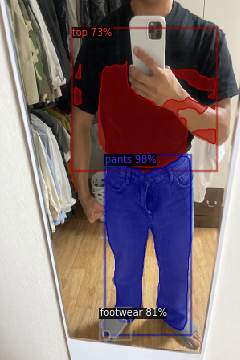

132 195 238 412
126 386 158 424
93 76 269 209
('1427120', '11973562', '2020.10.01', 'https://image.msscdn.net/data/estimate/1427120_0/gallery_5f74c88863242.jpg', '003', '003002', '1427120', 'https://image.msscdn.net/images/goods_img/20200429/1427120/1427120_1_500.jpg')


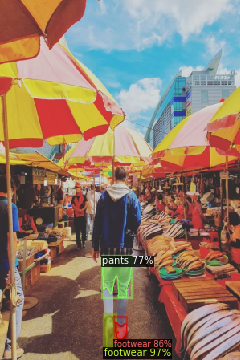

130 394 143 434
144 402 158 423
128 321 164 371
('1876392', '18240554', '2021.07.13', 'https://image.msscdn.net/data/estimate/1876392_0/gallery_60ed1c912ace4.jpg', '001', '001001', '1876392', 'https://image.msscdn.net/images/goods_img/20210401/1876392/1876392_2_500.jpg')


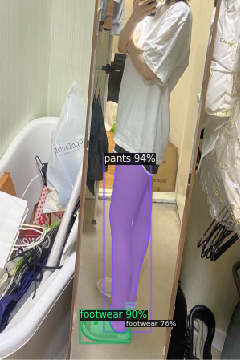

136 199 188 414
102 388 162 426
158 382 168 398
('2686394', '36031229', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2686394_0/gallery_6385bb223b451.jpg', '001', '001008', '2686394', 'https://image.msscdn.net/images/goods_img/20220728/2686394/2686394_1_500.jpg')


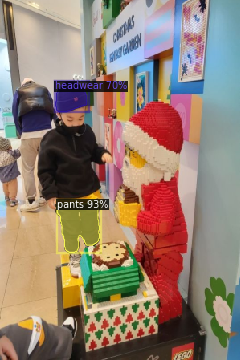

71 250 124 315
69 102 108 139
('2574823', '29221596', '2022.06.10', 'https://image.msscdn.net/data/estimate/2574823_0/gallery_62a2f5135eaaf.jpg', '003', '003009', '2574823', 'https://image.msscdn.net/images/goods_img/20220523/2574823/2574823_2_500.jpg')


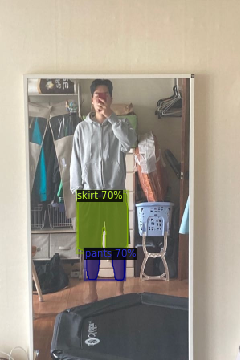

108 312 155 350
97 241 159 315
('1262089', '12759111', '2020.11.04', 'https://image.msscdn.net/data/estimate/1262089_0/gallery_5fa26cf8eaeed.jpg', '005', '005011', '1262089', 'https://image.msscdn.net/images/goods_img/20200103/1262089/1262089_3_500.jpg')


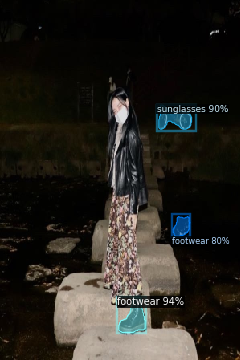

148 371 181 415
198 131 239 161
216 270 237 295
('2089209', '23140896', '2021.12.09', 'https://image.msscdn.net/data/estimate/2089209_0/gallery_61b19c067eb9f.jpg', '003', '003002', '2089209', 'https://image.msscdn.net/images/goods_img/20210826/2089209/2089209_4_500.jpg')


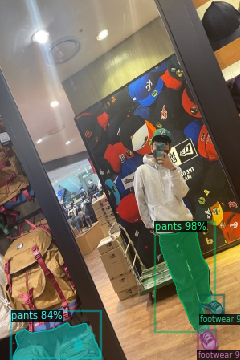

199 281 263 414
250 414 269 437
251 376 278 393
16 403 125 447
('743456', '21707217', '2021.11.09', 'https://image.msscdn.net/data/estimate/743456_0/gallery_6189db6480f20.jpg', '003', '003007', '743456', 'https://image.msscdn.net/images/goods_img/20180327/743456/743456_2_500.jpg')


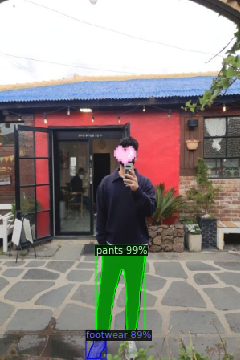

120 308 181 418
109 414 131 448
('2306361', '27127890', '2022.04.10', 'https://image.msscdn.net/data/estimate/2306361_0/gallery_6252aaae8d789.jpg', '003', '003008', '2306361', 'https://image.msscdn.net/images/goods_img/20220113/2306361/2306361_1_500.jpg')


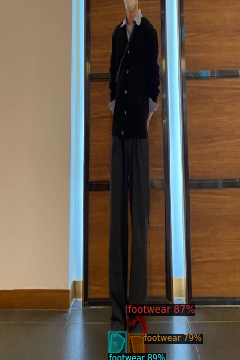

137 417 155 441
163 383 181 444
163 420 179 445
('2790997', '35158258', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2790997_0/gallery_637602c04ce8e.jpg', '001', '001008', '2790997', 'https://image.msscdn.net/images/goods_img/20220914/2790997/2790997_1_500.jpg')


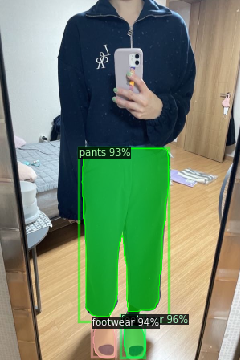

153 394 181 446
116 401 143 446
102 185 210 395
('1558045', '15955919', '2021.04.02', 'https://image.msscdn.net/data/estimate/1558045_0/gallery_6066d724e3d51.jpg', '003', '003010', '1558045', 'https://image.msscdn.net/images/goods_img/20200820/1558045/1558045_5_500.jpg')


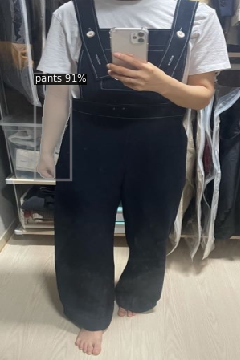

46 93 88 223
('2700190', '35008146', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2700190_0/gallery_637393bd63d18.jpg', '003', '003002', '2700190', 'https://image.msscdn.net/images/goods_img/20220805/2700190/2700190_1_500.jpg')


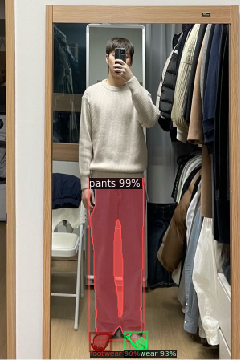

113 223 179 418
157 417 183 438
114 417 137 438
('2388152', '34596472', '2022.11.07', 'https://image.msscdn.net/data/estimate/2388152_0/gallery_636867527794e.jpg', '003', '003007', '2388152', 'https://image.msscdn.net/images/goods_img/20220228/2388152/2388152_1_500.jpg')


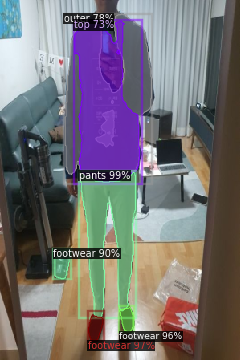

100 215 169 396
110 393 128 425
149 384 166 414
68 312 87 348
81 17 189 223
93 26 174 228
('2501146', '32845425', '2022.09.26', 'https://image.msscdn.net/data/estimate/2501146_0/gallery_63319f0ea5bdd.jpg', '003', '003006', '2501146', 'https://image.msscdn.net/images/goods_img/20220419/2501146/2501146_2_500.jpg')


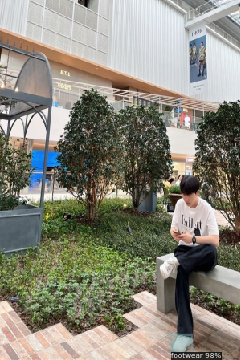

215 419 239 440
('1628946', '19955852', '2021.09.22', 'https://image.msscdn.net/data/estimate/1628946_0/gallery_614a9945b6bab.jpg', '001', '001006', '1628946', 'https://image.msscdn.net/images/goods_img/20200928/1628946/1628946_2_500.jpg')


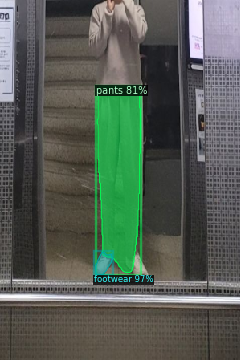

119 315 140 343
121 108 175 340
('1149329', '8073371', '2020.01.29', 'https://image.msscdn.net/data/estimate/1149329_0/gallery_5e318450a8abb.jpg', '003', '003008', '1149329', 'https://image.msscdn.net/images/goods_img/20190910/1149329/1149329_4_500.jpg')


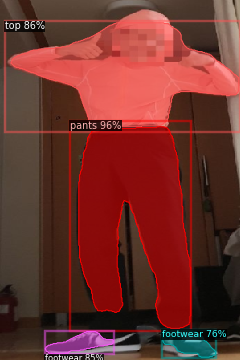

98 158 238 410
13 28 298 159
56 414 141 442
203 413 269 446
('1589973', '35230399', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/1589973_0/gallery_637721c94eabd.jpg', '001', '001005', '1589973', 'https://image.msscdn.net/images/goods_img/20200908/1589973/1589973_1_500.jpg')


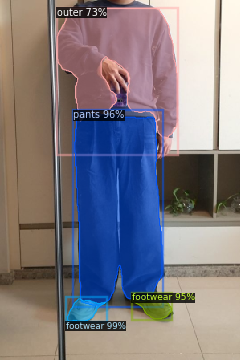

84 373 131 401
93 139 202 381
165 368 214 398
71 10 221 173
('1268881', '24876632', '2022.02.07', 'https://image.msscdn.net/data/estimate/1268881_0/gallery_62008f2384358.jpg', '001', '001006', '1268881', 'https://image.msscdn.net/images/goods_img/20200113/1268881/1268881_1_500.jpg')


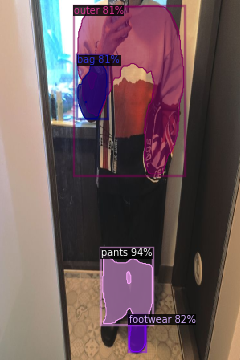

128 317 190 404
161 394 181 439
97 75 133 148
96 7 229 217
('499333', '2903252', '2018.10.22', 'https://image.msscdn.net/data/estimate/499333_0/gallery_5bcd18d2220c8.jpg', '005', '005015', '499333', 'https://image.msscdn.net/images/goods_img/20170314/499333/499333_2_500.jpg')


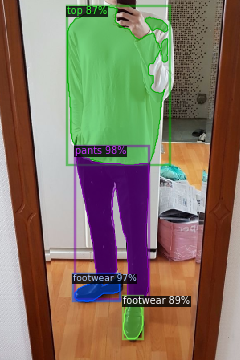

95 190 185 373
93 343 149 376
154 371 178 423
84 8 209 206
('1551896', '34329738', '2022.11.01', 'https://image.msscdn.net/data/estimate/1551896_0/gallery_635ffc80e7c25.jpg', '001', '001010', '1551896', 'https://image.msscdn.net/images/goods_img/20200818/1551896/1551896_3_500.jpg')


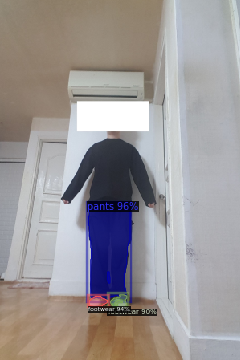

110 252 162 374
111 370 134 383
137 368 158 386
('2164659', '24938288', '2022.02.06', 'https://image.msscdn.net/data/estimate/2164659_0/gallery_61fea1315ab1b.jpg', '003', '003007', '2164659', 'https://image.msscdn.net/images/goods_img/20211006/2164659/2164659_2_500.jpg')


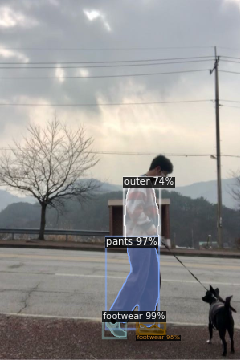

131 391 157 421
172 405 205 418
135 301 198 409
155 222 198 305
('2326763', '33966015', '2022.10.22', 'https://image.msscdn.net/data/estimate/2326763_0/gallery_6353ef54cfb1b.jpg', '003', '003007', '2326763', 'https://image.msscdn.net/images/goods_img/20220125/2326763/2326763_2_500.jpg')


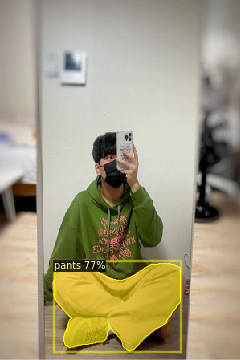

67 328 225 438
('2346672', '32773776', '2022.09.24', 'https://image.msscdn.net/data/estimate/2346672_0/gallery_632eec794597f.jpg', '003', '003002', '2346672', 'https://image.msscdn.net/images/goods_img/20220208/2346672/2346672_3_500.jpg')


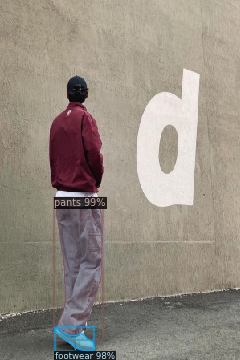

70 252 127 418
69 410 117 438
('2332832', '26814891', '2022.03.31', 'https://image.msscdn.net/data/estimate/2332832_0/gallery_6245999adfb70.jpg', '003', '003007', '2332832', 'https://image.msscdn.net/images/goods_img/20220127/2332832/2332832_1_500.jpg')


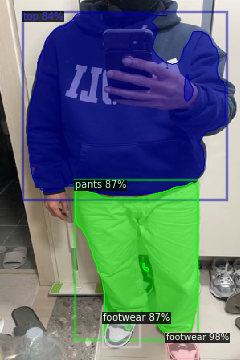

208 418 246 448
130 392 173 433
94 228 247 421
35 16 281 243
('1324000', '24696496', '2022.01.28', 'https://image.msscdn.net/data/estimate/1324000_0/gallery_61f345fb735b2.jpg', '001', '001005', '1324000', 'https://image.msscdn.net/images/goods_img/20200226/1324000/1324000_3_500.jpg')


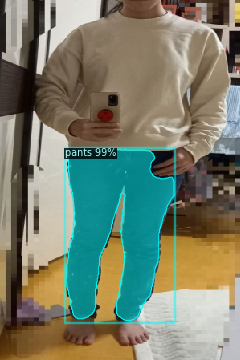

82 186 217 400
('1370756', '15613059', '2021.03.17', 'https://image.msscdn.net/data/estimate/1370756_0/gallery_6050ce8290f31.jpg', '001', '001005', '1370756', 'https://image.msscdn.net/images/goods_img/20200327/1370756/1370756_5_500.jpg')


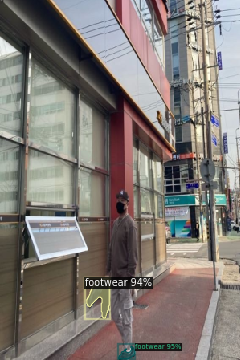

148 432 168 448
108 348 136 397
('2512970', '29711841', '2022.06.24', 'https://image.msscdn.net/data/estimate/2512970_0/gallery_62b56e9d2c9c8.jpg', '001', '001011', '2512970', 'https://image.msscdn.net/images/goods_img/20220425/2512970/2512970_2_500.jpg')


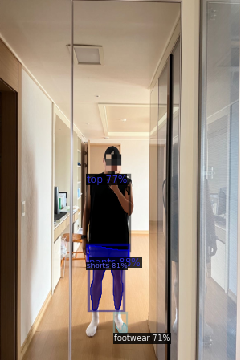

113 327 153 387
110 307 160 328
111 218 161 312
143 403 158 416
('1986543', '29511010', '2022.06.18', 'https://image.msscdn.net/data/estimate/1986543_0/gallery_62adb92b82a05.jpg', '003', '003006', '1986543', 'https://image.msscdn.net/images/goods_img/20210607/1986543/1986543_1_500.jpg')


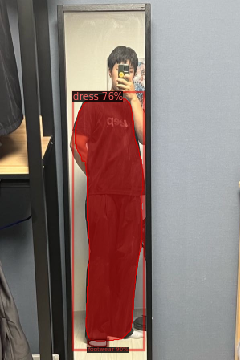

110 424 133 433
94 118 178 426
('2154595', '21041214', '2021.10.22', 'https://image.msscdn.net/data/estimate/2154595_0/gallery_6172aaa3ec0e5.jpg', '003', '003007', '2154595', 'https://image.msscdn.net/images/goods_img/20210930/2154595/2154595_1_500.jpg')


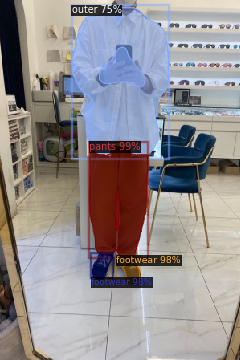

112 183 184 321
115 318 140 347
146 320 174 353
90 9 210 193
('2768387', '36456486', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2768387_0/gallery_638f501bdae2b.jpg', '005', '005006', '2768387', 'https://image.msscdn.net/images/goods_img/20220905/2768387/2768387_1_500.jpg')


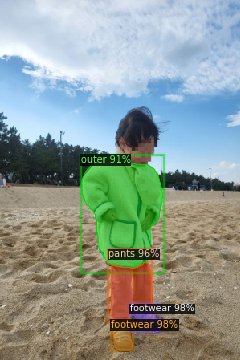

165 381 199 414
139 402 165 437
138 327 189 401
101 194 203 334
('2816816', '35966352', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2816816_0/gallery_63842c13693a0.jpg', '005', '005011', '2816816', 'https://image.msscdn.net/images/goods_img/20220923/2816816/2816816_2_500.jpg')


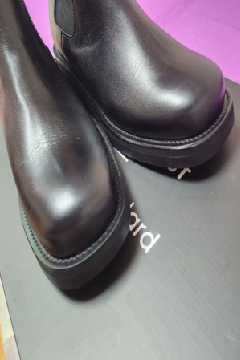

('896650', '3788831', '2019.01.29', 'https://image.msscdn.net/data/estimate/896650_0/gallery_5c4fec3c3f2d3.jpg', '003', '003007', '896650', 'https://image.msscdn.net/images/goods_img/20181101/896650/896650_9_500.jpg')


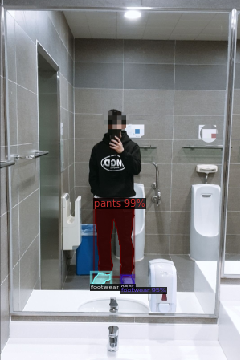

118 249 166 345
151 344 167 359
115 341 137 355
('1283635', '16529327', '2021.05.01', 'https://image.msscdn.net/data/estimate/1283635_0/gallery_608c3fe4be0cd.jpg', '003', '003006', '1283635', 'https://image.msscdn.net/images/goods_img/20200129/1283635/1283635_3_500.jpg')


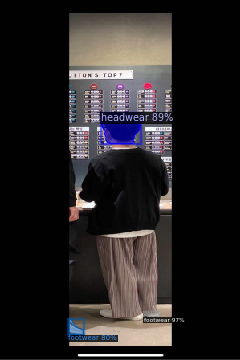

180 390 199 396
127 141 174 179
86 398 104 418
('2348242', '32608033', '2022.09.20', 'https://image.msscdn.net/data/estimate/2348242_0/gallery_63294b9e64953.jpg', '001', '001004', '2348242', 'https://image.msscdn.net/images/goods_img/20220209/2348242/2348242_1_500.jpg')


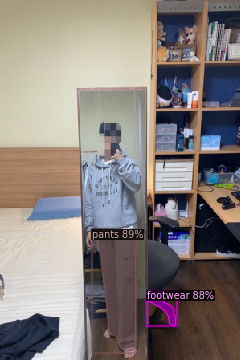

122 287 169 438
184 364 219 406
('2670398', '35881715', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2670398_0/gallery_638215c7aadb6.jpg', '001', '001008', '2670398', 'https://image.msscdn.net/images/goods_img/20220719/2670398/2670398_1_500.jpg')


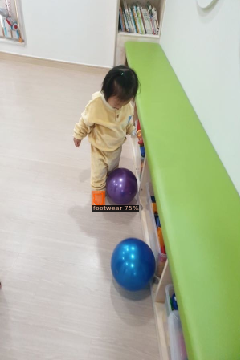

117 241 128 256
('337726', '10331806', '2020.10.18', 'https://image.msscdn.net/data/estimate/337726_0/gallery_5f8c423ab5e22.jpg', '003', '003009', '337726', 'https://image.msscdn.net/images/goods_img/20160415/337726/337726_2_500.jpg')


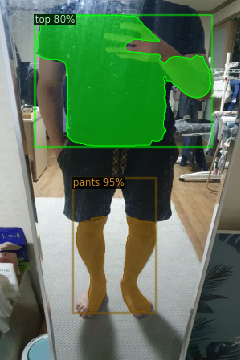

95 270 194 389
46 19 263 182
('2352002', '28685823', '2022.05.25', 'https://image.msscdn.net/data/estimate/2352002_0/gallery_628dddc4708e7.jpg', '001', '001001', '2352002', 'https://image.msscdn.net/images/goods_img/20220210/2352002/2352002_2_500.jpg')


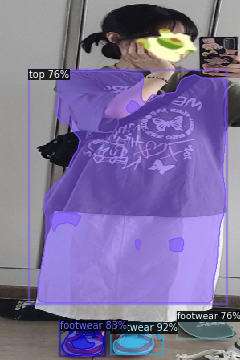

141 404 201 442
77 404 129 444
222 390 291 423
47 89 282 378
('2670973', '34738527', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2670973_0/gallery_636c8751b4189.jpg', '001', '001008', '2670973', 'https://image.msscdn.net/images/goods_img/20220719/2670973/2670973_1_500.jpg')


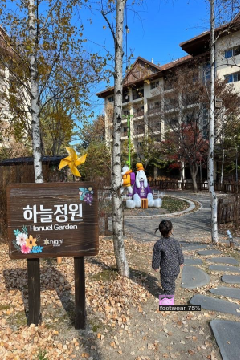

200 372 215 381
('2413584', '34513213', '2022.11.05', 'https://image.msscdn.net/data/estimate/2413584_0/gallery_6365cdbdad796.jpg', '003', '003006', '2413584', 'https://image.msscdn.net/images/goods_img/20220311/2413584/2413584_1_500.jpg')


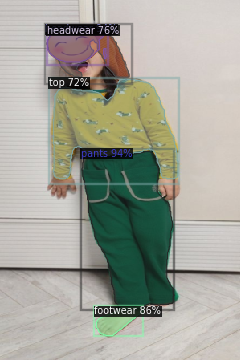

58 31 161 96
102 189 217 386
120 383 178 419
59 32 133 77
66 99 222 223
('2733455', '36280353', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2733455_0/gallery_638b521cd0efb.jpg', '001', '001006', '2733455', 'https://image.msscdn.net/images/goods_img/20220822/2733455/2733455_2_500.jpg')


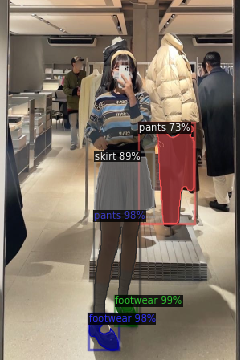

145 372 171 406
111 393 147 437
117 264 174 399
118 191 191 268
196 156 242 279
('1675525', '25574997', '2022.02.23', 'https://image.msscdn.net/data/estimate/1675525_0/gallery_6215fa8425ff3.jpg', '003', '003008', '1675525', 'https://image.msscdn.net/images/goods_img/20201103/1675525/1675525_3_500.jpg')


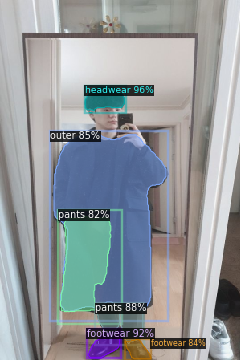

106 109 155 140
110 413 149 447
121 380 178 429
67 165 207 389
156 424 188 448
75 270 138 389
('1178390', '14929943', '2021.02.10', 'https://image.msscdn.net/data/estimate/1178390_0/gallery_6023c08ad32e1.jpg', '001', '001002', '1178390', 'https://image.msscdn.net/images/goods_img/20191007/1178390/1178390_2_500.jpg')


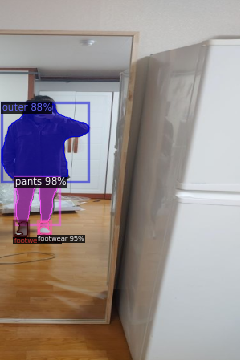

19 222 74 278
48 277 63 294
2 130 110 223
18 277 34 296
('1139099', '30199134', '2022.07.08', 'https://image.msscdn.net/data/estimate/1139099_0/gallery_62c81d497ceba.jpg', '001', '001006', '1139099', 'https://image.msscdn.net/images/goods_img/20190902/1139099/1139099_6_500.jpg')


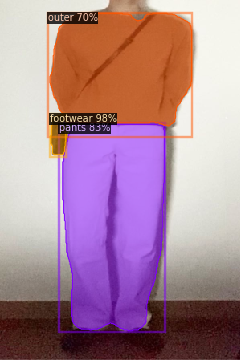

63 143 82 193
78 155 205 413
62 16 239 157
('1638610', '19149918', '2021.08.20', 'https://image.msscdn.net/data/estimate/1638610_0/gallery_611fb45de273f.jpg', '003', '003002', '1638610', 'https://image.msscdn.net/images/goods_img/20201007/1638610/1638610_1_500.jpg')


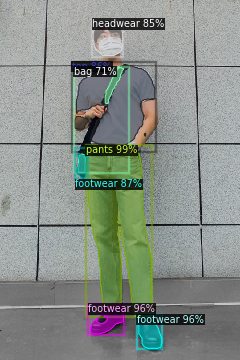

108 182 189 395
112 380 154 417
173 394 202 435
95 188 109 222
93 81 193 181
116 24 153 69
97 84 154 215
('1491644', '29030903', '2022.06.04', 'https://image.msscdn.net/data/estimate/1491644_0/gallery_629b23d7b67b0.jpg', '001', '001001', '1491644', 'https://image.msscdn.net/images/goods_img/20200619/1491644/1491644_2_500.jpg')


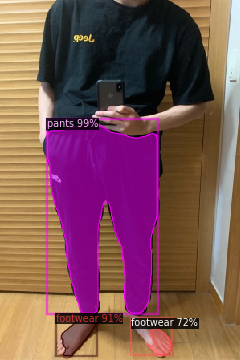

59 151 196 391
76 393 120 444
172 409 213 443
('2322559', '35517449', '며칠전으로 표시된 리뷰', 'https://image.msscdn.net/data/estimate/2322559_0/gallery_637c634744b0d.jpg', '003', '003002', '2322559', 'https://image.msscdn.net/images/goods_img/20220124/2322559/2322559_1_500.jpg')


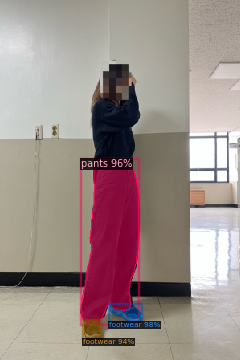

137 382 175 401
101 199 173 405
105 401 125 423
('1312044', '17252107', '2021.06.05', 'https://image.msscdn.net/data/estimate/1312044_0/gallery_60bae40a34edb.jpg', '003', '003008', '1312044', 'https://image.msscdn.net/images/goods_img/20200219/1312044/1312044_2_500.jpg')


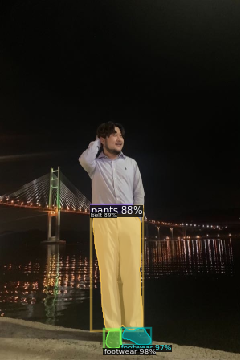

132 412 151 435
153 410 188 431
114 257 164 264
116 263 177 412
('565940', '6078113', '2019.09.05', 'https://image.msscdn.net/data/estimate/565940_0/gallery_5d6fe00e5a786.jpg', '001', '001002', '565940', 'https://image.msscdn.net/images/goods_img/20170529/565940/565940_1_500.jpg')


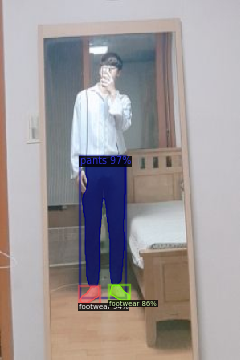

103 196 156 358
100 358 123 379
137 356 161 375
('2171624', '24612601', '2022.01.25', 'https://image.msscdn.net/data/estimate/2171624_0/gallery_61efdded9d21d.jpg', '003', '003006', '2171624', 'https://image.msscdn.net/images/goods_img/20211011/2171624/2171624_1_500.jpg')


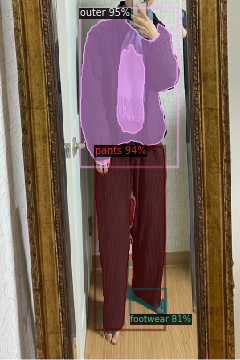

100 12 221 205
119 183 205 411
163 363 206 392
('1920528', '26889435', '2022.04.03', 'https://image.msscdn.net/data/estimate/1920528_0/gallery_6248af000691b.jpg', '003', '003004', '1920528', 'https://image.msscdn.net/images/goods_img/20210426/1920528/1920528_1_500.jpg')


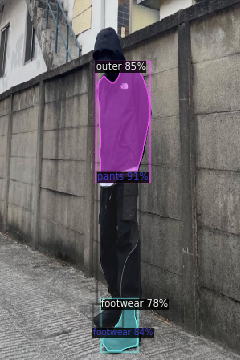

124 221 174 378
122 78 187 226
117 383 152 409
128 375 172 438
('1568050', '11891585', '2020.09.25', 'https://image.msscdn.net/data/estimate/1568050_0/gallery_5f6df1a7b5d6f.jpg', '005', '005011', '1568050', 'https://image.msscdn.net/images/goods_img/20200828/1568050/1568050_6_500.jpg')


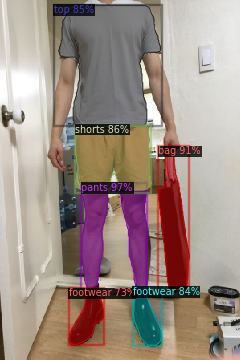

102 234 183 360
198 185 234 361
94 157 188 237
73 6 200 157
166 359 201 431
86 360 129 430
('2540758', '29012054', '2022.06.04', 'https://image.msscdn.net/data/estimate/2540758_0/gallery_629a6c76c371d.jpg', '001', '001001', '2540758', 'https://image.msscdn.net/images/goods_img/20220504/2540758/2540758_1_500.jpg')


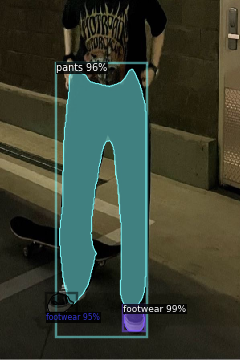

155 382 180 413
74 85 182 383
59 366 92 390
('2418549', '29607720', '2022.06.21', 'https://image.msscdn.net/data/estimate/2418549_0/gallery_62b1b6276650a.jpg', '003', '003002', '2418549', 'https://image.msscdn.net/images/goods_img/20220315/2418549/2418549_1_500.jpg')


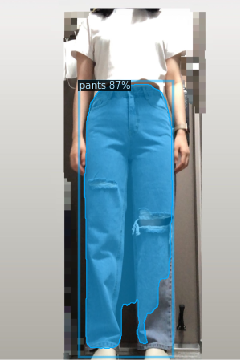

105 105 215 435
('1391961', '9770080', '2020.05.20', 'https://image.msscdn.net/data/estimate/1391961_0/gallery_5ec4ddeabbd8a.jpg', '003', '003009', '1391961', 'https://image.msscdn.net/images/goods_img/20200409/1391961/1391961_1_500.jpg')


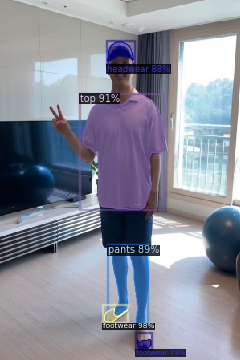

130 385 159 403
103 117 204 261
139 307 184 406
134 52 166 76
171 424 188 436


HTTPError: ignored

In [ ]:
## 위와 같은 코드 --> 변경용 실행 안하셔도 됩니다 

from skimage import io
import cv2


for j in test[:]:

  i_rev = io.imread(j[3])
  if len(i_rev.shape) > 2 and i_rev.shape[2] == 4:
    #slice off the alpha channel
    i_rev = i_rev[:, :, :3]
  i_rev = cv2.resize(i_rev, dsize=(300, 450), interpolation=cv2.INTER_AREA)
  
  
  out_rev = predictor(i_rev)

  v_rev = Visualizer(i_rev[:, :, ::-1],
                  metadata=moda_metadata, 
                  scale=0.8
                  
      )
  
  aa = print(j[:])
  v_rev = v_rev.draw_instance_predictions(out_rev["instances"].to("cpu"))

  a = cv2_imshow(v_rev.get_image()[:, :, ::])

  # # crop img
  from re import I
  from PIL import Image


  masks_rev = np.asarray(out_rev["instances"].pred_masks.to("cpu"))
 # print(masks_rev)
  for j in range(masks_rev.shape[0]): # 마스크 수만큼 돌아가나 보군군
 #   bbox_result_list= list()
    item_mask_rev = masks_rev[j]

    segmentation = np.where(item_mask_rev == True)
    x_min = np.min(segmentation[1])
    x_max = np.max(segmentation[1])
    y_min = np.min(segmentation[0])
    y_max = np.max(segmentation[0])
  #  bb = print(x_min, y_min,x_max, y_max)

  # for j in range(masks_sam.shape[0]): # 마스크 수만큼 돌아가나 보군군
  #   item_mask_sam = masks_sam[j]

  #   segmentation = np.where(item_mask_sam == True)
  #   x_min = np.min(segmentation[1])
  #   x_max = np.max(segmentation[1])
  #   y_min = np.min(segmentation[0])
  #   y_max = np.max(segmentation[0])
  #   print(x_min, y_min,x_max, y_max)

    cc = Image.fromarray(i_rev[y_min:y_max, x_min:x_max, :], mode='RGB')
  #  print(cropped)
    
 

   # mask_rev = Image.fromarray((item_mask_rev * 255).astype('float32'))


    # cropped_mask_sam = mask_sam.crop((x_min, y_min, x_max, y_max))
    # bg = np.full((450, 300, 3), 255, np.float32) # 흰색배경
    # # bg = np.zeros((450, 300, 3), np.float32) # 검정색 배경
    # background = Image.fromarray(bg, mode='RGB')
    # paste_position = (100,150)

    # new_fg_image = Image.new('RGB', background.size)
    # new_fg_image.paste(cropped, paste_position)

    # new_alpha_mask = Image.new("L", background.size, color = 0)
    # new_alpha_mask.paste(cropped_mask_sam, paste_position)

    # composite = Image.composite(new_fg_image, background, new_alpha_mask)


    # composite_array = np.array(composite)
    # nonzero_composite_array = np.nonzero(composite_array)
    # np_av = np.average(nonzero_composite_array)
    # print(np_av)
  

    # masks_sam, masks_rev 
    # masks_sam의 item_num이 해당 클래스인 것만 저장. cropped img 
    # masks_rev의 item_num, url, reviewId, -> 별도 DB 생성. 일단 딕셔너리나 리스트로 뽑아 두기.


    # cv2_imshow(np.array(composite))
    # item_num = out_sam['instances'].pred_classes[j].item()
    # if item_num == 4 or item_num == 5 or item_num == 8 or item_num == 9:
    #   cv2.imwrite(f"data/images_output/top/top{j}.png", np.array(composite))
    # elif item_num == 7 or item_num == 10:
    #   cv2.imwrite(f"data/images_output/bottom/bottom{j}.png", np.array(composite))
    # else:
    #   cv2.imwrite(f"data/images_output/others/others{j}.png", np.array(composite))

In [ ]:
## 아래 Feature Exractor용 setup

!python feature_extractor.py install

In [ ]:
## 혹시 코사인 similarity 쓸때 보려고 생성한 코드

from PIL import Image
from pathlib import Path
import numpy as np


from feature_extractor import FeatureExtractor

# vgg16.h5 못 받아올 때 아래 코드 2줄 활성화 후 실행
# import ssl
# ssl._create_default_https_context = ssl._create_unverified_context


if __name__ == "__main__":
    
    fe = FeatureExtractor()
        
    # top feature
    for img_path in sorted(Path("./static/img_top").glob("*.jpg")):
        print(img_path)
        
        # Extract a deep feature here
        feature = fe.extract(img=Image.open(img_path))
        
        feature_path = Path("./static/feature_top") / (img_path.stem + ".npy")
        print(feature_path)
        
        # Save the feature
        np.save(feature_path, feature)
        
    # bottom feature
    for img_path in sorted(Path("./static/img_bottom").glob("*.jpg")):
        print(img_path)
        
        # Extract a deep feature here
        feature = fe.extract(img=Image.open(img_path))
        
        feature_path = Path("./static/feature_bottom") / (img_path.stem + ".npy")
        print(feature_path)
        
        # Save the feature
        np.save(feature_path, feature)

553467096/553467096 [==============================] - 3s 0us/step


In [ ]:
from feature_extractor import FeatureExtractor
#import pymysql as pysql
import sqlite3
from pathlib import Path

import numpy as np
import pandas as pd


# Reading img features
def load_img_list():
    '''
    local에 저장된 .npy 디렉토리에서 특징들을 뽑아와 numpy array로,
    DB에 담긴 image path와 하이퍼링크를 가져와 dataframe 형태로 반환해주는 함수
    [return]
    features_top : numpy.array -> .npy에서 읽어온 top부분 특징
    features_bottom : numpy.array -> .npy에서 읽어온 bottom부분 특징
    result : numpy.array -> DB에서 읽어온 image path와 하이퍼링크 주소. dataframe 형태
    '''
    
    # 추출된 특징들을 pandas에 담아서 정리
    features_top = []
    features_bottom = []
    
    for feature_path in sorted(Path("./static/feature_top").glob("*.npy")):
        features_top.append(np.load(feature_path))
    features_top = np.array(features_top)

    for feature_path in sorted(Path("./static/feature_bottom").glob("*.npy")):
        features_bottom.append(np.load(feature_path))
    features_bottom = np.array(features_bottom)
    
    # DB에서 table 가져와서 pandas에 담기
    sql_top = "select * from imgs_top"
    sql_bottom = "select * from imgs_bottom"
    
    conn = pysql.connect(host="db-3team-project.ckirsmdzwudh.ap-northeast-2.rds.amazonaws.com",
                        port=3306,
                        user="admin",
                        password="rladbdbsDL!",
                        db="security",
                        charset="utf8")
    
    result_top = pd.read_sql_query(sql_top, conn)    
    result_bottom = pd.read_sql_query(sql_bottom, conn)    

    result_top['path_url'] = "https://image-storage01.s3.ap-northeast-2.amazonaws.com/" + result_top['name']
    result_bottom['path_url'] = "https://image-storage01.s3.ap-northeast-2.amazonaws.com/" + result_bottom['name']

    result_top = result_top.sort_values('name')
    result_bottom = result_bottom.sort_values('name')

    return features_top, features_bottom, result_top, result_bottom
    
load_img_list()

In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.models import Model
import numpy as np

class FeatureExtractor:
    def __init__(self):
        base_model = VGG16(weights="imagenet")
        self.model = Model(inputs=base_model.input, outputs=base_model.get_layer("fc1").output)
        

    def extract(self, img):
        img = img.resize((224, 224)).convert("RGB")
        x = image.img_to_array(img) # To np.array
        x = np.expand_dims(x, axis=0)   # (H, W, C) -> (1, H, W, C)
        x = preprocess_input(x) # Subtract avg pixel value
        feature = self.model.predict(x)[0]  # (1, 4096) -> (4096, )
        return feature / np.linalg.norm(feature)
        

In [ ]:
## 쓸못없는 코드

import numpy as np
from PIL import Image
from feature_extractor import FeatureExtractor
from datetime import datetime
from flask import Flask, request, render_template
from flask_cors import CORS
from flask_restful import Api
import flask
import base64
import cv2
from data_list import load_img_list
from img_crawling import naver_crawling
import schedule
import time
import running
import json

### 원본 코드 ###
# app = Flask(__name__)

# # Reading img features
# fe = FeatureExtractor()
# features = []
# img_paths = []

# for feature_path in Path("./static/feature").glob("*.npy"):
#     features.append(np.load(feature_path))
#     img_paths.append(Path("./static/img") / (feature_path.stem + ".jpg"))
# features = np.array(features)

# @app.route("/", methods=["GET", "POST"])
# def index():
#     if request.method == "POST":
#         file = request.files["query_img"]
        
#         # Save query img
#         img = Image.open(file.stream) # PIL image
#         uploaded_img_path = "static/uploaded/" + datetime.now().isoformat().replace(":", ".") + "_" + file.filename
#         img.save(uploaded_img_path)
        
#         # Run Search
#         query = fe.extract(img)
#         dists = np.linalg.norm(features - query, axis=1) # L2 distance to the features
#         ids = np.argsort(dists)[:30]    # Top 30 results
#         scores = [(dists[id], img_paths[id]) for id in ids]
        
#         print(scores)
        
#         return render_template("index.html", query_path=uploaded_img_path, scores=scores)
#     else:
#         return render_template("index.html")

# if __name__=="__main__":
#     app.run()
     
### 여기까지 ###




app = Flask(__name__)
CORS(app, supports_credentials=True) # 다른 포트번호에 대한 보안 제거
api = Api(app)

# Reading img features
fe = FeatureExtractor()

features_top, features_bottom, df_top, df_bottom = load_img_list()

@app.route("/upload", methods=["POST"])
def upload():
    if request.method == "POST":
        file = request.get_json()["file"].split(",")[1]
        
        decoded_file = base64.b64decode(file)
        
        img_np = np.fromstring(decoded_file, dtype=np.uint8)
        
        img = cv2.imdecode(img_np, flags=cv2.IMREAD_COLOR)
        
        # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        # img = Image.fromarray(img.astype('uint8'))
        
        # img.show() 
        
        # image_parsing {"outer" : [np.array, ...], "shortsleeve" : [np.array, ...], }
        array_top, array_bottom = running.cloth_seg(img)
        dict_top = {}
        dict_bottom = {}
        
        if array_top:
            for key in array_top.keys():
                img_top = Image.fromarray(array_top.get(key).astype('uint8'))
                
                # Run Search
                query_top = fe.extract(img_top)
                dists_top = np.linalg.norm(features_top - query_top, axis=1)
                ids_top = np.argsort(dists_top)[:100] # top result sort
                
                result_img_path_top = [df_top.iloc[id]['path_url'] for id in ids_top]
                result_img_link_top = [df_top.iloc[id]['url'] for id in ids_top]
                result_img_score_top = [float(dists_top[id]) for id in ids_top] # float32 타입으로 되어 있는 것을 float 타입으로 바꿔주어야지 json으로 변경 가능. 리스트에 있어도 마찬가지
                
                dict_top[key] = {"result_img_path_top" : result_img_path_top,
                                "result_img_link_top" : result_img_link_top,
                                "result_img_score_top" : result_img_score_top}
        
            
        if array_bottom:
            for key in array_bottom.keys():
                img_bottom = Image.fromarray(array_bottom.get(key).astype('uint8'))
            
                # Run Search
                query_bottom = fe.extract(img_bottom)
                dists_bottom = np.linalg.norm(features_bottom - query_bottom, axis=1)
                ids_bottom = np.argsort(dists_bottom)[:100] # top result sort
                
                result_img_path_bottom = [df_bottom.iloc[id]['path_url'] for id in ids_bottom]
                result_img_link_bottom = [df_bottom.iloc[id]['url'] for id in ids_bottom]
                result_img_score_bottom = [float(dists_bottom[id]) for id in ids_bottom] # float32 타입으로 되어 있는 것을 float 타입으로 바꿔주어야지 json으로 변경 가능. 리스트에 있어도 마찬가지
                
                dict_bottom[key] = {"result_img_path_bottom" : result_img_path_bottom,
                                                "result_img_link_bottom" : result_img_link_bottom,
                                                "result_img_score_bottom" : result_img_score_bottom}
        
        
        return flask.jsonify({"result" : "true",
                              "number_of_top_category" : str(len(array_top)),
                              "top" : dict_top,
                              "number_of_bottom_category" : str(len(array_bottom)),
                              "bottom" : dict_bottom})
    else:
        return flask.jsonify({"result" : "false"})
    

if __name__=="__main__":
    # app.run(host=0.0.0.0, port=5000) 모든 호스트로 접속 가능.
    app.run()
    
    # # 크롤링 자동화
    # schedule.every().wednesday.at("15:06").do(naver_crawling)
    # while True:
    #     schedule.run_pending()
    #     time.sleep(1)

In [ ]:
import os